# Evaluate different CNN models over MPI and Era

This notebook evaluates different CNN autoencoder models on things like 1) monthly averages and 2) climate. The selected model tries to bias correct Mpi to Era and Era to MPI.

### TOC
 [1. Model Select](#ms)<br>
 [2. Load data](#ld)




In [1]:
from IPython import display

import numpy as np
import torch
from torch import nn
from torch.optim import Adam
from torch.autograd import Variable

import cv2
#from skimage.metrics import structural_similarity as ssim
import copy


In [2]:
# load netcdf files directly via xarray
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy


In [3]:
# define internal pic res
ires = 128
res = 128
nvars = 16
mnvars = 16


In [4]:
 mnvars

16

<a id='ms'></a>
## Models: run one from below:


In [20]:
import torch.nn.functional as F

In [5]:
# MODEL: 16f model (16 filter bottleneck)
class GenerativeNet(torch.nn.Module):

    def __init__(self):
        super(GenerativeNet, self).__init__()

        #self.linear = torch.nn.Linear(20*20*1*1, 20*20*1*1)

#         self.conv1 = nn.Sequential(
#             nn.BatchNorm2d(nvars),
#             nn.Conv2d(
#                 in_channels=nvars, out_channels=64, kernel_size=4, 
#                 stride=2, padding=1, bias=True
#             ),
#             nn.BatchNorm2d(64),
#             nn.LeakyReLU(0.2, inplace=True)
#         )

        self.conv11 = nn.Sequential(
            #nn.BatchNorm2d(mnvars),
            nn.Conv2d(
                in_channels=mnvars, out_channels=128, kernel_size=4,
                stride=2, padding=1, bias=False
            ),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.conv22 = nn.Sequential(
            #nn.BatchNorm2d(128),
            nn.Conv2d(
                in_channels=128, out_channels=256, kernel_size=4,
                stride=2, padding=1, bias=False
            ),
            nn.LeakyReLU(0.2, inplace=True)
        )

        self.conv33 = nn.Sequential(
            #nn.BatchNorm2d(256),
            nn.Conv2d(
                in_channels=256, out_channels=512, kernel_size=4,
                stride=2, padding=1, bias=False
            ),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.conv44 = nn.Sequential(
            #nn.BatchNorm2d(512),
            nn.Conv2d(
                in_channels=512, out_channels=1024, kernel_size=4,
                stride=2, padding=1, bias=False
            ),
            nn.LeakyReLU(0.2, inplace=True)
        )


        self.conv55 = nn.Sequential(
            #nn.BatchNorm2d(1024),
            nn.Conv2d(
                in_channels=1024, out_channels=16, kernel_size=4,
                stride=2, padding=1, bias=False
            ),
            #nn.LeakyReLU(0.2, inplace=True)
            nn.Sigmoid() # constrain output to 0-1
        )

    def forward(self, x):
        # Project and reshape
        #x = self.linear(x)
        #x1 = x.view(x.shape[0], mnvars, ires, ires)

        #m = nn.Dropout(p=0.1)
        #x1 = m(x1)

        # Convolutional layers
        #print(x.shape)
        x = self.conv11(x)
        #print(x.shape)
        x = self.conv22(x)
        x = self.conv33(x)
        x = self.conv44(x)
        x = self.conv55(x)

        return x

    def forward2(self, x):
        #m = nn.Dropout(p=0.75)
        #x = m(x)

        # Convolutional layers
        x = F.conv_transpose2d(x, weight=self.conv55[0].weight.transpose(2,3), bias=None, stride=2,padding=1)
        x = F.leaky_relu(x, negative_slope=0.2, inplace=True)

        # x = self.conv2(x)
        x = F.conv_transpose2d(x, weight=self.conv44[0].weight.transpose(2,3), bias=None, stride=2,padding=1)
        x = F.leaky_relu(x, negative_slope=0.2, inplace=True)

        # x = self.conv3(x)
        x = F.conv_transpose2d(x, weight=self.conv33[0].weight.transpose(2,3), bias=None, stride=2,padding=1)
        x = F.leaky_relu(x, negative_slope=0.2, inplace=True)

        # x = self.conv4(x)
        x = F.conv_transpose2d(x, weight=self.conv22[0].weight.transpose(2,3), bias=None, stride=2,padding=1)
        x = F.leaky_relu(x, negative_slope=0.2, inplace=True)

        # x = self.conv5(x)
        x = F.conv_transpose2d(x, weight=self.conv11[0].weight.transpose(2,3), bias=None, stride=2,padding=1)
        x = F.sigmoid(x)


        return x

# load autoencoder
general_encoder = GenerativeNet()
#era2mpi_decoder = GenerativeNet()

# general encoder
gstate = torch.load("/glade/scratch/dkorytin/saved_models/tiedweights128x16f-eraandmpi-with-doy-cuda_generator-e300", map_location=torch.device('cpu'))
general_encoder.load_state_dict(gstate['generator'])
general_encoder.eval()
minmaxi_era = np.array(gstate['minmaxi_era'])

# # decoders
# gstate = torch.load("//glade/scratch/dkorytin/saved_models/tiedweights128x16f-eraandmpi-decoders-with-doy-cuda_generator-e950a", map_location=torch.device('cpu'))
# era2mpi_decoder.load_state_dict(gstate['generator'])
# era2mpi_decoder.eval()
# minmaxi_era = np.array(gstate['minmaxi_era'])
# minmaxi_mpi = np.array(gstate['minmaxi_mpi'])

minmaxi_mpi = minmaxi_era    # same normalization scale


In [106]:
# MODEL: 2048f
class GenerativeNet(torch.nn.Module):

    def __init__(self):
        super(GenerativeNet, self).__init__()

        self.conv11 = nn.Sequential(
            #nn.BatchNorm2d(mnvars),
            nn.Conv2d(
                in_channels=mnvars, out_channels=128, kernel_size=4,
                stride=2, padding=1, bias=False
            ),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.conv22 = nn.Sequential(
            #nn.BatchNorm2d(128),
            nn.Conv2d(
                in_channels=128, out_channels=256, kernel_size=4,
                stride=2, padding=1, bias=False
            ),
            nn.LeakyReLU(0.2, inplace=True)
        )

        self.conv33 = nn.Sequential(
            #nn.BatchNorm2d(256),
            nn.Conv2d(
                in_channels=256, out_channels=512, kernel_size=4,
                stride=2, padding=1, bias=False
            ),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.conv44 = nn.Sequential(
            #nn.BatchNorm2d(512),
            nn.Conv2d(
                in_channels=512, out_channels=1024, kernel_size=4,
                stride=2, padding=1, bias=False
            ),
            nn.LeakyReLU(0.2, inplace=True)
        )


        self.conv55 = nn.Sequential(
            #nn.BatchNorm2d(1024),
            nn.Conv2d(
                in_channels=1024, out_channels=2048, kernel_size=4,
                stride=2, padding=1, bias=False
            ),
            #nn.LeakyReLU(0.2, inplace=True)
            nn.Sigmoid() # constrain output to 0-1
        )

    def forward(self, x):
        # Project and reshape
        #x = self.linear(x)
        #x1 = x.view(x.shape[0], mnvars, ires, ires)

        #m = nn.Dropout(p=0.1)
        #x1 = m(x1)

        # Convolutional layers
        #print(x.shape)
        x = self.conv11(x)
        #print(x.shape)
        x = self.conv22(x)
        x = self.conv33(x)
        x = self.conv44(x)
        x = self.conv55(x)

        return x

    def forward2(self, x):
        #m = nn.Dropout(p=0.75)
        #x = m(x)

        # Convolutional layers
        x = F.conv_transpose2d(x, weight=self.conv55[0].weight.transpose(2,3), bias=None, stride=2,padding=1)
        x = F.leaky_relu(x, negative_slope=0.2, inplace=True)

        # x = self.conv2(x)
        x = F.conv_transpose2d(x, weight=self.conv44[0].weight.transpose(2,3), bias=None, stride=2,padding=1)
        x = F.leaky_relu(x, negative_slope=0.2, inplace=True)

        # x = self.conv3(x)
        x = F.conv_transpose2d(x, weight=self.conv33[0].weight.transpose(2,3), bias=None, stride=2,padding=1)
        x = F.leaky_relu(x, negative_slope=0.2, inplace=True)

        # x = self.conv4(x)
        x = F.conv_transpose2d(x, weight=self.conv22[0].weight.transpose(2,3), bias=None, stride=2,padding=1)
        x = F.leaky_relu(x, negative_slope=0.2, inplace=True)

        # x = self.conv5(x)
        x = F.conv_transpose2d(x, weight=self.conv11[0].weight.transpose(2,3), bias=None, stride=2,padding=1)
        x = F.sigmoid(x)


        return x
    
# load autoencoder
general_encoder = GenerativeNet()
xfer_decoder = GenerativeNet()

# general encoder
gstate = torch.load("/glade/scratch/dkorytin/saved_models/tiedweights128-eraandmpi-with-doy-cuda_generator-e1550b", map_location=torch.device('cpu'))
general_encoder.load_state_dict(gstate['generator'])
general_encoder.eval()
minmaxi_era = np.array(gstate['minmaxi_era'])

# decoders
gstate = torch.load("//glade/scratch/dkorytin/saved_models/tiedweights128-eraandmpi-decoders-with-doy-cuda_generator-e50b", map_location=torch.device('cpu'))
xfer_decoder.load_state_dict(gstate['generator'])
xfer_decoder.eval()
# minmaxi_era = np.array(gstate['minmaxi_era'])
# minmaxi_mpi = np.array(gstate['minmaxi_mpi'])

minmaxi_mpi = minmaxi_era    # same normalization scale

In [123]:
# MODEL: vgg16
import torch.nn as nn
import torch.utils.model_zoo as model_zoo
import math


__all__ = [
    'VGG', 'vgg11', 'vgg11_bn', 'vgg13', 'vgg13_bn', 'vgg16', 'vgg16_bn',
    'vgg19_bn', 'vgg19',
]


model_urls = {
    'vgg11': 'https://download.pytorch.org/models/vgg11-bbd30ac9.pth',
    'vgg13': 'https://download.pytorch.org/models/vgg13-c768596a.pth',
    'vgg16': 'https://download.pytorch.org/models/vgg16-397923af.pth',
    'vgg19': 'https://download.pytorch.org/models/vgg19-dcbb9e9d.pth',
    'vgg11_bn': 'https://download.pytorch.org/models/vgg11_bn-6002323d.pth',
    'vgg13_bn': 'https://download.pytorch.org/models/vgg13_bn-abd245e5.pth',
    'vgg16_bn': 'https://download.pytorch.org/models/vgg16_bn-6c64b313.pth',
    'vgg19_bn': 'https://download.pytorch.org/models/vgg19_bn-c79401a0.pth',
}


class VGG(nn.Module):

    def __init__(self, features, num_classes=1000):
        super(VGG, self).__init__()
        self.features = features
        self.classifier = nn.Sequential(
            nn.Linear(512 * 7 * 7, 4096),
            nn.ReLU(True),
            nn.Dropout(),
            nn.Linear(4096, 4096),
            nn.ReLU(True),
            nn.Dropout(),
            nn.Linear(4096, num_classes),
        )
        self._initialize_weights()

    def forward(self, x):
        x = self.features(x)
        x = x.view(x.size(0), -1)
        x = self.classifier(x)
        return x

    def _initialize_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                n = m.kernel_size[0] * m.kernel_size[1] * m.out_channels
                m.weight.data.normal_(0, math.sqrt(2. / n))
                if m.bias is not None:
                    m.bias.data.zero_()
            elif isinstance(m, nn.BatchNorm2d):
                m.weight.data.fill_(1)
                m.bias.data.zero_()
            elif isinstance(m, nn.Linear):
                m.weight.data.normal_(0, 0.01)
                m.bias.data.zero_()


def make_layers(cfg, batch_norm=False):
    layers = []
    in_channels = 3
    for v in cfg:
        if v == 'M':
            layers += [nn.MaxPool2d(kernel_size=2, stride=2)]
        else:
            conv2d = nn.Conv2d(in_channels, v, kernel_size=3, padding=1)
            if batch_norm:
                layers += [conv2d, nn.BatchNorm2d(v), nn.ReLU(inplace=True)]
            else:
                layers += [conv2d, nn.ReLU(inplace=True)]
            in_channels = v
    return nn.Sequential(*layers)


cfg = {
    'A': [64, 'M', 128, 'M', 256, 256, 'M', 512, 512, 'M', 512, 512, 'M'],
    'B': [64, 64, 'M', 128, 128, 'M', 256, 256, 'M', 512, 512, 'M', 512, 512, 'M'],
    'D': [64, 64, 'M', 128, 128, 'M', 256, 256, 256, 'M', 512, 512, 512, 'M', 512, 512, 512, 'M'],
    'E': [64, 64, 'M', 128, 128, 'M', 256, 256, 256, 256, 'M', 512, 512, 512, 512, 'M', 512, 512, 512, 512, 'M'],
}

def vgg16(pretrained=False, **kwargs):
    """VGG 16-layer model (configuration "D")

    Args:
        pretrained (bool): If True, returns a model pre-trained on ImageNet
    """
    model = VGG(make_layers(cfg['D']), **kwargs)
    if pretrained:
        model.load_state_dict(model_zoo.load_url(model_urls['vgg16']))
    return model



class GenerativeNet2(torch.nn.Module):
    def __init__(self):
        super(GenerativeNet2, self).__init__()

        self.linear = nn.Sequential(
          nn.Linear(1000, 2048*4*4),
          nn.LeakyReLU(0.2, inplace=True)
        )

        self.conv1 = nn.Sequential(
            nn.BatchNorm2d(2048),
            nn.ConvTranspose2d(
                in_channels=2048, out_channels=1024, kernel_size=4,
                stride=2, padding=1, bias=True
            ),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.conv2 = nn.Sequential(
            nn.BatchNorm2d(1024),
            nn.ConvTranspose2d(
                in_channels=1024, out_channels=512, kernel_size=4,
                stride=2, padding=1, bias=True
            ),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.conv3 = nn.Sequential(
            nn.BatchNorm2d(512),
            nn.ConvTranspose2d(
                in_channels=512, out_channels=256, kernel_size=4,
                stride=2, padding=1, bias=True
            ),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.conv4 = nn.Sequential(
            nn.BatchNorm2d(256),
            nn.ConvTranspose2d(
                in_channels=256, out_channels=128, kernel_size=4,
                stride=2, padding=1, bias=True
            ),
            nn.LeakyReLU(0.2, inplace=True)
        )


        self.conv5 = nn.Sequential(
            nn.BatchNorm2d(128),
            nn.ConvTranspose2d(
                in_channels=128, out_channels=mnvars, kernel_size=4,
                stride=2, padding=1, bias=True
            ),
            #nn.BatchNorm2d(512),
            #nn.LeakyReLU(0.2, inplace=True)
            nn.Sigmoid() # constrain output to 0-1 b/c SSIM does not like them
        )
        
    def forward(self, x):

        #m = nn.Dropout(p=0.75)
        #x = m(x)

        # Convolutional layers
        #print(x.shape)
        x = self.linear(x)
        x = x.view(-1, 2048,4,4)
        x = self.conv1(x)
        #print(x.shape)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        x = self.conv5(x)

        ## Flatten and apply sigmoid
        #x = x.view(-1, 2048*4*4)
        #x = self.out(x)
        return x

# Create Network instances 
#import torchvision.models as models
general_encoder = vgg16()
general_encoder.features[0] = nn.ConvTranspose2d(16, 64, 14, 2, 0)
# for param in general_encoder.parameters():
#     param.requires_grad = True
#generator.apply(init_weights)

vgg_decoder = GenerativeNet2()

# general encoder
gstate = torch.load("/glade/scratch/dkorytin/saved_models/vgg16-eraandmpi-with-doy-cuda_generator-e300", map_location=torch.device('cpu'))
general_encoder.load_state_dict(gstate['generator'])
general_encoder.eval()
#inmaxi_era = np.array(gstate['minmaxi_era'])

# vgg16 decoder
vgg_decoder.load_state_dict(gstate['generator2'])
vgg_decoder.eval()



GenerativeNet2(
  (linear): Sequential(
    (0): Linear(in_features=1000, out_features=32768, bias=True)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (conv1): Sequential(
    (0): BatchNorm2d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (1): ConvTranspose2d(2048, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (conv2): Sequential(
    (0): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (1): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (conv3): Sequential(
    (0): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (1): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (conv4): Sequential(
    (0): BatchNorm2d(256, eps=1e-05, momen

In [124]:
general_encoder

VGG(
  (features): Sequential(
    (0): ConvTranspose2d(16, 64, kernel_size=(14, 14), stride=(2, 2))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ce

<a id='ld'></a>
# Load data

In [10]:
###################################
## LOAD MPI UATM + Surface: hist ##
###################################
def load_mpi_hist():
    global samples,mdv1,mdv2,mdv3,mdv4,mdv5,mdv6,mdv7,mdv8,mdv9,mdv10,mdv11,mdv12,mdv13,mdv14,mdv15,mdv16,mnvars
    
    mnvars = 16
        
    ########### LOAd MPI ############
    mstart = 0

    mndays = 20454       # 1950-2005

    #ncks -O -d lat,23.375,55.125 -d lon,-112.375,-80.625 $f $of
    #ncatted -a missing_value,$v,o,f,0.0 -a _FillValue,$v,o,f,0.0 $of
    d='/glade/p/ral/risc/rmccrary/CMIP5_CORDEX/NAmerica/MPI-ESM-LR/native/historical/'

    tslice = slice('1979-01-01T00:00:00', '2006-01-01T00:00:00')
    tslice2 = slice('1979-01-01T00:00:00', '1979-01-02T00:00:00')
    
    mdv1 = xr.open_dataset(d+'U_MPI-ESM-LR_historical_r1i1p1_NAmerica_p850_19500101-20051231_dayavg_mpigrid.nc')['U'].sel(time=tslice, lat=slice(23.375,55), lon=slice(-112.375,-81))
    mdv2 = xr.open_dataset(d+'V_MPI-ESM-LR_historical_r1i1p1_NAmerica_p850_19500101-20051231_dayavg_mpigrid.nc')['V'].sel(time=tslice, lat=slice(23.375,55), lon=slice(-112.375,-81))
    mdv3 = xr.open_dataset(d+'Q_MPI-ESM-LR_historical_r1i1p1_NAmerica_p850_19500101-20051231_dayavg_mpigrid.nc')['Q'].sel(time=tslice, lat=slice(23.375,55), lon=slice(-112.375,-81))
    mdv4 = xr.open_dataset(d+'T_MPI-ESM-LR_historical_r1i1p1_NAmerica_p700_19500101-20051231_dayavg_mpigrid.nc')['T'].sel(time=tslice, lat=slice(23.375,55), lon=slice(-112.375,-81))
    mdv5 = xr.open_dataset(d+'Z_MPI-ESM-LR_historical_r1i1p1_NAmerica_p700_19500101-20051231_dayavg_mpigrid.nc')['Z'].sel(time=tslice, lat=slice(23.375,55), lon=slice(-112.375,-81))
    mdv6 = xr.open_dataset(d+'Z_MPI-ESM-LR_historical_r1i1p1_NAmerica_p500_19500101-20051231_dayavg_mpigrid.nc')['Z'].sel(time=tslice, lat=slice(23.375,55), lon=slice(-112.375,-81))
    mdv7 = xr.open_dataset(d+'U_MPI-ESM-LR_historical_r1i1p1_NAmerica_p250_19500101-20051231_dayavg_mpigrid.nc')['U'].sel(time=tslice, lat=slice(23.375,55), lon=slice(-112.375,-81))
    mdv8 = xr.open_dataset(d+'V_MPI-ESM-LR_historical_r1i1p1_NAmerica_p250_19500101-20051231_dayavg_mpigrid.nc')['V'].sel(time=tslice, lat=slice(23.375,55), lon=slice(-112.375,-81))

    mdv9 = xr.open_dataset(d+'pr_MPI-ESM-LR_historical_r1i1p1_NAmerica_19500101-20051231_dayavg_mpigrid.nc')['pr'].sel(time=tslice, lat=slice(23.375,55), lon=slice(-112.375,-81)) *(60*60*24)
    mdv10 = xr.open_dataset(d+'tasmax_MPI-ESM-LR_historical_r1i1p1_NAmerica_19500101-20051231_dayavg_mpigrid.nc')['tasmax'].sel(time=tslice, lat=slice(23.375,55), lon=slice(-112.375,-81)) -273.15
    mdv11 = xr.open_dataset(d+'tasmin_MPI-ESM-LR_historical_r1i1p1_NAmerica_19500101-20051231_dayavg_mpigrid.nc')['tasmin'].sel(time=tslice, lat=slice(23.375,55), lon=slice(-112.375,-81)) -273.15
    mdv12 = xr.open_dataset(d+'uas_MPI-ESM-LR_historical_r1i1p1_NAmerica_19500101-20051231_dayavg_mpigrid.nc')['uas'].sel(time=tslice, lat=slice(23.375,55), lon=slice(-112.375,-81))
    mdv13 = xr.open_dataset(d+'vas_MPI-ESM-LR_historical_r1i1p1_NAmerica_19500101-20051231_dayavg_mpigrid.nc')['vas'].sel(time=tslice, lat=slice(23.375,55), lon=slice(-112.375,-81))
    mdv14 = xr.open_dataset(d+'shums_MPI-ESM-LR_historical_r1i1p1_NAmerica_19500101-20051231_dayavg_mpigrid.nc')['shums'].sel(time=tslice, lat=slice(23.375,55), lon=slice(-112.375,-81))
    mdv15 = np.array(xr.open_dataset('/glade/work/dkorytin/srgan_data/miss128_gridmetB_1979-2016.nc')['miss'].sel(time=tslice2))
    mdv15[np.isnan(mdv15)] = 1.  # nan has to be 1 or else it's all 0's

    
    # normalize each var to 0-1
    [[mv1min,mv1max],[mv2min,mv2max],[mv3min,mv3max],[mv4min,mv4max],[mv5min,mv5max],[mv6min,mv6max],[mv7min,mv7max],[mv8min,mv8max],[mv9min,mv9max],[mv10min,mv10max],[mv11min,mv11max],[mv12min,mv12max],[mv13min,mv13max],[mv14min,mv14max],[mv15min,mv15max],[mv16min,mv16max]] = minmaxi_mpi # saved w/ model
    mdv1 = (mdv1-mv1min)/(mv1max-mv1min)
    mdv2 = (mdv2-mv2min)/(mv2max-mv2min)
    mdv3 = (mdv3-mv3min)/(mv3max-mv3min)
    mdv4 = (mdv4-mv4min)/(mv4max-mv4min)
    mdv5 = (mdv5-mv5min)/(mv5max-mv5min)
    mdv6 = (mdv6-mv6min)/(mv6max-mv6min)
    mdv7 = (mdv7-mv7min)/(mv7max-mv7min)
    mdv8 = (mdv8-mv8min)/(mv8max-mv8min)
    mdv9 = (mdv9-mv9min)/(mv9max-mv9min)
    mdv10 = (mdv10-mv10min)/(mv10max-mv10min)
    mdv11 = (mdv11-mv11min)/(mv11max-mv11min)
    mdv12 = (mdv12-mv12min)/(mv12max-mv12min)
    mdv13 = (mdv13-mv13min)/(mv13max-mv13min)
    mdv14 = (mdv14-mv14min)/(mv14max-mv14min)
    mdv15 = (mdv15-mv15min)/(mv15max-mv15min)

    mndays = len(mdv9)      # 1979-2010
    print(len(mdv9) , len(mdv1) )
    
    dd=[]
    for ii in range(mndays):
        # input samples
        rowdd = []
        for iii in [0]: #range(4):
        #for iii in range(4):
           rowdd.append( cv2.resize(np.array(mdv1[ii*1+iii]),(ires,ires)) )
           rowdd.append( cv2.resize(np.array(mdv2[ii*1+iii]),(ires,ires)) )
           rowdd.append( cv2.resize(np.array(mdv3[ii*1+iii]),(ires,ires)) )
           rowdd.append( cv2.resize(np.array(mdv4[ii*1+iii]),(ires,ires)) )
           rowdd.append( cv2.resize(np.array(mdv5[ii*1+iii]),(ires,ires)) )
           rowdd.append( cv2.resize(np.array(mdv6[ii*1+iii]),(ires,ires)) )
           rowdd.append( cv2.resize(np.array(mdv7[ii*1+iii]),(ires,ires)) )
           rowdd.append( cv2.resize(np.array(mdv8[ii*1+iii]),(ires,ires)) )
           rowdd.append( cv2.resize(np.array(mdv9[ii*1+iii]),(ires,ires)) )
           rowdd.append( cv2.resize(np.array(mdv10[ii*1+iii]),(ires,ires)) )
           rowdd.append( cv2.resize(np.array(mdv11[ii*1+iii]),(ires,ires)) )
           rowdd.append( cv2.resize(np.array(mdv12[ii*1+iii]),(ires,ires)) )
           rowdd.append( cv2.resize(np.array(mdv13[ii*1+iii]),(ires,ires)) )
           rowdd.append( cv2.resize(np.array(mdv14[ii*1+iii]),(ires,ires)) )
           rowdd.append( np.array(mdv15[0]) )

        
           # add doy
           rowdd.append( np.ones((ires,ires),dtype=np.float32)*np.cos(ii/365.25*3.14159*2.)/2. +0.5)

           dd.append(rowdd)


    # add channel for cos
    mnvars = 16

    d = np.array(dd)
    
    mndays = len(mdv1)   

    # input samples
    samples = []
    print("mndays", mndays)
    for t in range(mndays):
        samples.append(d[t])
    samples = torch.tensor(np.reshape(samples, (mndays, mnvars, ires, ires)), dtype=torch.float32)


    
    
    
    
    


In [98]:
def load_era():
    global samples,mdv1,mdv2,mdv3,mdv4,mdv5,mdv6,mdv7,mdv8,mdv9,mdv10,mdv11,mdv12,mdv13,mdv14,mdv15,mnvars
    
    mnvars = 16
    
    ########### LOAD ERA############

    # load eraionmpi
    mnstart = 0
    #tslice = slice('1979-01-01T00:00:00', '2017-01-01T00:00:00')
    tslice = slice('1979-01-01T00:00:00', '2006-01-01T00:00:00')

    mdv1 = xr.open_dataset('/glade/scratch/dkorytin/erai-on-mpigrid/U850.ERAI.MPIGRID.1979-2018.nc')['U'].sel(time=tslice, lat=slice(23.375,55), lon=slice(-112.375,-81))
    mdv2 = xr.open_dataset('/glade/scratch/dkorytin/erai-on-mpigrid/V850.ERAI.MPIGRID.1979-2018.nc')['V'].sel(time=tslice, lat=slice(23.375,55), lon=slice(-112.375,-81))
    mdv3 = xr.open_dataset('/glade/scratch/dkorytin/erai-on-mpigrid/Q850.ERAI.MPIGRID.1979-2018.nc')['Q'].sel(time=tslice, lat=slice(23.375,55), lon=slice(-112.375,-81))
    mdv4 = xr.open_dataset('/glade/scratch/dkorytin/erai-on-mpigrid/T700.ERAI.MPIGRID.1979-2018.nc')['T'].sel(time=tslice, lat=slice(23.375,55), lon=slice(-112.375,-81))
    mdv5 = xr.open_dataset('/glade/scratch/dkorytin/erai-on-mpigrid/Z700.ERAI.MPIGRID.1979-2018.nc')['Z'].sel(time=tslice, lat=slice(23.375,55), lon=slice(-112.375,-81))
    mdv6 = xr.open_dataset('/glade/scratch/dkorytin/erai-on-mpigrid/Z500.ERAI.MPIGRID.1979-2018.nc')['Z'].sel(time=tslice, lat=slice(23.375,55), lon=slice(-112.375,-81))
    mdv7 = xr.open_dataset('/glade/scratch/dkorytin/erai-on-mpigrid/U250.ERAI.MPIGRID.1979-2018.nc')['U'].sel(time=tslice, lat=slice(23.375,55), lon=slice(-112.375,-81))
    mdv8 = xr.open_dataset('/glade/scratch/dkorytin/erai-on-mpigrid/V250.ERAI.MPIGRID.1979-2018.nc')['V'].sel(time=tslice, lat=slice(23.375,55), lon=slice(-112.375,-81))

    mdv9 = np.array(xr.open_dataset('/glade/work/dkorytin/srgan_data/prec128_gridmetA_1979-2016.nc')['prec'].sel(time=tslice)) 
    mdv9[np.isnan(mdv9)] = 2.7173626
    mdv10 = np.array(xr.open_dataset('/glade/work/dkorytin/srgan_data/tmax128_gridmetA_1979-2016.nc')['tmax'].sel(time=tslice))
    mdv10[np.isnan(mdv10)] = -5.6562285
    mdv11 = np.array(xr.open_dataset('/glade/work/dkorytin/srgan_data/tmin128_gridmetA_1979-2016.nc')['tmin'].sel(time=tslice))
    mdv11[np.isnan(mdv11)] = -17.37329
    mdv12 = np.array(xr.open_dataset('/glade/work/dkorytin/srgan_data/uas128_gridmetA_1979-2016.nc')['uas'].sel(time=tslice))
    mdv12[np.isnan(mdv12)] = 3.4043167
    mdv13 = np.array(xr.open_dataset('/glade/work/dkorytin/srgan_data/vas128_gridmetA_1979-2016.nc')['vas'].sel(time=tslice))
    mdv13[np.isnan(mdv13)] = -1.9973005
    mdv14 = np.array(xr.open_dataset('/glade/work/dkorytin/srgan_data/huss128_gridmetA_1979-2016.nc')['huss'].sel(time=tslice))
    mdv14[np.isnan(mdv14)] = 0.00156806
    mdv15 = np.array(xr.open_dataset('/glade/work/dkorytin/srgan_data/miss128_gridmetB_1979-2016.nc')['miss'].sel(time=tslice))
    mdv15[np.isnan(mdv15)] = 1. # nan has to be 1 or else it's all 0's

    # Find min/max for each variable
    mv1max = minmaxi_era[0][1]; mv1min = minmaxi_era[0][0]
    mv2max = minmaxi_era[1][1]; mv2min = minmaxi_era[1][0]
    mv3max = minmaxi_era[2][1]; mv3min = minmaxi_era[2][0]
    mv4max = minmaxi_era[3][1]; mv4min = minmaxi_era[3][0]
    mv5max = minmaxi_era[4][1]; mv5min = minmaxi_era[4][0]
    mv6max = minmaxi_era[5][1]; mv6min = minmaxi_era[5][0]
    mv7max = minmaxi_era[6][1]; mv7min = minmaxi_era[6][0]
    mv8max = minmaxi_era[7][1]; mv8min = minmaxi_era[7][0]
    mv9max = minmaxi_era[8][1]; mv9min = minmaxi_era[8][0]
    mv10max = minmaxi_era[9][1]; mv10min = minmaxi_era[9][0]
    mv11max = minmaxi_era[10][1]; mv11min = minmaxi_era[10][0]
    mv12max = minmaxi_era[11][1]; mv12min = minmaxi_era[11][0]
    mv13max = minmaxi_era[12][1]; mv13min = minmaxi_era[12][0]
    mv14max = minmaxi_era[13][1]; mv14min = minmaxi_era[13][0]
    mv15max = 1; mv15min = 0
    mv16max = 1; mv16min = 0

    #[[mv1min,mv1max],[mv2min,mv2max],[mv3min,mv3max],[mv4min,mv4max],[mv5min,mv5max],[mv6min,mv6max],[mv7min,mv7max],[mv8min,mv8max],[mv9min,mv9max],[mv10min,mv10max],[mv11min,mv11max],[mv12min,mv12max],[mv13min,mv13max],[mv14min,mv14max],[mv15min,mv15max]] = minmaxi_era # saved w/ model

#     print('minmaxi_era', minmaxi_era)
    print("mv1 max/min", mv1max, mv1min)
    print("mv2 max/min", mv2max, mv2min)
    print("mv3 max/min", mv3max, mv3min)
    print("mv4 max/min", mv4max, mv4min)
    print("mv5 max/min", mv5max, mv5min)
    print("mv6 max/min", mv6max, mv6min)
    print("mv7 max/min", mv7max, mv7min)
    print("mv8 max/min", mv8max, mv8min)
    print("mv9 max/min", mv9max, mv9min)
    print("mv10 max/min", mv10max, mv10min)
    print("mv11 max/min", mv11max, mv11min)
    print("mv12 max/min", mv12max, mv12min)
    print("mv13 max/min", mv13max, mv13min)
    print("mv14 max/min", mv14max, mv14min)
    print("mv15 max/min", mv15max, mv15min)


    # normalize each var to 0-1
    mdv1 = (mdv1-mv1min)/(mv1max-mv1min)
    mdv2 = (mdv2-mv2min)/(mv2max-mv2min)
    mdv3 = (mdv3-mv3min)/(mv3max-mv3min)
    mdv4 = (mdv4-mv4min)/(mv4max-mv4min)
    mdv5 = (mdv5-mv5min)/(mv5max-mv5min)
    mdv6 = (mdv6-mv6min)/(mv6max-mv6min)
    mdv7 = (mdv7-mv7min)/(mv7max-mv7min)
    mdv8 = (mdv8-mv8min)/(mv8max-mv8min)
    mdv9 = (mdv9-mv9min)/(mv9max-mv9min)
    mdv10 = (mdv10-mv10min)/(mv10max-mv10min)
    mdv11 = (mdv11-mv11min)/(mv11max-mv11min)
    mdv12 = (mdv12-mv12min)/(mv12max-mv12min)
    mdv13 = (mdv13-mv13min)/(mv13max-mv13min)
    mdv14 = (mdv14-mv14min)/(mv14max-mv14min)

#     print("NORMALIZED")
#     print('mdv1', mdv1.min(), mdv1.max())
#     print('mdv2', mdv2.min(), mdv2.max())
#     print('mdv3', mdv3.min(), mdv3.max())
#     print('mdv4', mdv4.min(), mdv4.max())
#     print('mdv5', mdv5.min(), mdv5.max())
#     print('mdv6', mdv6.min(), mdv6.max())
#     print('mdv7', mdv7.min(), mdv7.max())
#     print('mdv8', mdv8.min(), mdv8.max())
#     print('mdv9', np.array(mdv9).min(), mdv9.max())
#     print('mdv10', mdv10.min(), mdv10.max())
#     print('mdv11', mdv11.min(), mdv11.max())
#     print('mdv12', mdv12.min(), mdv12.max())
#     print('mdv13', mdv13.min(), mdv13.max())
#     print('mdv14', mdv14.min(), mdv14.max())

    mndays = len(mdv9)      # 1979-2010
    print(len(mdv9) , len(mdv1) )

    # synthetically create 16x16 input samples via bilinear scaling
    dd=[]
    for ii in range(mndays):
        # input samples
        rowdd = []
        for iii in [0]: #range(4):
        #for iii in range(4):
            #print(mdv1[ii*1+iii], len(mdv1))
            rowdd.append( cv2.resize(np.array(mdv1[ii*1+iii]),(ires,ires)) )
            rowdd.append( cv2.resize(np.array(mdv2[ii*1+iii]),(ires,ires)) )
            rowdd.append( cv2.resize(np.array(mdv3[ii*1+iii]),(ires,ires)) )
            rowdd.append( cv2.resize(np.array(mdv4[ii*1+iii]),(ires,ires)) )
            rowdd.append( cv2.resize(np.array(mdv5[ii*1+iii]),(ires,ires)) )
            rowdd.append( cv2.resize(np.array(mdv6[ii*1+iii]),(ires,ires)) )
            rowdd.append( cv2.resize(np.array(mdv7[ii*1+iii]),(ires,ires)) )
            rowdd.append( cv2.resize(np.array(mdv8[ii*1+iii]),(ires,ires)) )
            rowdd.append( np.array(mdv9[ii*1+iii]) )
            rowdd.append( np.array(mdv10[ii*1+iii]) )
            rowdd.append( np.array(mdv11[ii*1+iii]) )
            rowdd.append( np.array(mdv12[ii*1+iii]) )
            rowdd.append( np.array(mdv13[ii*1+iii]) )
            rowdd.append( np.array(mdv14[ii*1+iii]) )
            rowdd.append( np.array(mdv15[ii*1+iii]) )
            
            # add doy
            rowdd.append( np.ones((ires,ires),dtype=np.float32)*np.cos(ii/365.25*3.14159*2.)/2. +0.5)

        dd.append(rowdd)


    # add channel for cos
    mnvars = 16

    d = np.array(dd)

    # input samples
    samples = []
    print("mndays", mndays)
    for t in range(mndays):
        samples.append(d[t])
    samples = torch.tensor(np.reshape(samples, (mndays, mnvars, ires, ires)), dtype=torch.float32)



# Plot routines

In [12]:
# Necessary for plot routines: lat/lon donor and mask donor
# lat/lon coordinate donor for plot routines
dv1 = xr.open_dataset('/glade/work/dkorytin/srgan_data/prec128_gridmetA_1979-2016.nc')['prec'].sel(time=slice('1979-01-01T00:00:00', '1979-01-02T00:00:00'))

# mask for plot routines
dv15 = np.array(xr.open_dataset('/glade/work/dkorytin/srgan_data/miss128_gridmetB_1979-2016.nc')['miss'].sel(time=slice('1979-01-01T00:00:00', '1979-01-02T00:00:00')))
dv15[np.isnan(dv15)] = 1. # nan has to be 1 or else it's all 0's       

In [13]:
dv15.shape

(1, 128, 128)

In [14]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy
import cartopy.feature as cfeature
import xarray as xr

# metadata used for lat/lon backdrop
d='/glade/p/ral/risc/rmccrary/CMIP5_CORDEX/NAmerica/MPI-ESM-LR/native/historical/'
mdv1 = xr.open_dataset(d+'U_MPI-ESM-LR_historical_r1i1p1_NAmerica_p850_19500101-20051231_dayavg_mpigrid.nc')['U'].sel(time=slice('1976-01-01T00:00:00', '2006-01-01T00:00:00'), lat=slice(23,56), lon=slice(-113,-80))


# plot average rain inputs
def plot_8v_clim(isample, modelname, vmin, vmax):
#     varmames = ['U850', 'V850', 'Q850', 'T700', 'Z700', 'Z500', 'U250', 'V250']
#     units = ['m/s', 'm/s', 'kg/kg', 'K', 'mb', 'mb', 'm/s', 'm/s']
#     cmaps = ['PiYG', 'PuOr', 'cividis', 'inferno', 'viridis', 'viridis', 'PiYG', 'PuOr']
        
#     fig, axarr = plt.subplots(1, 8, figsize = (20,20))
#     for ii in range(8):
#         plot = axarr[ii].imshow(isample[ii][::-1,:], vmin=vmin[ii], vmax=vmax[ii], cmap=cmaps[ii])
#         cbar = fig.colorbar(plot, ax=axarr[ii], orientation="horizontal", fraction=0.046, pad=0.016)
#         cbar.set_label(units[ii])
#         axarr[ii].set_title(varmames[ii])
#     plt.suptitle(modelname, y=0.29, fontsize=16)
#     plt.show()
    varmames = ['U850', 'V850', 'Q850', 'T700', 'Z700', 'Z500', 'U250', 'V250']
    units = ['m/s', 'm/s', 'kg/kg', 'K', 'mb', 'mb', 'm/s', 'm/s']
    #cmaps = ['PiYG', 'PuOr', 'cividis', 'inferno', 'viridis', 'viridis', 'PiYG', 'PuOr']
    cmaps = ['PiYG', 'PuOr', 'BrBG', 'RdBu_r', 'Spectral', 'Spectral', 'PiYG', 'PuOr']

    # pass by value
    vmin = copy.deepcopy(vmin)
    vmax = copy.deepcopy(vmax)


    # ALL Ranges centered on zero for U, V
    for ii in range(8):
        vmin[ii] = -max(abs(vmin[ii]), abs(vmax[ii]))
        vmax[ii] = max(abs(vmin[ii]), abs(vmax[ii]))


          
    fig, axarr = plt.subplots(1, 8, figsize = (20,20), subplot_kw={'projection': ccrs.PlateCarree()})
    lon = mdv1[0].lon
    lat = mdv1[0].lat

    for ii in range(8):
        
        #axarr[ii].set_title("Subplot row", fontsize=16)
        axarr[ii].coastlines()
        axarr[ii].add_feature(cfeature.STATES)
        img_extent = (lon.min(), lon.max(), lat.min(), lat.max())
        plot = axarr[ii].imshow(isample[ii][::-1,:], vmin=vmin[ii], vmax=vmax[ii], cmap=cmaps[ii], origin='upper', extent=img_extent, transform=ccrs.PlateCarree())  
        #plot = axarr[ii].imshow(isample[ii][::-1,:], vmin=vmin[ii], vmax=vmax[ii], cmap=cmaps[ii])
        cbar = fig.colorbar(plot, ax=axarr[ii], orientation="horizontal", fraction=0.046, pad=0.016)
        cbar.set_label(units[ii])
        axarr[ii].set_title(varmames[ii])
        

    plt.suptitle(modelname, y=0.29, fontsize=16)
    plt.show()
    
def plot_8v_surface(isample, modelname, vmin, vmax):
    varmames = ['prec', 'tmax', 'tmin', 'uas', 'vas', 'huss', 'rsds', 'miss']
    units = ['mm/day', 'C', 'C', 'm/s', 'm/s', 'kg/kg', 'W/m/m', 'bool']
    #cmaps = ['PiYG', 'PuOr', 'cividis', 'inferno', 'viridis', 'viridis', 'PiYG', 'PuOr']
    cmaps = ['PiYG', 'PuOr', 'BrBG', 'RdBu_r', 'Spectral', 'Spectral', 'PiYG', 'PuOr']

    # pass by value
    vmin = copy.deepcopy(vmin)
    vmax = copy.deepcopy(vmax)


    # ALL Ranges centered on zero for U, V
    for ii in range(8):
        vmin[ii] = -max(abs(vmin[ii]), abs(vmax[ii]))
        vmax[ii] = max(abs(vmin[ii]), abs(vmax[ii]))


          
    fig, axarr = plt.subplots(1, 8, figsize = (20,20), subplot_kw={'projection': ccrs.PlateCarree()})
    lon = mdv1[0].lon
    lat = mdv1[0].lat

    for ii in range(8):
        
        #axarr[ii].set_title("Subplot row", fontsize=16)
        axarr[ii].coastlines()
        axarr[ii].add_feature(cfeature.STATES)
        img_extent = (lon.min(), lon.max(), lat.min(), lat.max())
        plot = axarr[ii].imshow(isample[ii][::-1,:], vmin=vmin[ii], vmax=vmax[ii], cmap=cmaps[ii], origin='upper', extent=img_extent, transform=ccrs.PlateCarree())  
        #plot = axarr[ii].imshow(isample[ii][::-1,:], vmin=vmin[ii], vmax=vmax[ii], cmap=cmaps[ii])
        cbar = fig.colorbar(plot, ax=axarr[ii], orientation="horizontal", fraction=0.046, pad=0.016)
        cbar.set_label(units[ii])
        axarr[ii].set_title(varmames[ii])
        

    plt.suptitle(modelname, y=0.29, fontsize=16)
    plt.show()


def plot_8v_autoscale(isample, modelname):
    varmames = ['U850', 'V850', 'Q850', 'T700', 'Z700', 'Z500', 'U250', 'V250']
    units = ['m/s', 'm/s', 'kg/kg', 'K', 'mb', 'mb', 'm/s', 'm/s']
    #cmaps = ['PiYG', 'PuOr', 'cividis', 'inferno', 'viridis', 'viridis', 'PiYG', 'PuOr']
    cmaps = ['PiYG', 'PuOr', 'BrBG', 'RdBu_r', 'Spectral', 'Spectral', 'PiYG', 'PuOr']
    
    # autoscale
    vmin = [isample[ii].min() for ii in range(8)]
    vmax = [isample[ii].max() for ii in range(8)]

#     # Use 0 as minimum value for Q
#     vmin[2] = 0. 

    # Ranges centered on zero for U, V
    vmin[0] = -max(abs(vmin[0]), abs(vmax[0]))
    vmax[0] = max(abs(vmin[0]), abs(vmax[0]))
    vmin[1] = -max(abs(vmin[1]), abs(vmax[1]))
    vmax[1] = max(abs(vmin[1]), abs(vmax[1]))
    
    vmin[6] = -max(abs(vmin[6]), abs(vmax[6]))
    vmax[6] = max(abs(vmin[6]), abs(vmax[6]))
    vmin[7] = -max(abs(vmin[7]), abs(vmax[7]))
    vmax[7] = max(abs(vmin[7]), abs(vmax[7]))

          
    fig, axarr = plt.subplots(1, 8, figsize = (20,20), subplot_kw={'projection': ccrs.PlateCarree()})
    lon = mdv1[0].lon
    lat = mdv1[0].lat

    for ii in range(8):
        
        #axarr[ii].set_title("Subplot row", fontsize=16)
        axarr[ii].coastlines()
        axarr[ii].add_feature(cfeature.STATES)
        img_extent = (lon.min(), lon.max(), lat.min(), lat.max())
        plot = axarr[ii].imshow(isample[ii][::-1,:], vmin=vmin[ii], vmax=vmax[ii], cmap=cmaps[ii], origin='upper', extent=img_extent, transform=ccrs.PlateCarree())  
        #plot = axarr[ii].imshow(isample[ii][::-1,:], vmin=vmin[ii], vmax=vmax[ii], cmap=cmaps[ii])
        cbar = fig.colorbar(plot, ax=axarr[ii], orientation="horizontal", fraction=0.046, pad=0.016)
        cbar.set_label(units[ii])
        axarr[ii].set_title(varmames[ii])
        

    plt.suptitle(modelname, y=0.29, fontsize=16)
    plt.show()
    
def plot_8v_abs(isample, modelname, vmin, vmax, cc=True):
#     varmames = ['U850', 'V850', 'Q850', 'T700', 'Z700', 'Z500', 'U250', 'V250']
#     units = ['m/s', 'm/s', 'kg/kg', 'K', 'mb', 'mb', 'm/s', 'm/s']
#     cmaps = ['PiYG', 'PuOr', 'cividis', 'inferno', 'viridis', 'viridis', 'PiYG', 'PuOr']
        
#     fig, axarr = plt.subplots(1, 8, figsize = (20,20))
#     for ii in range(8):
#         plot = axarr[ii].imshow(isample[ii][::-1,:], vmin=vmin[ii], vmax=vmax[ii], cmap=cmaps[ii])
#         cbar = fig.colorbar(plot, ax=axarr[ii], orientation="horizontal", fraction=0.046, pad=0.016)
#         cbar.set_label(units[ii])
#         axarr[ii].set_title(varmames[ii])
#     plt.suptitle(modelname, y=0.29, fontsize=16)
#     plt.show()
    varmames = ['U850', 'V850', 'Q850', 'T700', 'Z700', 'Z500', 'U250', 'V250']
    units = ['m/s', 'm/s', 'kg/kg', 'K', 'mb', 'mb', 'm/s', 'm/s']
    #cmaps = ['PiYG', 'PuOr', 'cividis', 'inferno', 'viridis', 'viridis', 'PiYG', 'PuOr']
    #cmaps = ['PiYG', 'PuOr', 'BrBG', 'RdBu_r', 'Spectral', 'Spectral', 'PiYG', 'PuOr']
    cmaps = ['PiYG', 'PuOr', 'PuBuGn', 'coolwarm', 'Spectral', 'Spectral', 'PiYG', 'PuOr']

    # pass by value
    vmin = copy.deepcopy(vmin)
    vmax = copy.deepcopy(vmax)
    
    # Ranges centered on zero for U, V
    vmin[0] = -max(abs(vmin[0]), abs(vmax[0]))
    vmax[0] = max(abs(vmin[0]), abs(vmax[0]))
    vmin[1] = -max(abs(vmin[1]), abs(vmax[1]))
    vmax[1] = max(abs(vmin[1]), abs(vmax[1]))

    #vmin[6] = -max(abs(vmin[6]), abs(vmax[6]))
    #vmax[6] = max(abs(vmin[6]), abs(vmax[6]))
    vmin[7] = -max(abs(vmin[7]), abs(vmax[7]))
    vmax[7] = max(abs(vmin[7]), abs(vmax[7]))
    
    # min of Q850 should be 0
    vmin[2] = 0

          
    fig, axarr = plt.subplots(1, 8, figsize = (20,20), subplot_kw={'projection': ccrs.PlateCarree()})
    lon = dv1[0].lon
    lat = dv1[0].lat

    for ii in range(8):
        
        #axarr[ii].set_title("Subplot row", fontsize=16)
        axarr[ii].coastlines()
        axarr[ii].add_feature(cfeature.STATES)
        img_extent = (lon.min(), lon.max(), lat.min(), lat.max())
        
#         # add wind barbs
#         x=[]; y=[]; u=[]; v=[]
#         for mm in range(0, 128, 20):
#             hx = []
#             for nn in range(0, 128, 20): 
#                 x.append(dv1[0][mm,nn].lon)
#                 y.append(dv1[0][mm,nn].lat)
#                 #u.append(isample[11][mm,nn]) # uas
#                 #v.append(isample[12][mm,nn]) # vas
#                 u.append(isample[0][mm,nn]) # u850
#                 v.append(isample[1][mm,nn]) # v850
#         axarr[ii].barbs(x, y, u, v, length=5, sizes=dict(emptybarb=0.25, spacing=0.2, height=0.5), linewidth=0.95)

        # add huss850 contours
        if cc == True:
            x=[]; y=[];
            for mm in range(0, 128, 1):
                x.append(dv1[0][mm,mm].lon)
                y.append(dv1[0][mm,mm].lat)
            hx=[]; hy=[]
            for mm in range(0, 128, 1):
                hx = []
                for nn in range(0, 128, 1):
                    #hx.append(isample[2][mm,nn]) # q850
                    hx.append(isample[ii][mm,nn]) # q850
                hy.append(hx)
            X, Y = np.meshgrid(x, y)
            Z = np.array(hy)
            CS = axarr[ii].contour(X, Y, Z)
            axarr[ii].clabel(CS, inline=True, fontsize=10)


        
        plot = axarr[ii].imshow(isample[ii][::-1,:], vmin=vmin[ii], vmax=vmax[ii], cmap=cmaps[ii], origin='upper', extent=img_extent, transform=ccrs.PlateCarree())  
        #plot = axarr[ii].imshow(isample[ii][::-1,:], vmin=vmin[ii], vmax=vmax[ii], cmap=cmaps[ii])
        cbar = fig.colorbar(plot, ax=axarr[ii], orientation="horizontal", fraction=0.046, pad=0.016)
        cbar.set_label(units[ii])
        axarr[ii].set_title(varmames[ii])
        

    plt.suptitle(modelname, y=0.29, fontsize=16)
    plt.show()





In [15]:
def plot_8v_abs_surf(isample, modelname, vmin, vmax, cc=True):

    varmames = ['prec', 'tmax', 'tmin', 'uas', 'vas', 'huss', 'miss', 'yday']
    units = ['mm/day', 'C', 'C', 'm/s', 'm/s', 'kg/kg', '0..1', '0..1']
    #cmaps = ['PiYG', 'PuOr', 'cividis', 'inferno', 'viridis', 'viridis', 'PiYG', 'PuOr']
    #cmaps = ['BrBG', 'RdBu_r', 'RdBu_r', 'PiYG', 'PuOr', 'BrBG', 'Spectral', 'Spectral']
    #cmaps = ['PiYG', 'PuOr', 'BrBG', 'RdBu_r', 'Spectral', 'Spectral', 'PiYG', 'PuOr']
    cmaps = ['YlGnBu', 'coolwarm', 'coolwarm', 'PiYG', 'PuOr', 'PuBuGn', 'Spectral', 'Spectral']

    # pass by value
    vmin = copy.deepcopy(vmin)
    vmax = copy.deepcopy(vmax)
    
    # Ranges centered on zero for U, V
    vmin[3+8] = -max(abs(vmin[3+8]), abs(vmax[3+8]))
    vmax[3+8] = max(abs(vmin[3+8]), abs(vmax[3+8]))
    vmin[4+8] = -max(abs(vmin[4+8]), abs(vmax[4+8]))
    vmax[4+8] = max(abs(vmin[4+8]), abs(vmax[4+8]))
 
    # Ranges centered on zero for tmin, tmax
    vmin[1+8] = -max(abs(vmin[1+8]), abs(vmax[1+8]))
    vmax[1+8] = max(abs(vmin[1+8]), abs(vmax[1+8]))
    vmin[2+8] = -max(abs(vmin[2+8]), abs(vmax[2+8]))
    vmax[2+8] = max(abs(vmin[2+8]), abs(vmax[2+8]))
    
    # prec min should be 0
    vmin[8] = 0

    fig, axarr = plt.subplots(1, 8, figsize = (20,20), subplot_kw={'projection': ccrs.PlateCarree()})
    lon = dv1[0].lon
    lat = dv1[0].lat

    for ii in range(8):
        
        #axarr[ii].set_title("Subplot row", fontsize=16)
        axarr[ii].coastlines()
        axarr[ii].add_feature(cfeature.STATES)
        img_extent = (lon.min(), lon.max(), lat.min(), lat.max())
        
        # add huss850 contours
        if cc == True:
            x=[]; y=[];
            for mm in range(0, 128, 1):
                x.append(dv1[0][mm,mm].lon)
                y.append(dv1[0][mm,mm].lat)
            hx=[]; hy=[]
            for mm in range(0, 128, 1):
                hx = []
                for nn in range(0, 128, 1):
                    #hx.append(isample[2][mm,nn]) # q850
                    hx.append(isample[ii+8][mm,nn]) # q850
                hy.append(hx)
            X, Y = np.meshgrid(x, y)
            Z = np.array(hy)
            CS = axarr[ii].contour(X, Y, Z)
            axarr[ii].clabel(CS, inline=True, fontsize=10)


        # mask
        if ii != 6:
            image = isample[ii+8] * (1-dv15[0,:,:])
        else:
            image = isample[ii+8] 
        
        plot = axarr[ii].imshow(image[::-1,:], vmin=vmin[ii+8], vmax=vmax[ii+8], cmap=cmaps[ii], origin='upper', extent=img_extent, transform=ccrs.PlateCarree())  
        #plot = axarr[ii].imshow(isample[ii][::-1,:], vmin=vmin[ii], vmax=vmax[ii], cmap=cmaps[ii])
        cbar = fig.colorbar(plot, ax=axarr[ii], orientation="horizontal", fraction=0.046, pad=0.016)
        cbar.set_label(units[ii])
        axarr[ii].set_title(varmames[ii])
        

    plt.suptitle(modelname, y=0.29, fontsize=16)
    plt.show()


# Experiments

In [16]:
load_era()
samples_era = samples
load_mpi_hist()
samples_mpi = samples


mv1 max/min 32.15705871582031 -34.20930480957031
mv2 max/min 36.59947204589844 -34.3409423828125
mv3 max/min 0.018711458891630173 5.1913229981437325e-05
mv4 max/min 294.80206298828125 228.6560821533203
mv5 max/min 3332.151611328125 2450.34765625
mv6 max/min 6012.640625 4731.3203125
mv7 max/min 106.15184020996094 -48.495147705078125
mv8 max/min 82.21455383300781 -92.60919189453125
mv9 max/min 518.7772827148438 0.0
mv10 max/min 49.03771209716797 -41.850067138671875
mv11 max/min 35.72802734375 -51.01750183105469
mv12 max/min 19.132183074951172 -22.103240966796875
mv13 max/min 20.733306884765625 -23.885406494140625
mv14 max/min 0.024893583729863167 4.88110126752872e-05
mv15 max/min 1 0
9862 9863
mndays 9862
9862 9862
mndays 9862


In [17]:
# era
#load_era()
samples = samples_era
raw_era = np.zeros((16,ires,ires))
count = 0
mb = 1
for ii in range(0,len(samples),1):
    doy = ii % 365.25
    #if 1:
    #if doy >= 0 and doy <= 30:      # Dec
    if doy >= 120 and doy <= 150:   # May
        #print(doy, count)
        
        # ground truth
        input_img = samples[ii:ii+mb]  
        #input_img_denorm = input_img
        input_img_denorm = input_img * (minmaxi_era[:,1]-minmaxi_era[:,0])[np.newaxis,:,np.newaxis,np.newaxis] + minmaxi_era[:,0][np.newaxis,:,np.newaxis,np.newaxis]
        raw_era += np.array(input_img_denorm)[0]
        count += 1
        
raw_era /= count       




In [18]:
def AdaIN(x,y):
    sigma_x = x.std((2,3))[:,:,None,None] + 1e-16
    sigma_y = y.std((2,3))[:,:,None,None] + 1e-16
    ux = x.mean((2,3))[:,:,None,None]
    uy = y.mean((2,3))[:,:,None,None]
    return sigma_y*((x-ux)/sigma_x) + uy

In [115]:
#######################
## Averages for Mays ##
#######################

#input_img = samples[0:1].cuda()
#print("input_img", input_img.shape)
#corrected_img = generator(input_img).data.cpu() 
#print("corrected_img", corrected_img.shape)

def calc_month_average(doy_start, doy_end):

    mb = 1

    # era
    #load_era()
    samples = samples_era
    raw_era = np.zeros((16,ires,ires))
    count = 0
    mb = 1
    for ii in range(0,len(samples),1):
        doy = ii % 365.25
        #if 1:
        #if doy >= 0 and doy <= 30:      # Dec
        #if doy >= 120 and doy <= 150:   # May
        if doy >= doy_start and doy <= doy_end:
            #print(doy, count)

            # ground truth
            input_img = samples[ii:ii+mb]  
            #input_img_denorm = input_img
            input_img_denorm = input_img * (minmaxi_era[:,1]-minmaxi_era[:,0])[np.newaxis,:,np.newaxis,np.newaxis] + minmaxi_era[:,0][np.newaxis,:,np.newaxis,np.newaxis]
            raw_era += np.array(input_img_denorm)[0]
            count += 1

    raw_era /= count       


    # mpi
    #load_mpi_hist()
    #load_era()
    raw_mpi = np.zeros((16,ires,ires))
    mpi = np.zeros((16,ires,ires))
    era = np.zeros((16,ires,ires))
    count = 0
    mpi_count = 0
    era_count = 0
    #for ii in range(0,mndays,mb):
    #for ii in range(int(365.25*29),len(samples),1):
    for ii in range(0,len(samples),1):
        doy = ii % 365.25
        #if 1:
        #if doy >= 0 and doy <= 30:      # Dec
        #if doy >= 120 and doy <= 150:   # May
        if doy >= doy_start and doy <= doy_end:

            #print(doy, count)

            input_era = samples_era[ii:ii+mb] 
            input_mpi = samples_mpi[ii:ii+mb] 

            # ground truth
            #input_img_denorm = input_img
            input_img_denorm = input_mpi * (minmaxi_mpi[:,1]-minmaxi_mpi[:,0])[np.newaxis,:,np.newaxis,np.newaxis] + minmaxi_mpi[:,0][np.newaxis,:,np.newaxis,np.newaxis]
            #input_img_denorm = input_img * (minmaxi_mpi[:,1]-minmaxi_mpi[:,0])[np.newaxis,:,np.newaxis,np.newaxis] + minmaxi_mpi[:,0][np.newaxis,:,np.newaxis,np.newaxis]
            raw_mpi += np.array(input_img_denorm)[0]
            count += 1

            # mpi generator
            #generated_img = general_encoder.forward2(general_encoder(input_mpi))#.data.cpu()
            generated_img = vgg_decoder(AdaIN(general_encoder(input_era), general_encoder(input_mpi)))
            #generated_img = general_encoder.forward2(AdaIN(general_encoder(input_era), general_encoder(input_mpi)))#.data.cpu()
            #generated_img = general_encoder.forward2(AdaIN(general_encoder(generated_img), general_encoder(input_mpi)))#.data.cpu()
            #generated_img = AdaIN(input_era, input_mpi)#.data.cpu()
            #generated_img = general_encoder.forward2(general_encoder(AdaIN(input_era, input_mpi)))
            #generated_img = era2mpi_decoder.forward2(general_encoder(input_img))#.data.cpu()
            generated_img = generated_img.detach() * (minmaxi_mpi[:,1]-minmaxi_mpi[:,0])[np.newaxis,:,np.newaxis,np.newaxis] + minmaxi_mpi[:,0][np.newaxis,:,np.newaxis,np.newaxis]
            #diff2 = np.array(generated_img[0].detach()) - np.array(input_img_denorm[0])
            mpi += np.array(generated_img[0].detach())
            mpi_count += 1

            # find closest ssim match 
            topindex = 0
            while True:
                eraii = int(ss[ii+10592][topindex][1])
                input_era2 = samples_era[eraii:eraii+mb] 
                if input_era2.shape[0] != 0:
                    #print(eraii, topindex, input_era2.shape)
                    break
                else: 
                    topindex += 1
                    if topindex == 5:
                        input_era2 = samples_era[ii:ii+mb] 
                        print('no match, using ii', eraii, topindex, input_era2.shape)
                        break

            
            # era generator
    #         input_img_renorm = (input_img_denorm - minmaxi_era[:,0][np.newaxis,:,np.newaxis,np.newaxis]) / (minmaxi_era[:,1]-minmaxi_era[:,0])[np.newaxis,:,np.newaxis,np.newaxis] 
    #         input_img = torch.tensor(input_img_renorm, dtype=torch.float32)
            #doy = eraii % 365.25
            if doy >= doy_start and doy <= doy_end:
                #generated_img = general_encoder.forward2(general_encoder(input_mpi))#.data.cpu()
                generated_img = vgg_decoder(AdaIN(general_encoder(input_mpi), general_encoder(input_era)))
                #generated_img = xfer_decoder.forward2(AdaIN(xfer_decoder(input_mpi), xfer_decoder(input_era)))
                #generated_img = AdaIN(input_mpi, input_era)#.data.cpu()
                #generated_img = general_encoder.forward2(general_encoder(AdaIN(input_mpi, input_era)))
                #generated_img = era2mpi_decoder.forward2(general_encoder(input_img))#.data.cpu()
                generated_img = generated_img.detach() * (minmaxi_era[:,1]-minmaxi_era[:,0])[np.newaxis,:,np.newaxis,np.newaxis] + minmaxi_era[:,0][np.newaxis,:,np.newaxis,np.newaxis]
                #diff1 = np.array(generated_img[0].detach()) - np.array(input_img_denorm[0])
                era += np.array(generated_img[0].detach())
                era_count += 1

    raw_mpi /= count       
    mpi /= mpi_count
    era /= era_count
    
    return raw_era, raw_mpi, era, mpi


In [125]:
input_mpi.shape

torch.Size([1, 16, 128, 128])

In [126]:
general_encoder(input_mpi)

RuntimeError: mat1 and mat2 shapes cannot be multiplied (1x32768 and 25088x4096)

In [117]:
AdaIN(general_encoder(input_era), general_encoder(input_mpi))

RuntimeError: mat1 and mat2 shapes cannot be multiplied (1x32768 and 25088x4096)

In [116]:
raw_era, raw_mpi, era, mpi = calc_month_average(120, 150) # May

RuntimeError: mat1 and mat2 shapes cannot be multiplied (1x32768 and 25088x4096)

In [109]:
mpi.shape #, diff2.shape

(16, 128, 128)

[-3.8074292058881154, -4.511354969263955, 0.002640391226822185, 265.2405925497394, 2940.5101236461114, 5516.352918829337, 12.855860293705254, -6.434360920170189] [4.580703906952972, 3.7762892816731988, 0.009939928066323033, 285.35165177647934, 3121.0973010516977, 5856.380827732141, 24.620554954849116, 5.686562642885794]


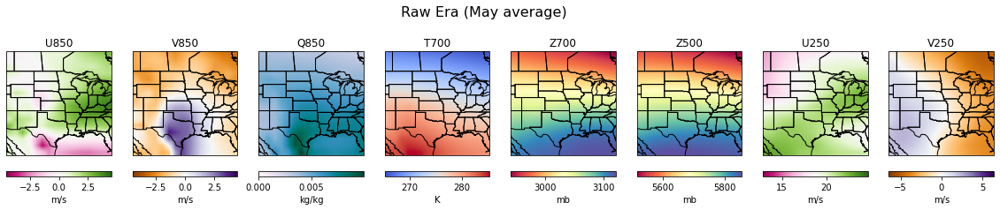

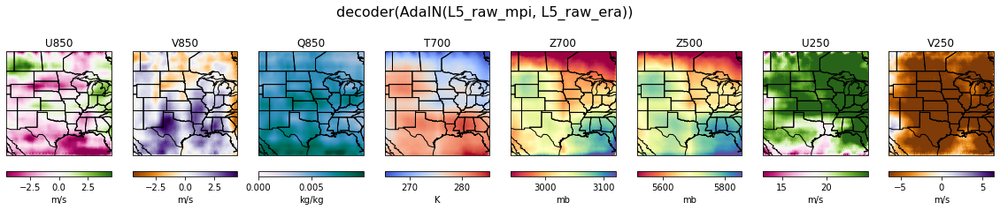

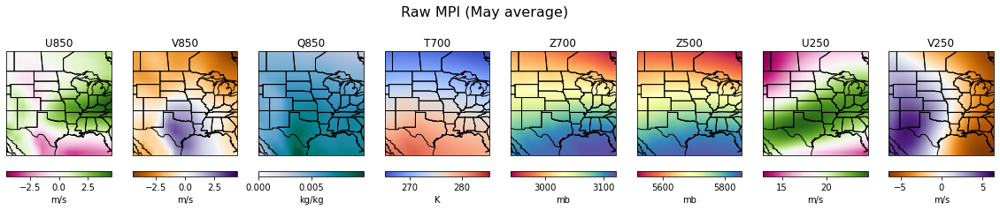

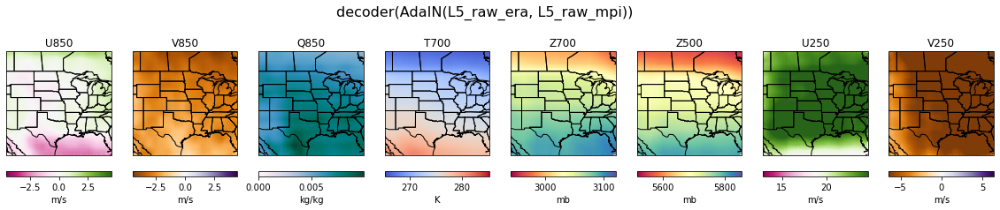

In [110]:
# abs plots

# autoscale
#vmin = [min(era[ii].min(),mpi[ii].min(),raw_mpi[ii].min(),raw_era[ii].min()) for ii in range(15)]
#vmax = [max(era[ii].max(),mpi[ii].max(),raw_mpi[ii].max(),raw_era[ii].max()) for ii in range(15)]
vmin = [min(raw_mpi[ii].min(),raw_era[ii].min()) for ii in range(16)]
vmax = [max(raw_mpi[ii].max(),raw_era[ii].max()) for ii in range(16)]

# vmin = [min(mpi[ii].min(),era[ii].min()) for ii in range(16)]
# vmax = [max(mpi[ii].max(),era[ii].max()) for ii in range(16)]


print(vmin[0:0+8], vmax[0:0+8])
plot_8v_abs(raw_era, 'Raw Era (May average)', vmin[0:0+8], vmax[0:0+8], cc=False)
plot_8v_abs(era, 'decoder(AdaIN(L5_raw_mpi, L5_raw_era))', vmin[0:0+8], vmax[0:0+8], cc=False)
plot_8v_abs(raw_mpi, 'Raw MPI (May average)', vmin[0:0+8], vmax[0:0+8], cc=False)
plot_8v_abs(mpi, 'decoder(AdaIN(L5_raw_era, L5_raw_mpi))', vmin[0:0+8], vmax[0:0+8], cc=False)


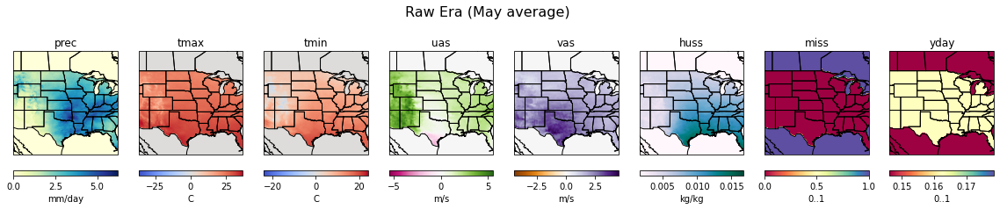

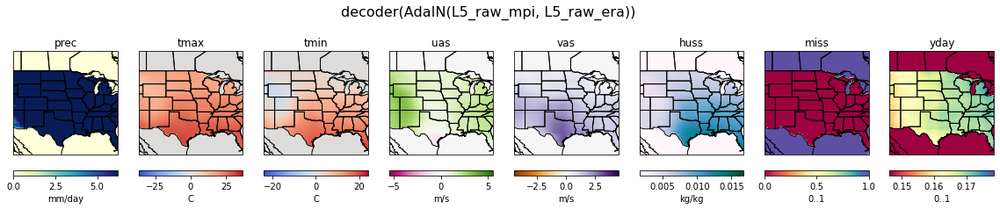

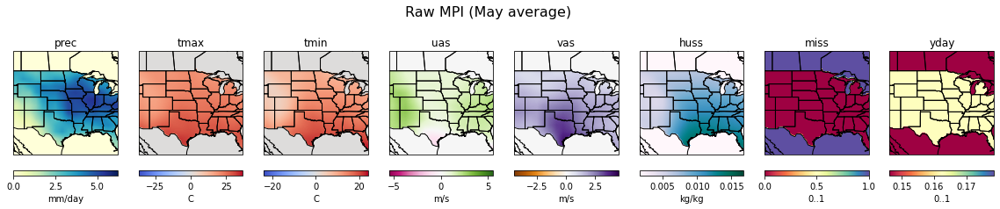

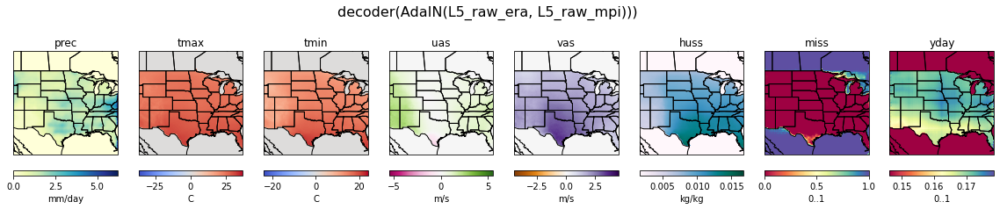

In [102]:
# surf
plot_8v_abs_surf(raw_era, 'Raw Era (May average)', vmin, vmax, cc=False)
plot_8v_abs_surf(era, 'decoder(AdaIN(L5_raw_mpi, L5_raw_era))', vmin, vmax, cc=False)
plot_8v_abs_surf(raw_mpi, 'Raw MPI (May average)', vmin, vmax, cc=False)
plot_8v_abs_surf(mpi, 'decoder(AdaIN(L5_raw_era, L5_raw_mpi)))', vmin, vmax, cc=False)


### Do all 12 months

Jan 0 30


/glade/u/home/dkorytin/miniconda3/envs/na-cordex-zarr-jnb/lib/python3.7/site-packages/torch/nn/functional.py:1806: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


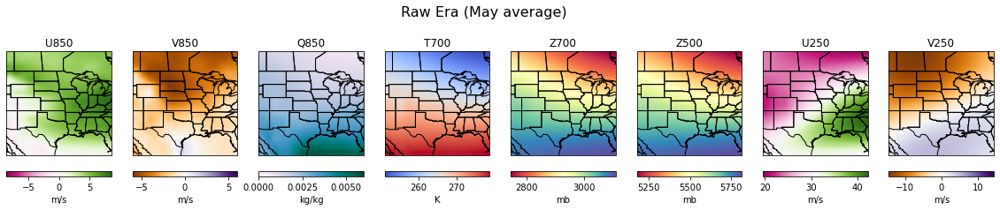

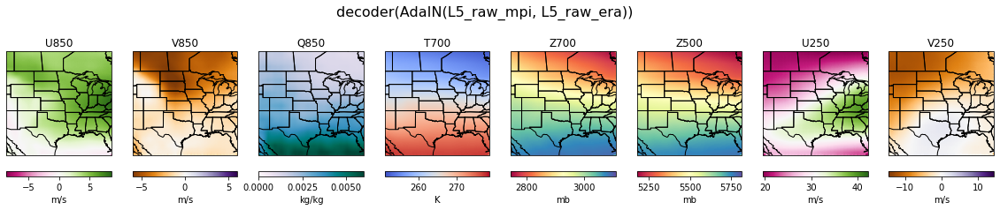

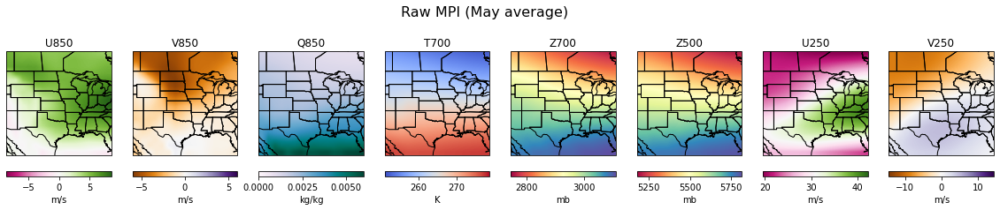

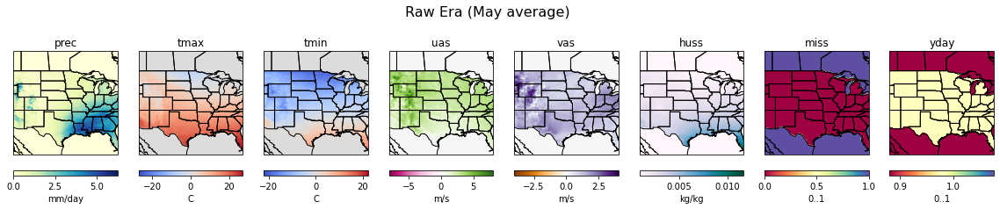

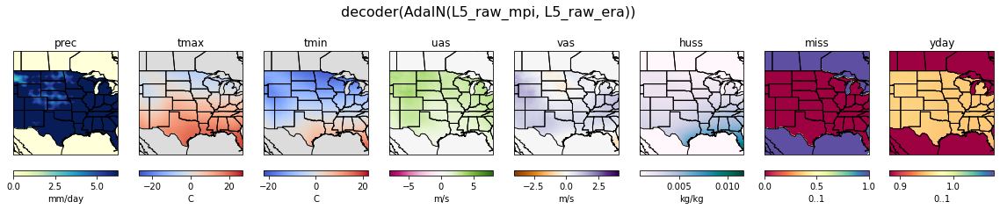

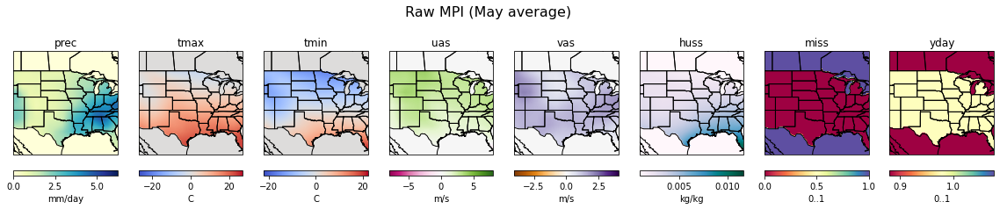

Feb 31 58


/glade/u/home/dkorytin/miniconda3/envs/na-cordex-zarr-jnb/lib/python3.7/site-packages/torch/nn/functional.py:1806: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


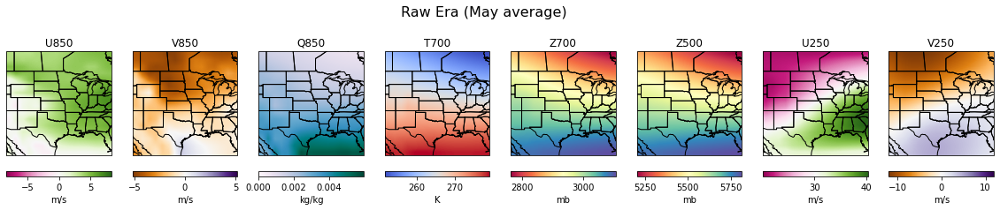

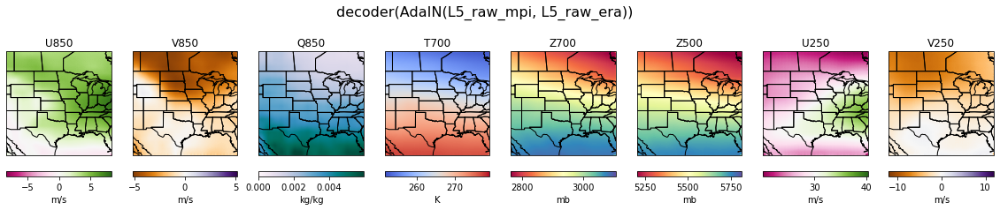

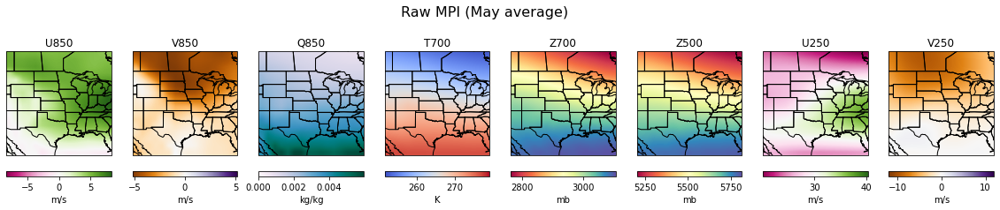

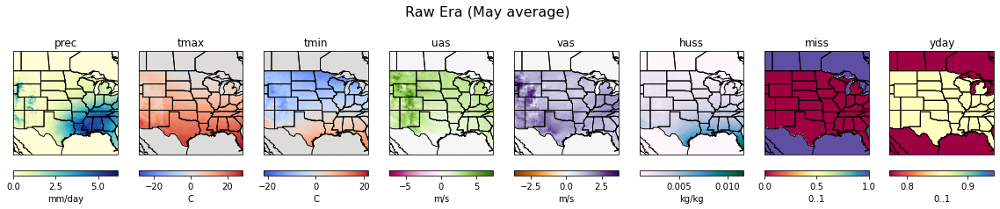

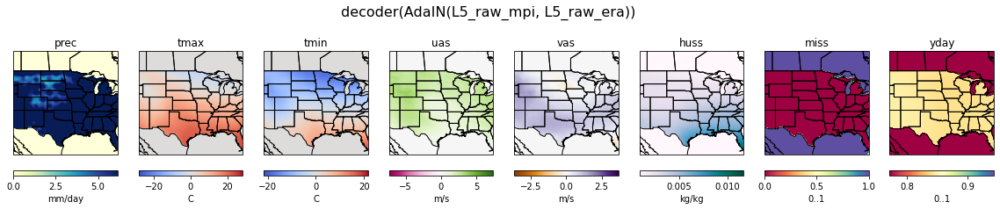

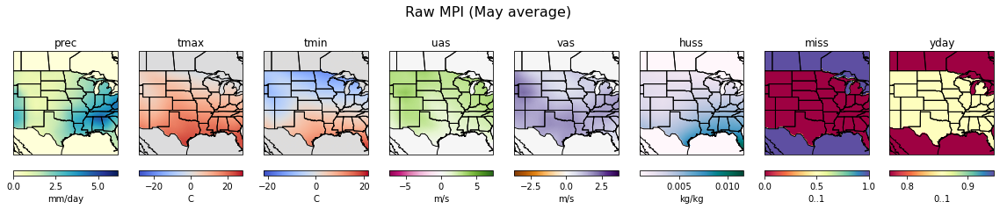

March 59 89


/glade/u/home/dkorytin/miniconda3/envs/na-cordex-zarr-jnb/lib/python3.7/site-packages/torch/nn/functional.py:1806: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


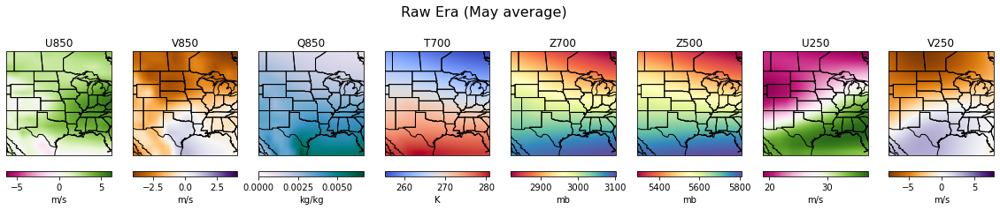

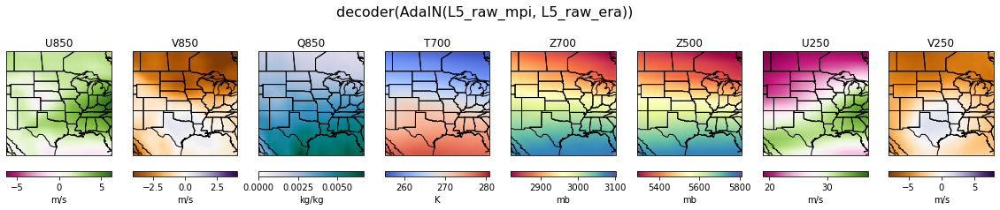

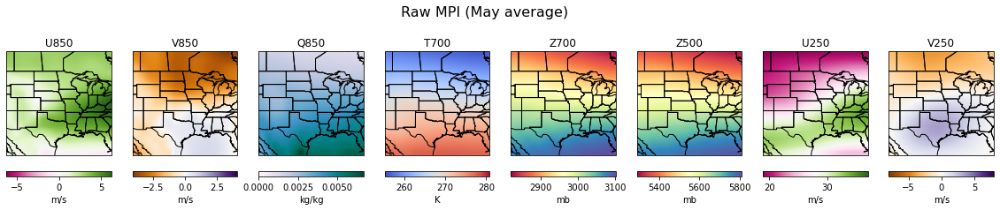

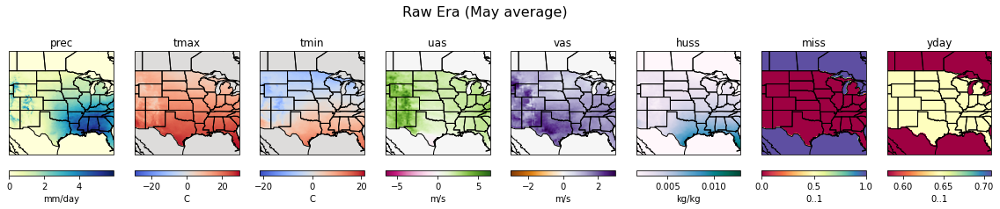

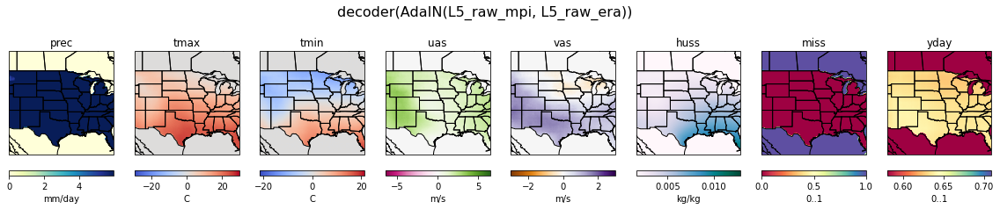

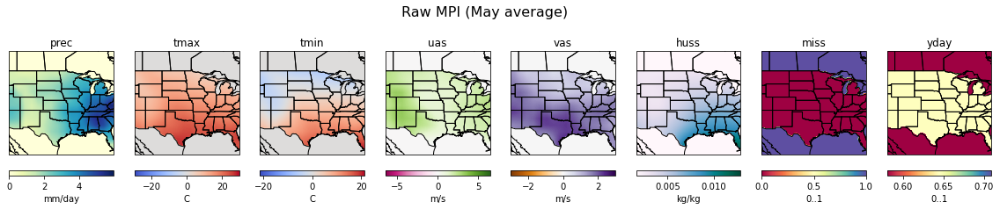

April 90 119


/glade/u/home/dkorytin/miniconda3/envs/na-cordex-zarr-jnb/lib/python3.7/site-packages/torch/nn/functional.py:1806: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


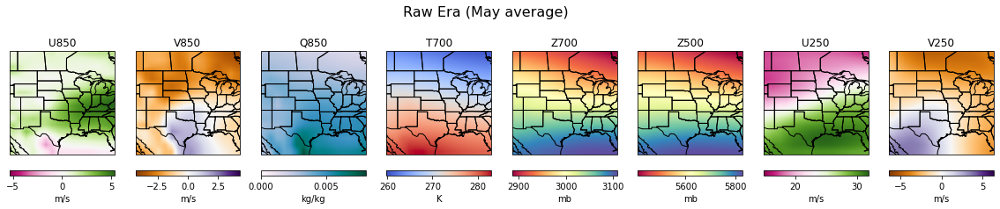

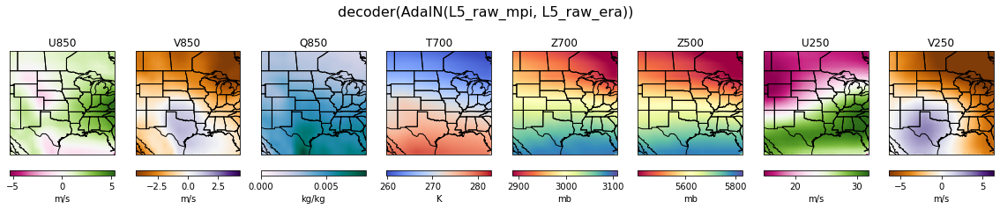

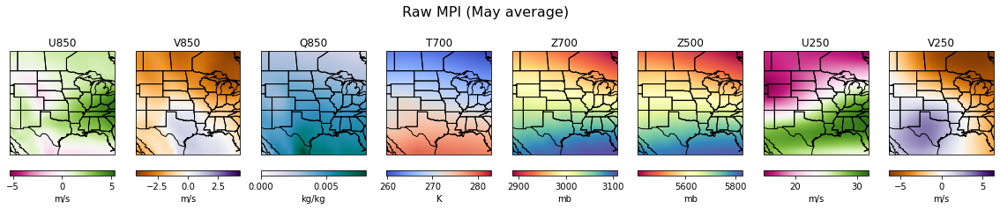

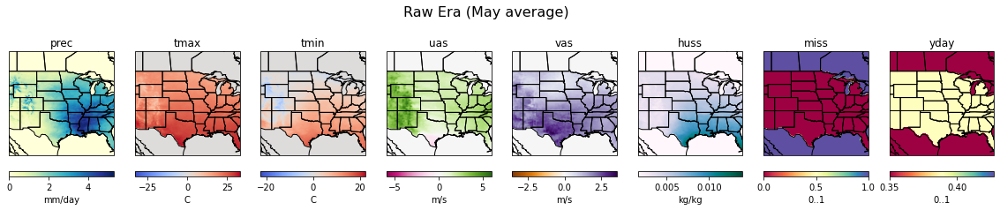

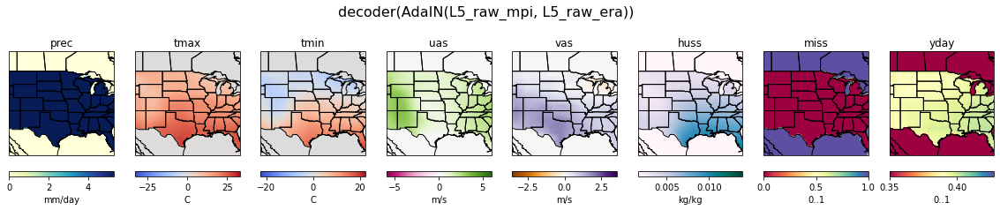

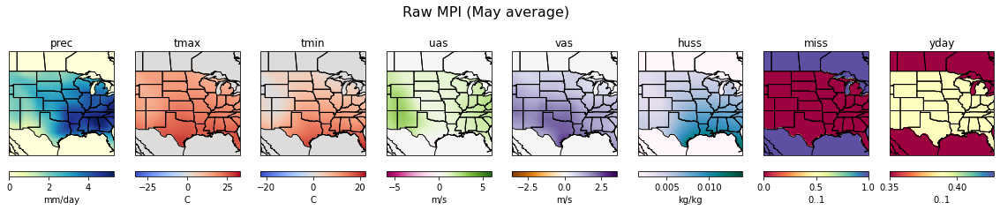

May 120 150


/glade/u/home/dkorytin/miniconda3/envs/na-cordex-zarr-jnb/lib/python3.7/site-packages/torch/nn/functional.py:1806: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


no match, using ii 9993 5 torch.Size([1, 16, 128, 128])


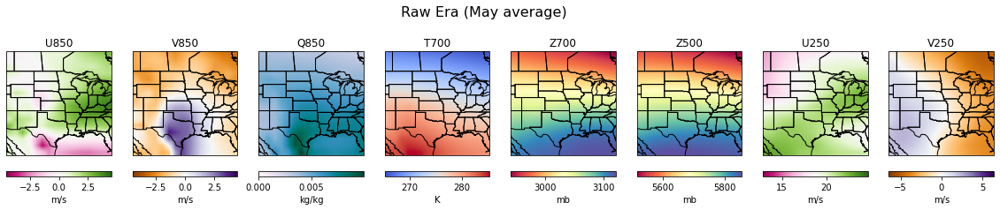

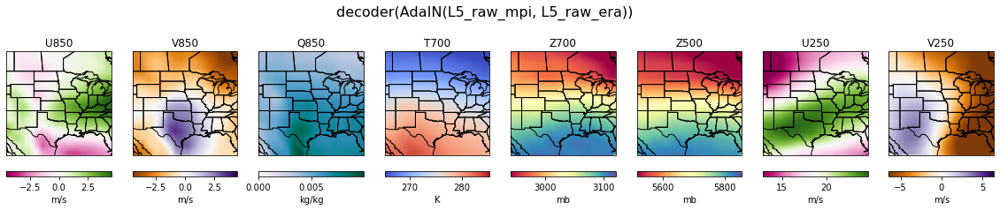

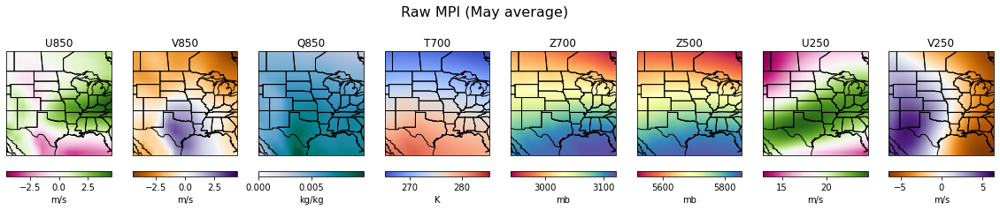

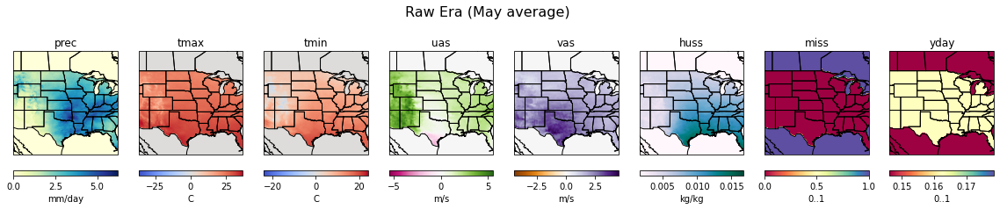

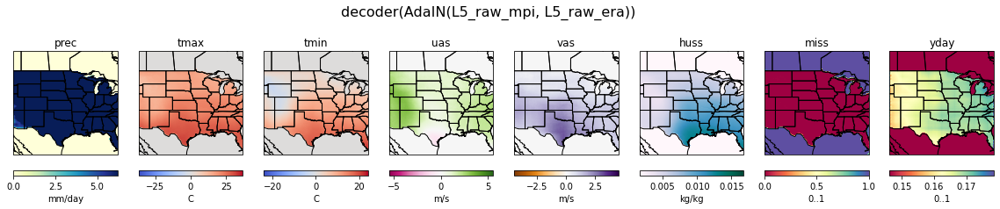

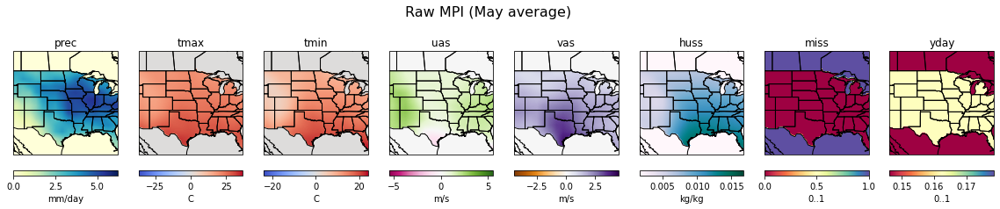

June 151 180


/glade/u/home/dkorytin/miniconda3/envs/na-cordex-zarr-jnb/lib/python3.7/site-packages/torch/nn/functional.py:1806: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


no match, using ii 11121 5 torch.Size([1, 16, 128, 128])
no match, using ii 11121 5 torch.Size([1, 16, 128, 128])


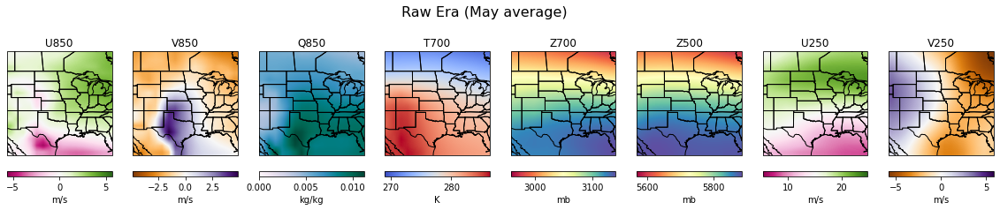

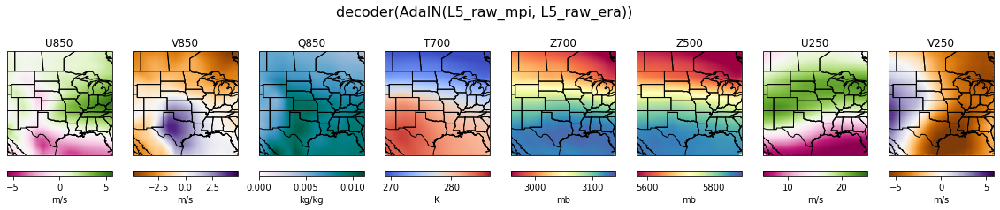

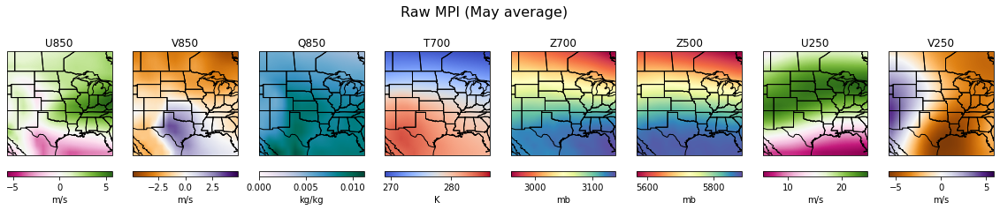

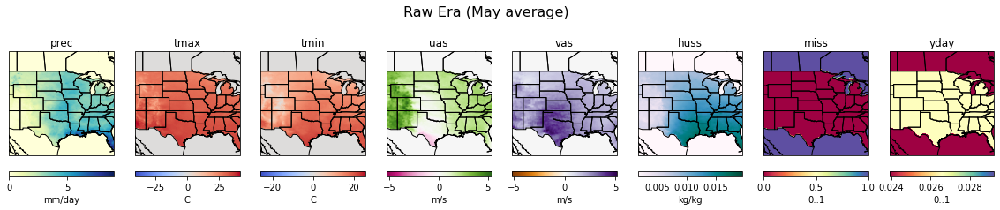

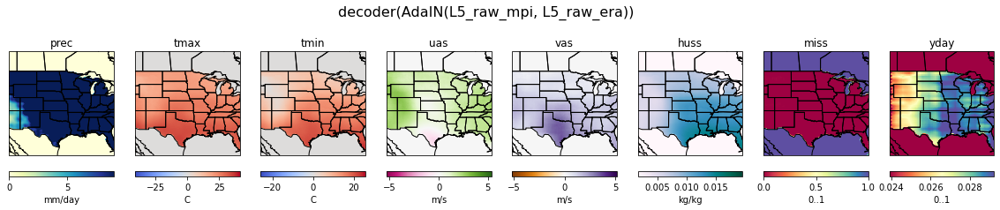

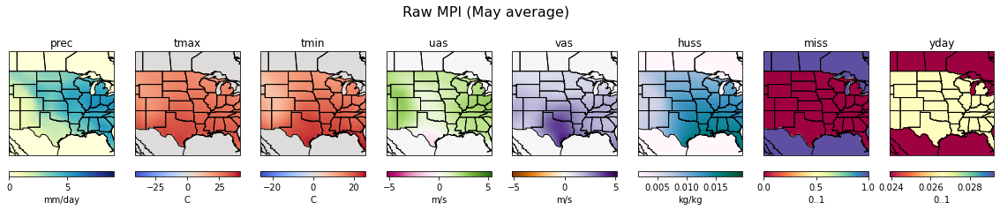

July 181 211


/glade/u/home/dkorytin/miniconda3/envs/na-cordex-zarr-jnb/lib/python3.7/site-packages/torch/nn/functional.py:1806: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


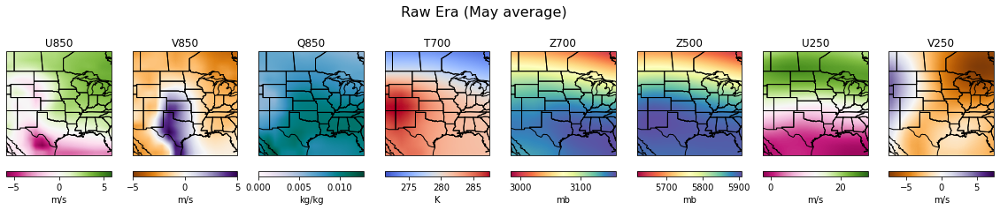

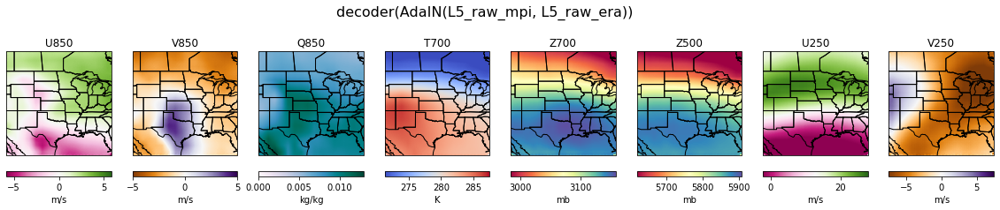

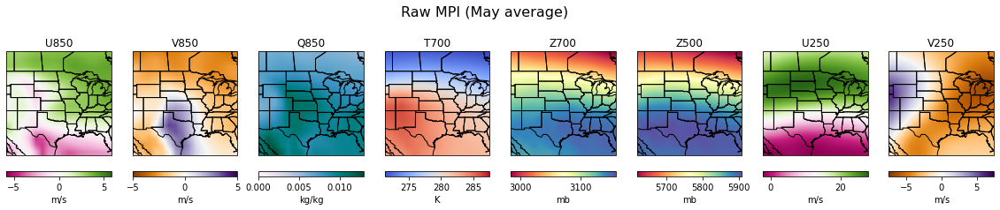

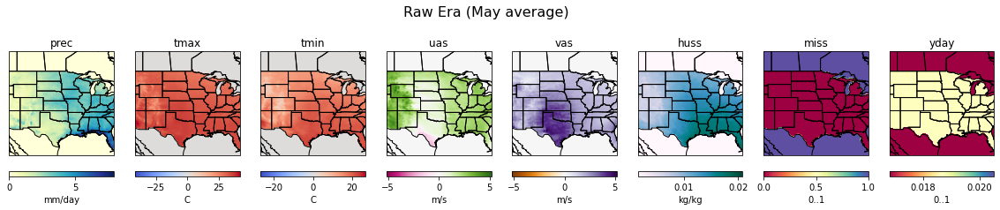

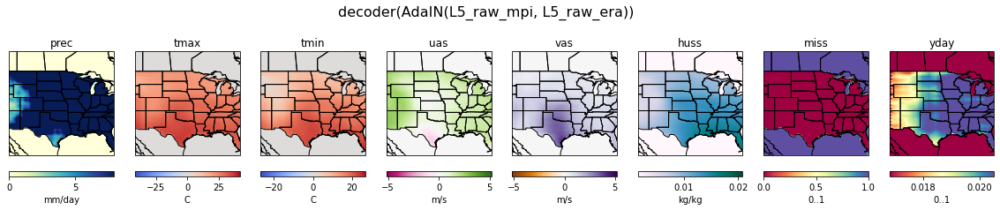

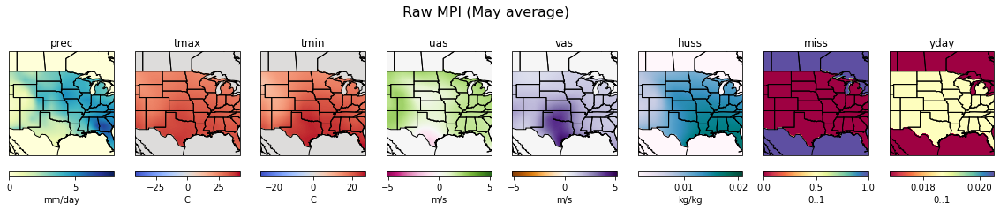

August 212 242


/glade/u/home/dkorytin/miniconda3/envs/na-cordex-zarr-jnb/lib/python3.7/site-packages/torch/nn/functional.py:1806: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


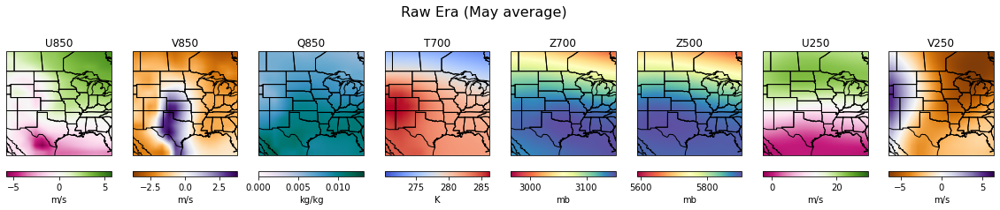

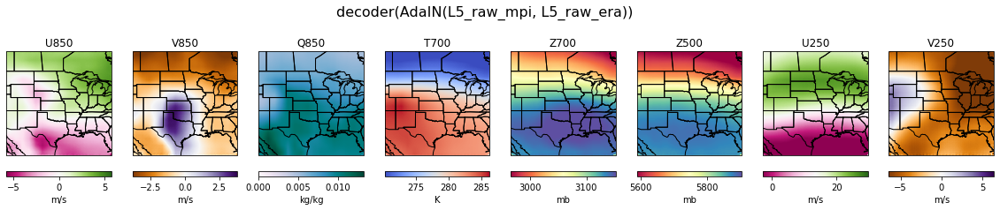

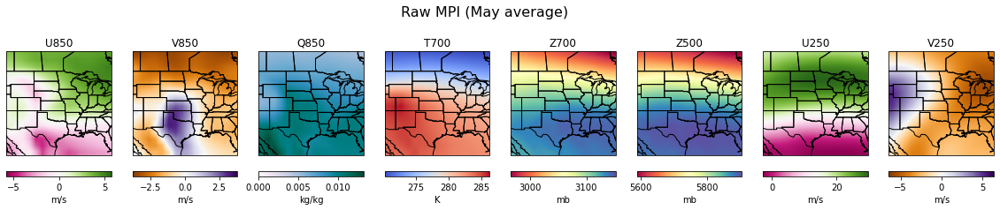

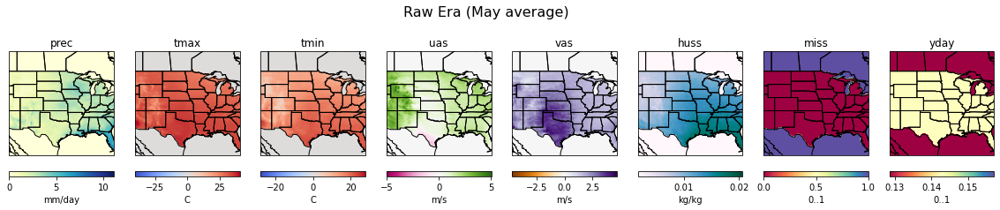

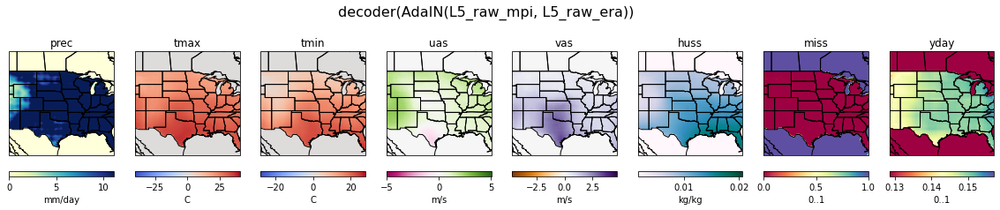

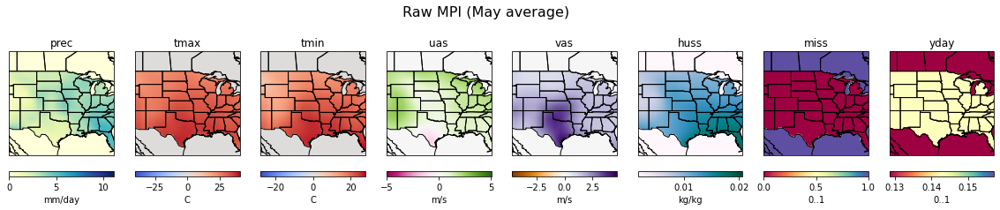

September 243 272


/glade/u/home/dkorytin/miniconda3/envs/na-cordex-zarr-jnb/lib/python3.7/site-packages/torch/nn/functional.py:1806: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


no match, using ii 10110 5 torch.Size([1, 16, 128, 128])


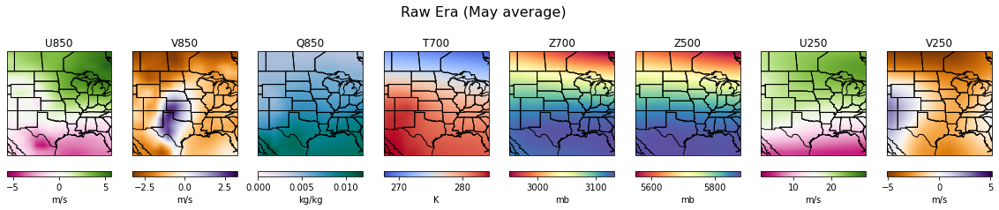

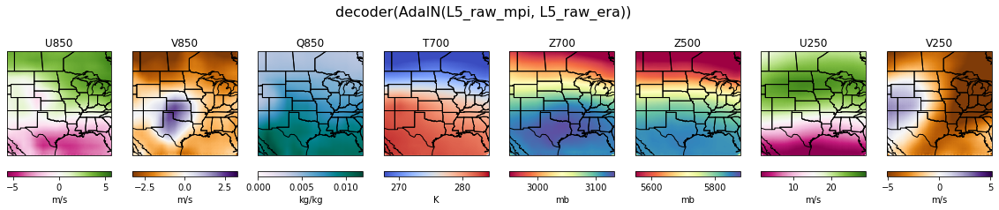

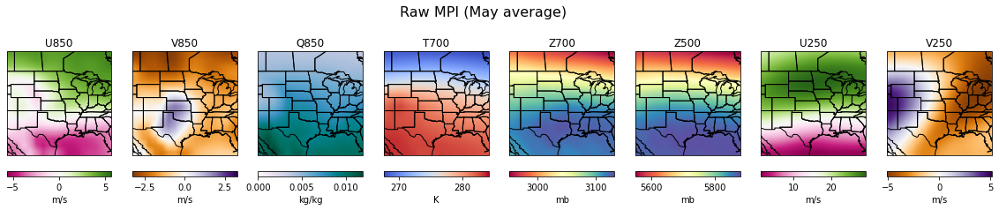

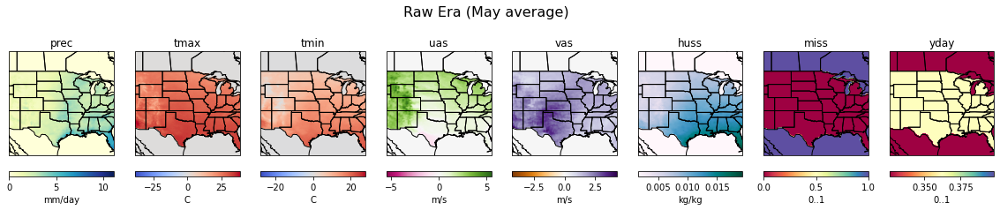

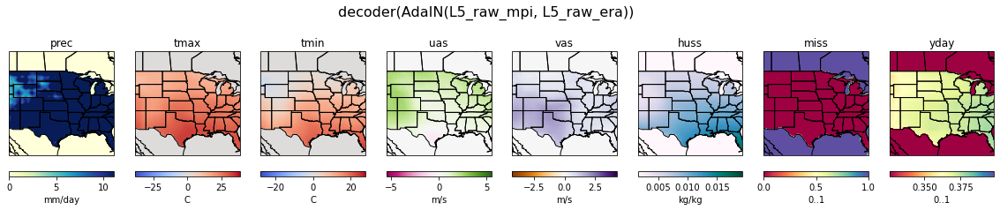

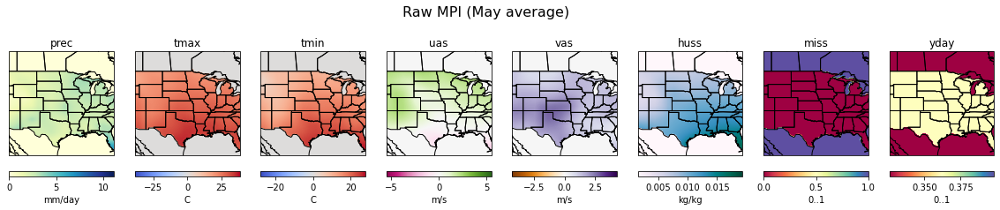

October 273 303


/glade/u/home/dkorytin/miniconda3/envs/na-cordex-zarr-jnb/lib/python3.7/site-packages/torch/nn/functional.py:1806: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


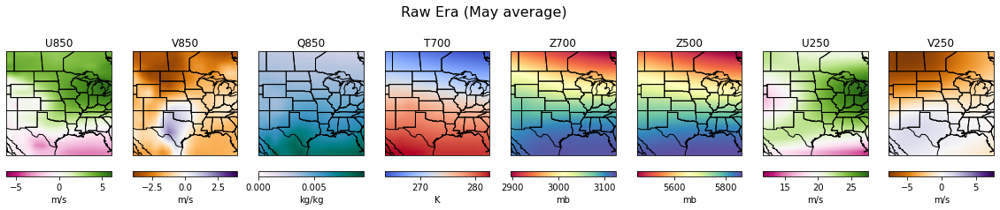

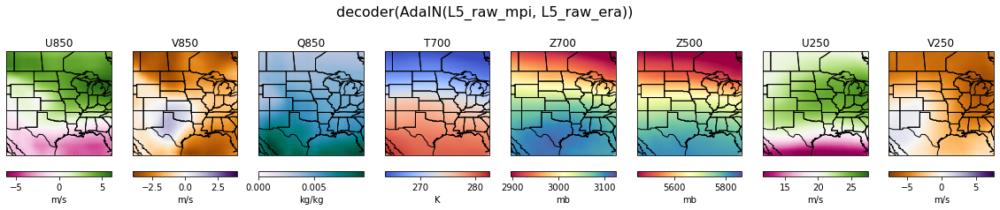

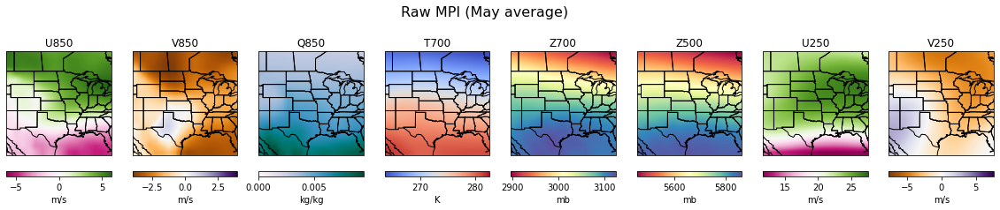

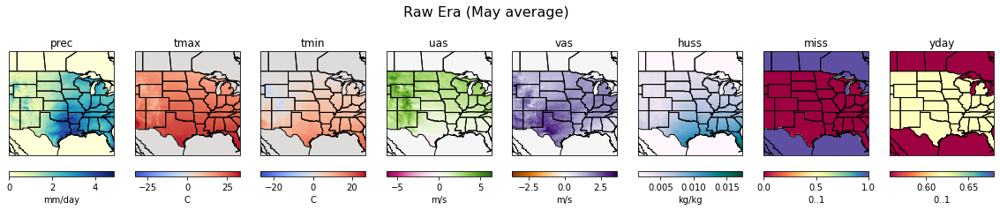

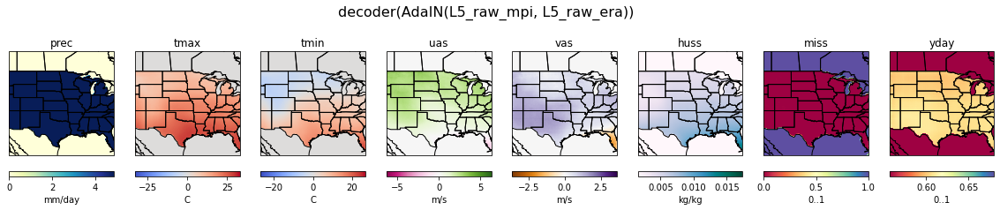

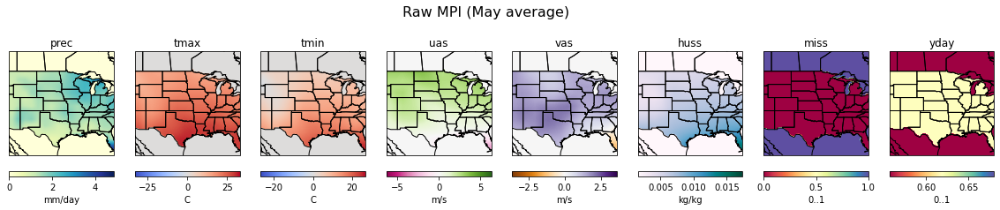

November 304 333


/glade/u/home/dkorytin/miniconda3/envs/na-cordex-zarr-jnb/lib/python3.7/site-packages/torch/nn/functional.py:1806: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


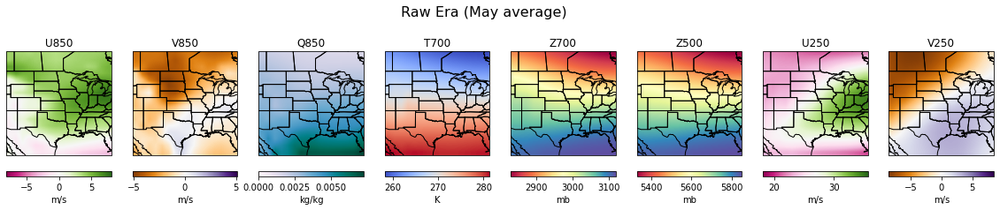

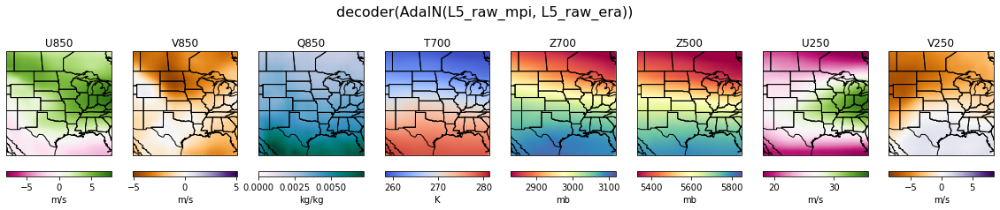

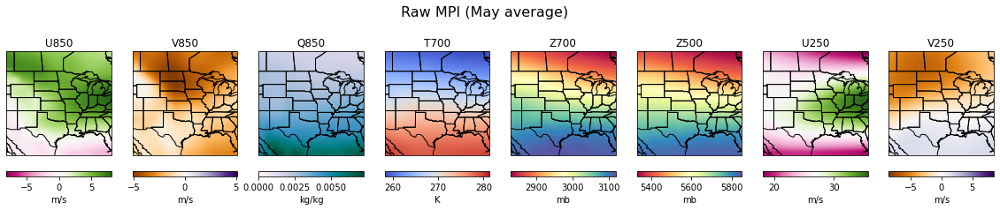

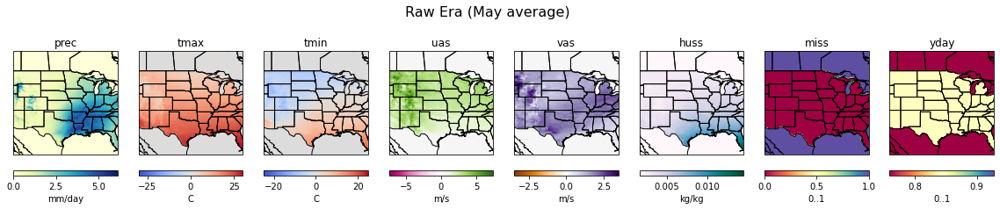

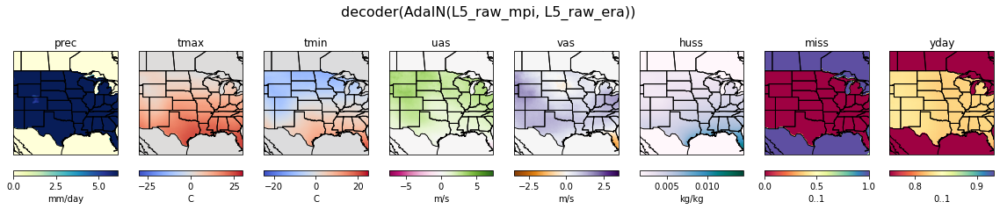

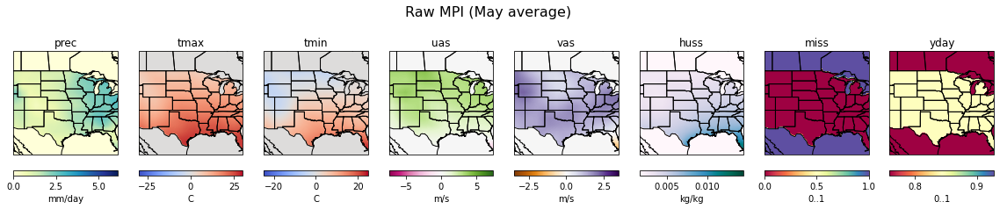

December 334 364


/glade/u/home/dkorytin/miniconda3/envs/na-cordex-zarr-jnb/lib/python3.7/site-packages/torch/nn/functional.py:1806: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


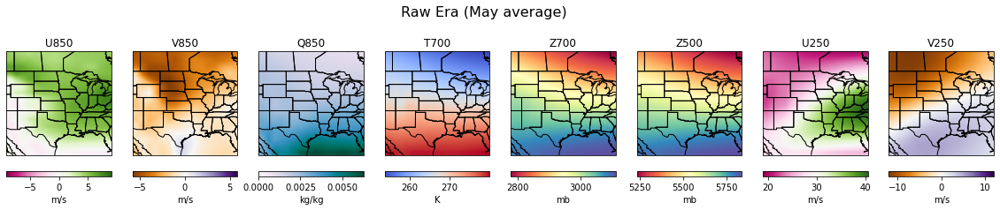

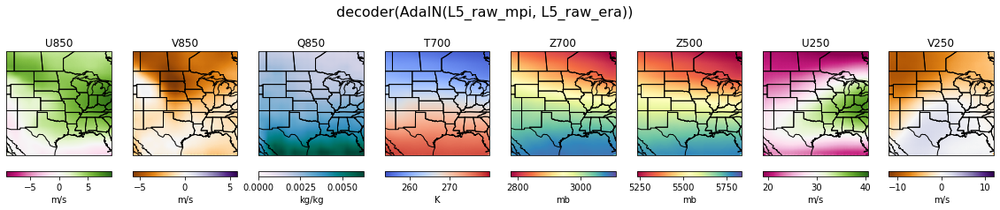

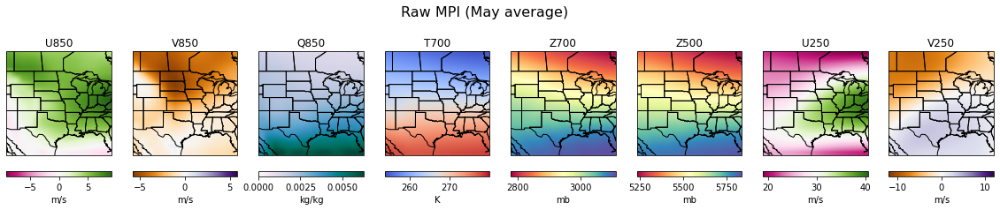

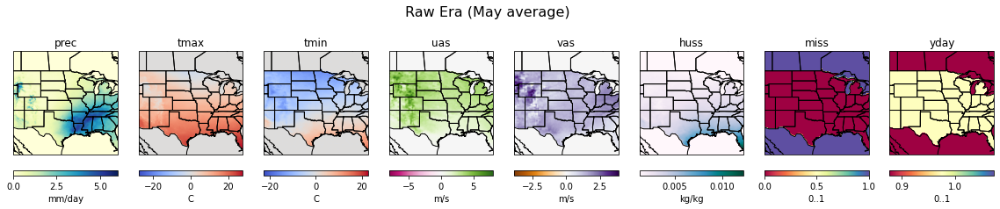

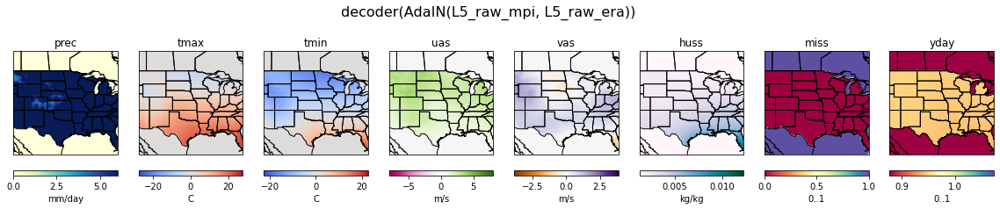

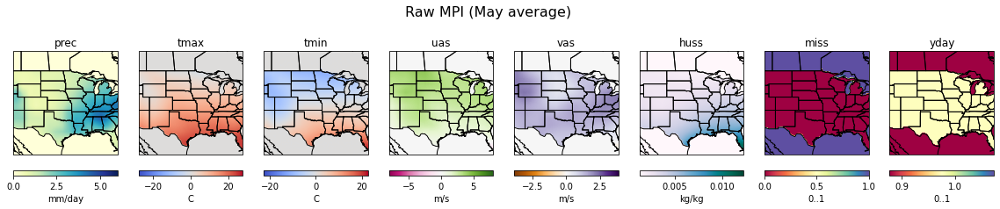

In [103]:
month_names = ['Jan', 'Feb', 'March','April', 'May',     'June',  'July',   'August', 'September','October','November','December']
month_days = [(0,30),(31,58),(59,89),(90,119),(120,150),(151,180),(181,211),(212,242),(243,272), (273,303),(304,333), (334,364)]
for mname, (doy_start, doy_end) in zip(month_names, month_days):
    print(mname, doy_start, doy_end)
    raw_era, raw_mpi, era, mpi = calc_month_average(doy_start, doy_end)
    
    # autoscale
    vmin = [min(raw_mpi[ii].min(),raw_era[ii].min()) for ii in range(16)]
    vmax = [max(raw_mpi[ii].max(),raw_era[ii].max()) for ii in range(16)]

    plot_8v_abs(raw_era, 'Raw Era (May average)', vmin[0:0+8], vmax[0:0+8], cc=False)
    plot_8v_abs(era, 'decoder(AdaIN(L5_raw_mpi, L5_raw_era))', vmin[0:0+8], vmax[0:0+8], cc=False)
    plot_8v_abs(raw_mpi, 'Raw MPI (May average)', vmin[0:0+8], vmax[0:0+8], cc=False)
    #plot_8v_abs(mpi, 'decoder(AdaIN(L5_raw_era, L5_raw_mpi))', vmin[0:0+8], vmax[0:0+8], cc=False)
    
    # surf
    plot_8v_abs_surf(raw_era, 'Raw Era (May average)', vmin, vmax, cc=False)
    plot_8v_abs_surf(era, 'decoder(AdaIN(L5_raw_mpi, L5_raw_era))', vmin, vmax, cc=False)
    plot_8v_abs_surf(raw_mpi, 'Raw MPI (May average)', vmin, vmax, cc=False)
    #plot_8v_abs_surf(mpi, 'decoder(AdaIN(L5_raw_era, L5_raw_mpi)))', vmin, vmax, cc=False)


    

torch.Size([16, 128, 128])


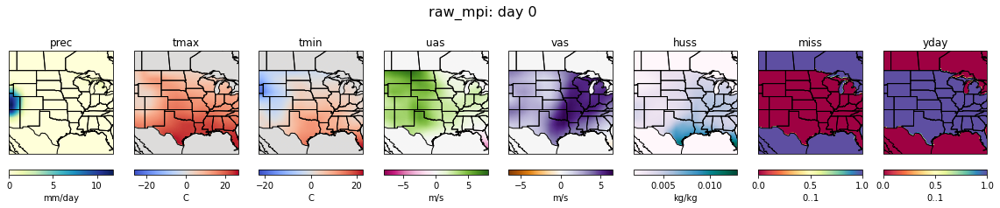

/glade/u/home/dkorytin/miniconda3/envs/na-cordex-zarr-jnb/lib/python3.7/site-packages/torch/nn/functional.py:1806: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


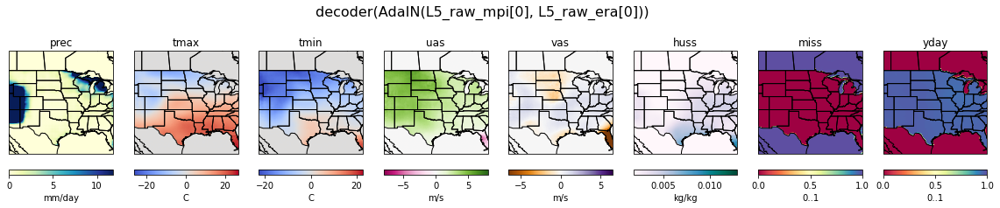

/glade/u/home/dkorytin/miniconda3/envs/na-cordex-zarr-jnb/lib/python3.7/site-packages/torch/nn/functional.py:1806: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


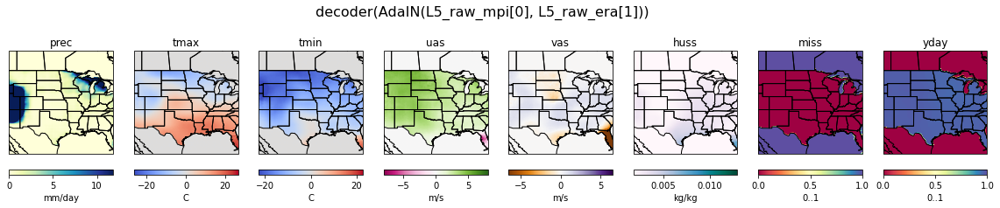

/glade/u/home/dkorytin/miniconda3/envs/na-cordex-zarr-jnb/lib/python3.7/site-packages/torch/nn/functional.py:1806: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


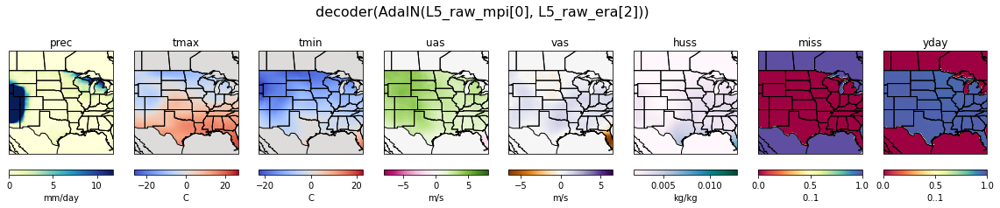

/glade/u/home/dkorytin/miniconda3/envs/na-cordex-zarr-jnb/lib/python3.7/site-packages/torch/nn/functional.py:1806: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


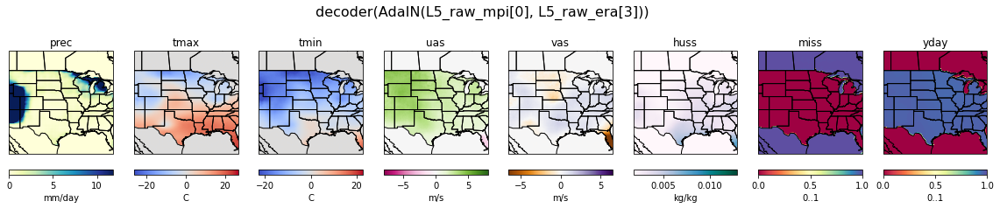

/glade/u/home/dkorytin/miniconda3/envs/na-cordex-zarr-jnb/lib/python3.7/site-packages/torch/nn/functional.py:1806: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


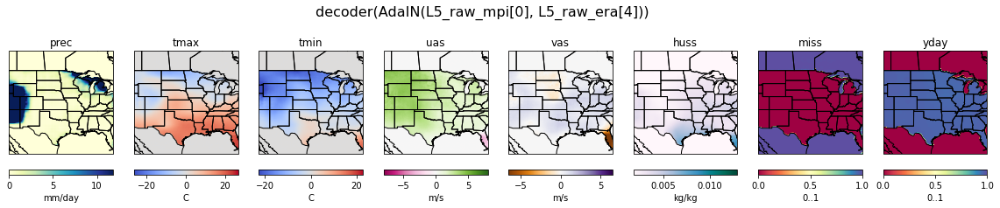

/glade/u/home/dkorytin/miniconda3/envs/na-cordex-zarr-jnb/lib/python3.7/site-packages/torch/nn/functional.py:1806: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


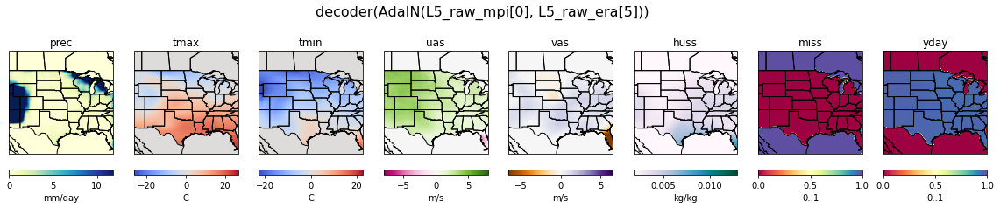

In [105]:
# plot single day before and after
ii = 0
input_era = np.array(samples_era[ii:ii+mb]) 
input_mpi = np.array(samples_mpi[ii:ii+mb])

# ground truth
mpi_denorm = input_mpi * (minmaxi_mpi[:,1]-minmaxi_mpi[:,0])[np.newaxis,:,np.newaxis,np.newaxis] + minmaxi_mpi[:,0][np.newaxis,:,np.newaxis,np.newaxis]
print(input_img_denorm[0].shape)

vmin = [mpi_denorm[0][ii].min() for ii in range(16)]
vmax = [mpi_denorm[0][ii].max() for ii in range(16)]
vmin[15] = 0
vmax[15] = 1

plot_8v_abs_surf(mpi_denorm[0], 'raw_mpi: day %s' % (ii), vmin, vmax, cc=False)

# extrapolation
#for jj in [0,60,120,180,240,300]:
for jj in [0,1,2,3,4,5]:
    input_mpi = samples_mpi[ii:ii+mb]
    input_era = samples_era[jj:jj+mb]

    #generated_img = general_encoder.forward2(general_encoder(input_mpi))
    generated_img = general_encoder.forward2(AdaIN(general_encoder(input_mpi), general_encoder(input_era)))#.data.cpu()
    #generated_img = general_encoder.forward2(AdaIN(general_encoder(generated_img), general_encoder(input_era)))#.data.cpu()
    generated_img = generated_img.detach() * (minmaxi_era[:,1]-minmaxi_era[:,0])[np.newaxis,:,np.newaxis,np.newaxis] + minmaxi_era[:,0][np.newaxis,:,np.newaxis,np.newaxis]
    generated_img = np.array(generated_img)

    plot_8v_abs_surf(generated_img[0], 'decoder(AdaIN(L5_raw_mpi[%s], L5_raw_era[%s]))' % (ii,jj), vmin, vmax, cc=False)


In [104]:
# Plot May averages

# autoscale
vmin = [min((era[ii]-raw[ii]).min(),(mpi[ii]-raw[ii]).min()) for ii in range(8)]
vmax = [max((era[ii]-raw[ii]).max(),(mpi[ii]-raw[ii]).max()) for ii in range(8)]

plot_8v_clim(era-raw, 'Era_decoder - Raw', vmin, vmax)
plot_8v_clim(mpi-raw, 'Mpi_decoder - Raw', vmin, vmax)


NameError: name 'raw' is not defined

In [109]:
#era2era_encoder._modules['conv11'].weights
#dir(era2era_encoder.parameters())
#dir(era2era_encoder)
list(general_encoder.conv55.parameters())[0].shape

torch.Size([16, 1024, 4, 4])

In [243]:
#for param in generator.conv55.parameters():
#    param.requires_grad = False

In [593]:
ii = 0
input_img = samples[ii:ii+mb]
A0 = torch.tensor(input_img, requires_grad = True)
A1 = mpi2mpi_encoder._modules['conv11'].forward(A0)
A2 = mpi2mpi_encoder._modules['conv22'].forward(A1)
A3 = mpi2mpi_encoder._modules['conv33'].forward(A2)
A4 = mpi2mpi_encoder._modules['conv44'].forward(A3)
A5 = mpi2mpi_encoder._modules['conv55'].forward(A4)


/glade/scratch/dkorytin/ipykernel_90953/3094157071.py:3: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A0 = torch.tensor(input_img, requires_grad = True)


In [594]:
A5.max()

tensor(0.0656, grad_fn=<MaxBackward1>)

In [596]:
len(A5[A5>.05])

2

In [590]:
A0 = torch.tensor(input_img, requires_grad = True)
A1 = era2era_encoder._modules['conv11'].forward(A0)
A2 = era2era_encoder._modules['conv22'].forward(A1)
A3 = era2era_encoder._modules['conv33'].forward(A2)
A4 = era2era_encoder._modules['conv44'].forward(A3)
A5 = era2era_encoder._modules['conv55'].forward(A4)


RuntimeError: Expected 4-dimensional input for 4-dimensional weight [128, 15, 4, 4], but got 3-dimensional input of size [15, 128, 128] instead

In [607]:
len(A5[A5>.04])

5

In [401]:
A5.shape

torch.Size([1, 2048, 4, 4])

In [303]:
# backprob experiment
sparsity_err = list(era2era_encoder.conv55.parameters())[2]


In [304]:
sparsity_err.shape

torch.Size([2048, 1024, 4, 4])

### Activation counts

#### Era A5 counts

In [16]:
# era
load_era()

mv1 max/min 29.424848556518555 -32.75809860229492
mv2 max/min 30.625810623168945 -32.32465362548828
mv3 max/min 0.01743147522211075 5.400220470619388e-05
mv4 max/min 294.80206298828125 228.6560821533203
mv5 max/min 3278.9453125 2450.34765625
mv6 max/min 6005.79150390625 4731.3203125
mv7 max/min 99.8348617553711 -42.17079544067383
mv8 max/min 70.305419921875 -81.9678726196289
mv9 max/min 518.7772827148438 0.0
mv10 max/min 49.03771209716797 -34.7857780456543
mv11 max/min 33.991703033447266 -46.72553634643555
mv12 max/min 19.132183074951172 -19.009077072143555
mv13 max/min 17.880800247192383 -18.086332321166992
mv14 max/min 0.024878306314349174 7.658394315512851e-05
mv15 max/min 1 0
9862 9863
mndays 9862


In [23]:
era_counts = []
#for ii in range(0,len(samples),1):
for ii in range(0, int(365.25*4), 1):
    doy = ii % 365.25
    #if 1:
    #if doy >= 0 and doy <= 30:      # Dec
    #if doy >= 120 and doy <= 150:   # May
        
    input_img = samples[ii:ii+mb]
       
    A0 = torch.tensor(input_img, requires_grad = True)
    A5 = era2era_encoder.forward(A0)
#     A1 = era2era_encoder._modules['conv11'].forward(A0)
#     A2 = era2era_encoder._modules['conv22'].forward(A1)
#     A3 = era2era_encoder._modules['conv33'].forward(A2)
#     A4 = era2era_encoder._modules['conv44'].forward(A3)
#     A5 = era2era_encoder._modules['conv55'].forward(A4)

    thmin = .999
    thmax = 1
    era_counts.append(len(A5[(A5>thmin) & (A5<thmax)]))    
    print(ii, doy, len(A5[(A5>thmin) & (A5<thmax)]), np.where((A5>thmin) & (A5<thmax)))
    print(A5[(A5>thmin) & (A5<thmax)])
    print()





/glade/scratch/dkorytin/ipykernel_43745/316302904.py:11: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A0 = torch.tensor(input_img, requires_grad = True)


0 0.0 6 (array([0, 0, 0, 0, 0, 0]), array([ 82, 175, 175, 175, 496, 925]), array([3, 3, 3, 3, 3, 0]), array([0, 0, 1, 2, 2, 2]))
tensor([0.9991, 0.9999, 0.9991, 0.9995, 0.9990, 0.9995],
       grad_fn=<IndexBackward0>)

1 1.0 4 (array([0, 0, 0, 0]), array([ 175,  605, 1213, 1964]), array([3, 3, 3, 3]), array([2, 1, 1, 1]))
tensor([0.9996, 0.9992, 0.9992, 0.9991], grad_fn=<IndexBackward0>)

2 2.0 2 (array([0, 0]), array([175, 824]), array([3, 0]), array([0, 1]))
tensor([0.9993, 0.9992], grad_fn=<IndexBackward0>)

3 3.0 8 (array([0, 0, 0, 0, 0, 0, 0, 0]), array([ 175,  175,  496,  605,  648, 1213, 1695, 1964]), array([3, 3, 3, 3, 3, 3, 3, 3]), array([0, 2, 2, 2, 2, 2, 2, 2]))
tensor([0.9998, 0.9996, 0.9995, 0.9994, 0.9995, 0.9997, 0.9991, 0.9996],
       grad_fn=<IndexBackward0>)

4 4.0 3 (array([0, 0, 0]), array([ 82, 175, 175]), array([3, 3, 3]), array([2, 0, 2]))
tensor([0.9992, 0.9997, 0.9998], grad_fn=<IndexBackward0>)

5 5.0 4 (array([0, 0, 0, 0]), array([ 175,  175,  925, 1213]), 

40 40.0 5 (array([0, 0, 0, 0, 0]), array([ 175,  605,  648, 1213, 1964]), array([3, 3, 3, 3, 3]), array([2, 2, 2, 2, 2]))
tensor([0.9991, 0.9993, 0.9992, 0.9996, 0.9994], grad_fn=<IndexBackward0>)

41 41.0 1 (array([0]), array([1213]), array([3]), array([2]))
tensor([0.9990], grad_fn=<IndexBackward0>)

42 42.0 4 (array([0, 0, 0, 0]), array([ 605,  648, 1213, 1964]), array([3, 3, 3, 3]), array([2, 2, 2, 2]))
tensor([0.9993, 0.9995, 0.9997, 0.9996], grad_fn=<IndexBackward0>)

43 43.0 8 (array([0, 0, 0, 0, 0, 0, 0, 0]), array([ 175,  496,  605,  648,  824, 1213, 1695, 1964]), array([3, 3, 3, 3, 0, 3, 3, 3]), array([2, 2, 2, 2, 3, 2, 2, 2]))
tensor([0.9993, 0.9995, 0.9997, 0.9993, 0.9997, 0.9997, 0.9996, 0.9994],
       grad_fn=<IndexBackward0>)

44 44.0 7 (array([0, 0, 0, 0, 0, 0, 0]), array([ 496,  605,  648, 1213, 1213, 1695, 1964]), array([3, 3, 3, 3, 3, 3, 3]), array([2, 2, 2, 1, 2, 2, 2]))
tensor([0.9993, 0.9992, 0.9991, 0.9991, 0.9996, 0.9991, 0.9992],
       grad_fn=<IndexBackward0

84 84.0 13 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 605,  605,  648,  648,  648, 1213, 1213, 1213, 1695, 1695, 1964,
       1964, 1964]), array([3, 3, 0, 3, 3, 0, 3, 3, 3, 3, 0, 3, 3]), array([1, 2, 0, 1, 2, 0, 1, 2, 1, 2, 0, 1, 2]))
tensor([0.9996, 0.9995, 0.9992, 0.9997, 0.9998, 0.9994, 0.9998, 0.9999, 0.9992,
        0.9991, 0.9991, 0.9998, 0.9999], grad_fn=<IndexBackward0>)

85 85.0 4 (array([0, 0, 0, 0]), array([ 824,  824, 1213, 1244]), array([0, 0, 3, 2]), array([1, 3, 2, 0]))
tensor([0.9993, 0.9994, 0.9992, 0.9992], grad_fn=<IndexBackward0>)

86 86.0 7 (array([0, 0, 0, 0, 0, 0, 0]), array([ 605,  648,  824, 1213, 1213, 1964, 1964]), array([3, 3, 0, 3, 3, 3, 3]), array([1, 1, 1, 1, 2, 1, 2]))
tensor([0.9992, 0.9995, 0.9992, 0.9996, 0.9995, 0.9996, 0.9993],
       grad_fn=<IndexBackward0>)

87 87.0 2 (array([0, 0]), array([ 824, 1213]), array([0, 3]), array([1, 2]))
tensor([0.9994, 0.9993], grad_fn=<IndexBackward0>)

88 88.0 6 (array([0, 0, 0, 0, 0, 0]), array([ 6

120 120.0 4 (array([0, 0, 0, 0]), array([ 605,  648, 1213, 1964]), array([3, 3, 3, 3]), array([2, 2, 2, 2]))
tensor([0.9994, 0.9994, 0.9997, 0.9996], grad_fn=<IndexBackward0>)

121 121.0 5 (array([0, 0, 0, 0, 0]), array([ 175,  824,  925, 1213, 1964]), array([3, 0, 0, 3, 3]), array([0, 1, 2, 2, 2]))
tensor([0.9991, 0.9992, 0.9992, 0.9994, 0.9990], grad_fn=<IndexBackward0>)

122 122.0 3 (array([0, 0, 0]), array([ 925, 1213, 1964]), array([0, 3, 3]), array([2, 2, 2]))
tensor([0.9992, 0.9995, 0.9991], grad_fn=<IndexBackward0>)

123 123.0 11 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([  35,  605,  648,  648,  824,  824,  925, 1213, 1213, 1964, 1964]), array([0, 0, 0, 3, 0, 0, 0, 0, 3, 0, 3]), array([1, 0, 0, 2, 1, 3, 0, 0, 2, 0, 2]))
tensor([0.9992, 0.9995, 0.9996, 0.9993, 0.9995, 0.9995, 0.9993, 0.9997, 0.9997,
        0.9997, 0.9996], grad_fn=<IndexBackward0>)

124 124.0 3 (array([0, 0, 0]), array([ 824,  824, 1213]), array([0, 0, 3]), array([1, 3, 2]))
tensor([0.9998, 0.9998, 0.99

167 167.0 3 (array([0, 0, 0]), array([ 824,  824, 1905]), array([0, 0, 1]), array([2, 3, 0]))
tensor([0.9992, 0.9991, 0.9990], grad_fn=<IndexBackward0>)

168 168.0 2 (array([0, 0]), array([ 824, 1659]), array([0, 1]), array([3, 0]))
tensor([0.9997, 0.9993], grad_fn=<IndexBackward0>)

169 169.0 1 (array([0]), array([824]), array([0]), array([3]))
tensor([0.9995], grad_fn=<IndexBackward0>)

170 170.0 0 (array([], dtype=int64), array([], dtype=int64), array([], dtype=int64), array([], dtype=int64))
tensor([], grad_fn=<IndexBackward0>)

171 171.0 8 (array([0, 0, 0, 0, 0, 0, 0, 0]), array([ 605,  648,  824,  824,  925, 1213, 1695, 1964]), array([3, 3, 0, 0, 3, 3, 3, 3]), array([2, 2, 1, 3, 2, 2, 2, 2]))
tensor([0.9995, 0.9991, 0.9994, 0.9997, 0.9991, 0.9995, 0.9992, 0.9990],
       grad_fn=<IndexBackward0>)

172 172.0 2 (array([0, 0]), array([824, 824]), array([0, 0]), array([1, 3]))
tensor([0.9993, 0.9995], grad_fn=<IndexBackward0>)

173 173.0 2 (array([0, 0]), array([824, 824]), array([0,

229 229.0 8 (array([0, 0, 0, 0, 0, 0, 0, 0]), array([ 605,  648,  648,  824, 1213, 1213, 1964, 1964]), array([3, 3, 3, 0, 3, 3, 3, 3]), array([2, 1, 2, 3, 1, 2, 1, 2]))
tensor([0.9990, 0.9992, 0.9995, 0.9999, 0.9994, 0.9998, 0.9991, 0.9995],
       grad_fn=<IndexBackward0>)

230 230.0 2 (array([0, 0]), array([824, 824]), array([0, 0]), array([1, 3]))
tensor([0.9993, 0.9991], grad_fn=<IndexBackward0>)

231 231.0 5 (array([0, 0, 0, 0, 0]), array([ 824,  824,  925, 1213, 1964]), array([0, 0, 0, 3, 3]), array([1, 3, 2, 2, 2]))
tensor([0.9991, 0.9998, 0.9993, 0.9992, 0.9992], grad_fn=<IndexBackward0>)

232 232.0 9 (array([0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 605,  648,  824,  824,  925,  925, 1213, 1695, 1964]), array([3, 3, 0, 0, 0, 3, 3, 3, 3]), array([2, 2, 1, 3, 2, 2, 2, 2, 2]))
tensor([0.9995, 0.9997, 0.9992, 0.9997, 0.9995, 0.9991, 0.9998, 0.9992, 0.9997],
       grad_fn=<IndexBackward0>)

233 233.0 4 (array([0, 0, 0, 0]), array([ 824,  925, 1213, 1964]), array([0, 0, 3, 3]), array([3

263 263.0 5 (array([0, 0, 0, 0, 0]), array([ 648, 1213, 1213, 1964, 1964]), array([3, 3, 3, 3, 3]), array([2, 1, 2, 1, 2]))
tensor([0.9993, 0.9993, 0.9997, 0.9991, 0.9995], grad_fn=<IndexBackward0>)

264 264.0 2 (array([0, 0]), array([824, 925]), array([0, 0]), array([3, 2]))
tensor([0.9992, 0.9991], grad_fn=<IndexBackward0>)

265 265.0 7 (array([0, 0, 0, 0, 0, 0, 0]), array([ 694,  824,  824,  889,  925, 1213, 1889]), array([1, 0, 0, 1, 0, 3, 1]), array([3, 2, 3, 3, 2, 2, 3]))
tensor([0.9992, 0.9996, 0.9997, 0.9996, 0.9995, 0.9994, 0.9995],
       grad_fn=<IndexBackward0>)

266 266.0 8 (array([0, 0, 0, 0, 0, 0, 0, 0]), array([ 694,  824,  824,  889,  925, 1213, 1889, 2006]), array([1, 0, 0, 1, 0, 0, 1, 0]), array([3, 2, 3, 3, 2, 2, 3, 3]))
tensor([0.9992, 0.9997, 0.9998, 0.9992, 0.9999, 0.9991, 0.9992, 0.9994],
       grad_fn=<IndexBackward0>)

267 267.0 3 (array([0, 0, 0]), array([694, 824, 925]), array([1, 0, 0]), array([2, 3, 2]))
tensor([0.9991, 0.9991, 0.9991], grad_fn=<IndexBack

302 302.0 4 (array([0, 0, 0, 0]), array([ 648,  925, 1213, 1964]), array([3, 0, 3, 3]), array([2, 2, 2, 2]))
tensor([0.9991, 0.9995, 0.9996, 0.9990], grad_fn=<IndexBackward0>)

303 303.0 4 (array([0, 0, 0, 0]), array([ 824,  870,  925, 1213]), array([0, 1, 0, 3]), array([2, 1, 2, 2]))
tensor([0.9993, 0.9990, 0.9998, 0.9992], grad_fn=<IndexBackward0>)

304 304.0 8 (array([0, 0, 0, 0, 0, 0, 0, 0]), array([ 605,  648,  824,  925, 1213, 1213, 1964, 1964]), array([3, 3, 0, 0, 3, 3, 3, 3]), array([1, 2, 3, 2, 1, 2, 1, 2]))
tensor([0.9991, 0.9994, 0.9995, 0.9998, 0.9994, 0.9997, 0.9990, 0.9993],
       grad_fn=<IndexBackward0>)

305 305.0 2 (array([0, 0]), array([694, 824]), array([1, 0]), array([3, 1]))
tensor([0.9992, 0.9990], grad_fn=<IndexBackward0>)

306 306.0 4 (array([0, 0, 0, 0]), array([ 824,  824,  925, 1213]), array([0, 0, 0, 0]), array([1, 2, 2, 2]))
tensor([0.9993, 0.9994, 0.9998, 0.9991], grad_fn=<IndexBackward0>)

307 307.0 1 (array([0]), array([824]), array([0]), array([3]))
t

348 348.0 8 (array([0, 0, 0, 0, 0, 0, 0, 0]), array([ 175,  605,  880, 1213, 1571, 1610, 1695, 1964]), array([3, 3, 2, 3, 2, 2, 3, 3]), array([2, 2, 2, 2, 1, 2, 2, 2]))
tensor([0.9991, 0.9993, 0.9996, 0.9995, 0.9993, 0.9995, 0.9992, 0.9992],
       grad_fn=<IndexBackward0>)

349 349.0 7 (array([0, 0, 0, 0, 0, 0, 0]), array([ 175,  605,  648,  824,  925, 1213, 1964]), array([3, 3, 3, 0, 0, 3, 3]), array([0, 2, 2, 1, 2, 2, 2]))
tensor([0.9991, 0.9991, 0.9996, 0.9992, 0.9992, 0.9997, 0.9998],
       grad_fn=<IndexBackward0>)

350 350.0 3 (array([0, 0, 0]), array([ 648, 1213, 1964]), array([3, 3, 3]), array([2, 2, 2]))
tensor([0.9993, 0.9996, 0.9995], grad_fn=<IndexBackward0>)

351 351.0 6 (array([0, 0, 0, 0, 0, 0]), array([ 648,  648, 1213, 1213, 1964, 1964]), array([3, 3, 3, 3, 3, 3]), array([1, 2, 1, 2, 1, 2]))
tensor([0.9993, 0.9993, 0.9996, 0.9996, 0.9992, 0.9993],
       grad_fn=<IndexBackward0>)

352 352.0 6 (array([0, 0, 0, 0, 0, 0]), array([ 605,  648,  925, 1213, 1695, 1964]), ar

385 19.75 1 (array([0]), array([925]), array([0]), array([2]))
tensor([0.9994], grad_fn=<IndexBackward0>)

386 20.75 10 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 605,  605,  648,  648,  925, 1213, 1213, 1889, 1964, 1964]), array([3, 3, 3, 3, 0, 3, 3, 1, 3, 3]), array([1, 2, 1, 2, 2, 1, 2, 1, 1, 2]))
tensor([0.9990, 0.9991, 0.9991, 0.9993, 0.9993, 0.9995, 0.9997, 0.9991, 0.9995,
        0.9995], grad_fn=<IndexBackward0>)

387 21.75 5 (array([0, 0, 0, 0, 0]), array([ 175,  605,  648, 1213, 1964]), array([3, 3, 3, 3, 3]), array([2, 2, 2, 2, 2]))
tensor([0.9992, 0.9991, 0.9997, 0.9999, 0.9998], grad_fn=<IndexBackward0>)

388 22.75 4 (array([0, 0, 0, 0]), array([ 175,  648, 1213, 1964]), array([3, 3, 3, 3]), array([2, 2, 2, 2]))
tensor([0.9994, 0.9993, 0.9996, 0.9994], grad_fn=<IndexBackward0>)

389 23.75 11 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 175,  605,  648,  648, 1213, 1213, 1695, 1838, 1964, 1964, 2017]), array([3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 2]), array([2, 2, 1, 2, 

426 60.75 4 (array([0, 0, 0, 0]), array([ 648,  824, 1213, 1964]), array([3, 0, 3, 3]), array([2, 1, 2, 2]))
tensor([0.9994, 0.9991, 0.9997, 0.9994], grad_fn=<IndexBackward0>)

427 61.75 1 (array([0]), array([1213]), array([3]), array([2]))
tensor([0.9992], grad_fn=<IndexBackward0>)

428 62.75 10 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([  35,  605,  648,  824,  824,  925, 1213, 1213, 1964, 1964]), array([0, 3, 3, 0, 0, 3, 3, 3, 3, 3]), array([1, 2, 2, 1, 3, 2, 1, 2, 1, 2]))
tensor([0.9991, 0.9994, 0.9996, 0.9994, 0.9996, 0.9990, 0.9992, 0.9998, 0.9993,
        0.9998], grad_fn=<IndexBackward0>)

429 63.75 4 (array([0, 0, 0, 0]), array([ 605,  648, 1213, 1964]), array([3, 3, 3, 3]), array([2, 2, 2, 2]))
tensor([0.9994, 0.9997, 0.9998, 0.9998], grad_fn=<IndexBackward0>)

430 64.75 3 (array([0, 0, 0]), array([ 824,  925, 1213]), array([0, 0, 3]), array([3, 2, 2]))
tensor([0.9991, 0.9995, 0.9994], grad_fn=<IndexBackward0>)

431 65.75 9 (array([0, 0, 0, 0, 0, 0, 0, 0, 0]), array([  35

461 95.75 6 (array([0, 0, 0, 0, 0, 0]), array([ 648,  824,  824,  925, 1213, 1964]), array([3, 0, 0, 0, 3, 3]), array([2, 1, 3, 2, 2, 2]))
tensor([0.9991, 0.9996, 0.9996, 0.9993, 0.9996, 0.9991],
       grad_fn=<IndexBackward0>)

462 96.75 7 (array([0, 0, 0, 0, 0, 0, 0]), array([ 605,  648,  824,  824, 1213, 1695, 1964]), array([0, 0, 0, 0, 0, 0, 0]), array([0, 0, 1, 3, 0, 0, 0]))
tensor([0.9994, 0.9995, 0.9996, 0.9993, 0.9996, 0.9991, 0.9994],
       grad_fn=<IndexBackward0>)

463 97.75 24 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0]), array([ 496,  496,  605,  605,  605,  648,  648,  648,  648,  824,  824,
        824,  925,  925, 1213, 1213, 1213, 1213, 1695, 1695, 1964, 1964,
       1964, 1964]), array([3, 3, 0, 3, 3, 0, 3, 3, 3, 0, 0, 0, 3, 3, 0, 3, 3, 3, 3, 3, 0, 3,
       3, 3]), array([1, 2, 0, 1, 2, 0, 1, 2, 3, 1, 2, 3, 1, 2, 0, 1, 2, 3, 1, 2, 0, 1,
       2, 3]))
tensor([0.9993, 0.9996, 0.9991, 0.9997, 1.0000, 0.9995, 0.9997, 0.9999, 

489 123.75 5 (array([0, 0, 0, 0, 0]), array([ 605,  824,  824,  824, 1213]), array([0, 0, 0, 0, 0]), array([0, 1, 2, 3, 0]))
tensor([0.9991, 0.9996, 0.9993, 0.9993, 0.9992], grad_fn=<IndexBackward0>)

490 124.75 5 (array([0, 0, 0, 0, 0]), array([ 824,  824,  925, 1213, 1213]), array([0, 0, 0, 3, 3]), array([1, 3, 2, 1, 2]))
tensor([0.9998, 0.9996, 0.9993, 0.9991, 0.9994], grad_fn=<IndexBackward0>)

491 125.75 9 (array([0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 605,  648,  648,  824,  824, 1213, 1213, 1964, 1964]), array([3, 3, 3, 0, 0, 3, 3, 3, 3]), array([2, 1, 2, 1, 3, 1, 2, 1, 2]))
tensor([0.9991, 0.9992, 0.9992, 0.9995, 0.9995, 0.9995, 0.9997, 0.9995, 0.9994],
       grad_fn=<IndexBackward0>)

492 126.75 13 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 605,  605,  648,  648,  648,  824,  925, 1213, 1213, 1213, 1695,
       1964, 1964]), array([3, 3, 0, 3, 3, 0, 3, 0, 3, 3, 3, 3, 3]), array([1, 2, 0, 1, 2, 1, 2, 0, 1, 2, 2, 1, 2]))
tensor([0.9993, 0.9996, 0.9990, 0.9994, 0.999

521 155.75 9 (array([0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 648,  648,  824,  824,  824,  925, 1213, 1889, 1964]), array([0, 3, 0, 0, 0, 0, 3, 1, 3]), array([0, 2, 1, 2, 3, 2, 2, 1, 2]))
tensor([0.9991, 0.9991, 0.9998, 0.9994, 0.9999, 0.9996, 0.9995, 0.9990, 0.9990],
       grad_fn=<IndexBackward0>)

522 156.75 3 (array([0, 0, 0]), array([ 824,  824, 1213]), array([0, 0, 3]), array([1, 2, 2]))
tensor([0.9995, 0.9993, 0.9992], grad_fn=<IndexBackward0>)

523 157.75 2 (array([0, 0]), array([824, 824]), array([0, 0]), array([1, 3]))
tensor([0.9992, 0.9993], grad_fn=<IndexBackward0>)

524 158.75 13 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 648,  694,  694,  824,  824,  889,  889,  925, 1213, 1521, 1889,
       1889, 1964]), array([3, 1, 1, 0, 0, 1, 1, 0, 3, 0, 1, 1, 3]), array([2, 1, 2, 2, 3, 1, 2, 2, 2, 2, 1, 2, 2]))
tensor([0.9991, 0.9996, 0.9995, 0.9991, 0.9998, 0.9993, 0.9993, 0.9995, 0.9995,
        0.9991, 0.9996, 0.9996, 0.9993], grad_fn=<IndexBackward0>)

525 159.75 9 (

573 207.75 2 (array([0, 0]), array([ 824, 1213]), array([0, 3]), array([1, 2]))
tensor([0.9997, 0.9992], grad_fn=<IndexBackward0>)

574 208.75 2 (array([0, 0]), array([824, 824]), array([0, 0]), array([1, 3]))
tensor([0.9994, 0.9998], grad_fn=<IndexBackward0>)

575 209.75 3 (array([0, 0, 0]), array([ 824,  824, 1213]), array([0, 0, 3]), array([1, 3, 2]))
tensor([0.9996, 0.9998, 0.9993], grad_fn=<IndexBackward0>)

576 210.75 5 (array([0, 0, 0, 0, 0]), array([ 648,  824,  824,  824, 1213]), array([0, 0, 0, 0, 0]), array([0, 1, 2, 3, 0]))
tensor([0.9992, 0.9995, 0.9994, 0.9999, 0.9992], grad_fn=<IndexBackward0>)

577 211.75 6 (array([0, 0, 0, 0, 0, 0]), array([ 605,  648,  824,  824, 1213, 1964]), array([0, 0, 0, 0, 0, 0]), array([0, 0, 1, 3, 0, 0]))
tensor([0.9992, 0.9996, 0.9994, 0.9996, 0.9996, 0.9995],
       grad_fn=<IndexBackward0>)

578 212.75 5 (array([0, 0, 0, 0, 0]), array([ 648,  824,  824, 1213, 1964]), array([0, 0, 0, 0, 0]), array([0, 1, 3, 0, 0]))
tensor([0.9993, 0.9995, 0.

613 247.75 5 (array([0, 0, 0, 0, 0]), array([ 605,  824,  824,  925, 1213]), array([0, 0, 0, 0, 3]), array([2, 1, 3, 2, 2]))
tensor([0.9991, 0.9995, 0.9997, 0.9996, 0.9993], grad_fn=<IndexBackward0>)

614 248.75 5 (array([0, 0, 0, 0, 0]), array([ 648,  824,  925, 1213, 1964]), array([3, 0, 0, 3, 3]), array([2, 3, 2, 2, 2]))
tensor([0.9992, 0.9995, 0.9995, 0.9996, 0.9993], grad_fn=<IndexBackward0>)

615 249.75 0 (array([], dtype=int64), array([], dtype=int64), array([], dtype=int64), array([], dtype=int64))
tensor([], grad_fn=<IndexBackward0>)

616 250.75 4 (array([0, 0, 0, 0]), array([ 648,  824, 1213, 1964]), array([3, 0, 3, 3]), array([2, 3, 2, 2]))
tensor([0.9994, 0.9996, 0.9997, 0.9995], grad_fn=<IndexBackward0>)

617 251.75 7 (array([0, 0, 0, 0, 0, 0, 0]), array([ 925,  925,  925, 1213, 1213, 1213, 1964]), array([0, 0, 3, 0, 3, 3, 3]), array([0, 2, 2, 0, 1, 2, 2]))
tensor([0.9992, 0.9991, 0.9991, 0.9993, 0.9991, 0.9994, 0.9991],
       grad_fn=<IndexBackward0>)

618 252.75 6 (arra

639 273.75 14 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 648,  694,  824,  824,  889,  889,  925, 1213, 1213, 1620, 1889,
       1889, 1964, 2006]), array([3, 1, 0, 0, 1, 1, 0, 0, 3, 0, 1, 1, 3, 0]), array([2, 2, 1, 3, 1, 2, 2, 2, 2, 1, 1, 2, 2, 3]))
tensor([0.9992, 0.9999, 0.9998, 0.9995, 0.9992, 0.9997, 0.9998, 0.9992, 0.9997,
        0.9992, 0.9990, 0.9998, 0.9993, 0.9991], grad_fn=<IndexBackward0>)

640 274.75 21 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([  35,  605,  605,  648,  648,  648,  694,  824,  824,  889,  925,
        925, 1213, 1213, 1213, 1620, 1695, 1889, 1964, 1964, 1964]), array([0, 0, 3, 0, 3, 3, 1, 0, 0, 1, 0, 0, 0, 3, 3, 0, 3, 1, 0, 3, 3]), array([1, 0, 2, 0, 1, 2, 1, 1, 3, 1, 0, 2, 0, 1, 2, 1, 2, 1, 0, 1, 2]))
tensor([0.9994, 0.9990, 0.9996, 0.9992, 0.9991, 0.9996, 0.9994, 0.9998, 0.9992,
        0.9995, 0.9996, 0.9998, 0.9995, 0.9996, 0.9999, 0.9991, 0.9991, 0.9996,
        0.9994, 0.9996, 0.9998], grad_fn=<I

665 299.75 8 (array([0, 0, 0, 0, 0, 0, 0, 0]), array([  35,  694,  824,  889,  925, 1213, 1889, 1964]), array([0, 1, 0, 1, 0, 3, 1, 3]), array([3, 2, 3, 2, 2, 1, 2, 1]))
tensor([0.9991, 0.9993, 0.9996, 0.9997, 0.9995, 0.9994, 0.9997, 0.9990],
       grad_fn=<IndexBackward0>)

666 300.75 5 (array([0, 0, 0, 0, 0]), array([ 648, 1213, 1213, 1213, 1964]), array([3, 0, 3, 3, 3]), array([2, 0, 1, 2, 2]))
tensor([0.9993, 0.9994, 0.9992, 0.9997, 0.9995], grad_fn=<IndexBackward0>)

667 301.75 5 (array([0, 0, 0, 0, 0]), array([ 648,  824,  925, 1213, 1964]), array([3, 0, 0, 3, 3]), array([2, 1, 2, 2, 2]))
tensor([0.9991, 0.9995, 0.9990, 0.9996, 0.9995], grad_fn=<IndexBackward0>)

668 302.75 3 (array([0, 0, 0]), array([ 824,  925, 1213]), array([0, 0, 0]), array([1, 2, 2]))
tensor([0.9998, 0.9997, 0.9993], grad_fn=<IndexBackward0>)

669 303.75 5 (array([0, 0, 0, 0, 0]), array([ 824,  824,  824,  925, 1213]), array([0, 0, 0, 0, 0]), array([1, 2, 3, 2, 2]))
tensor([0.9998, 0.9997, 0.9990, 0.9997, 0

707 341.75 3 (array([0, 0, 0]), array([ 925, 1213, 1964]), array([0, 3, 3]), array([2, 2, 2]))
tensor([0.9998, 0.9995, 0.9992], grad_fn=<IndexBackward0>)

708 342.75 2 (array([0, 0]), array([605, 925]), array([0, 0]), array([2, 2]))
tensor([0.9992, 0.9995], grad_fn=<IndexBackward0>)

709 343.75 8 (array([0, 0, 0, 0, 0, 0, 0, 0]), array([ 648,  648,  824,  925, 1213, 1213, 1964, 1964]), array([3, 3, 0, 0, 3, 3, 3, 3]), array([1, 2, 1, 2, 1, 2, 1, 2]))
tensor([0.9993, 0.9994, 0.9991, 0.9992, 0.9997, 0.9998, 0.9996, 0.9997],
       grad_fn=<IndexBackward0>)

710 344.75 12 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 175,  496,  605,  648,  694,  824,  824,  889,  925, 1213, 1889,
       1964]), array([3, 3, 3, 3, 1, 0, 0, 1, 0, 3, 1, 3]), array([2, 2, 2, 2, 2, 1, 3, 2, 2, 2, 2, 2]))
tensor([0.9992, 0.9992, 0.9996, 0.9998, 0.9996, 0.9994, 0.9993, 0.9993, 0.9996,
        0.9999, 0.9996, 0.9998], grad_fn=<IndexBackward0>)

711 345.75 2 (array([0, 0]), array([ 824, 1213]), array([0, 

746 15.5 5 (array([0, 0, 0, 0, 0]), array([ 648, 1213, 1567, 1567, 1964]), array([3, 3, 3, 3, 3]), array([2, 2, 0, 1, 2]))
tensor([0.9994, 0.9995, 1.0000, 0.9999, 0.9994], grad_fn=<IndexBackward0>)

747 16.5 7 (array([0, 0, 0, 0, 0, 0, 0]), array([ 648,  824,  971, 1213, 1213, 1964, 1964]), array([3, 0, 3, 3, 3, 3, 3]), array([2, 1, 2, 1, 2, 1, 2]))
tensor([0.9993, 0.9995, 0.9993, 0.9993, 0.9994, 0.9992, 0.9992],
       grad_fn=<IndexBackward0>)

748 17.5 7 (array([0, 0, 0, 0, 0, 0, 0]), array([ 605,  648,  824,  925, 1213, 1213, 1964]), array([3, 3, 0, 0, 0, 3, 3]), array([2, 2, 2, 2, 2, 2, 2]))
tensor([0.9994, 0.9996, 0.9992, 0.9993, 0.9991, 0.9998, 0.9997],
       grad_fn=<IndexBackward0>)

749 18.5 4 (array([0, 0, 0, 0]), array([ 605,  648, 1213, 1964]), array([3, 3, 3, 3]), array([2, 2, 2, 2]))
tensor([0.9992, 0.9993, 0.9997, 0.9994], grad_fn=<IndexBackward0>)

750 19.5 13 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 496,  605,  605,  605,  648,  648,  925,  925, 1213,

785 54.5 7 (array([0, 0, 0, 0, 0, 0, 0]), array([ 605,  648, 1213, 1213, 1695, 1964, 1964]), array([3, 3, 3, 3, 3, 3, 3]), array([2, 2, 1, 2, 2, 1, 2]))
tensor([0.9995, 0.9995, 0.9994, 0.9998, 0.9992, 0.9993, 0.9996],
       grad_fn=<IndexBackward0>)

786 55.5 10 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 605,  648,  648,  824,  925, 1213, 1213, 1695, 1964, 1964]), array([3, 3, 3, 0, 3, 3, 3, 3, 3, 3]), array([2, 1, 2, 3, 2, 1, 2, 2, 1, 2]))
tensor([0.9995, 0.9992, 0.9997, 0.9991, 0.9990, 0.9996, 0.9998, 0.9993, 0.9995,
        0.9997], grad_fn=<IndexBackward0>)

787 56.5 11 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 605,  605,  648,  648,  824,  925, 1213, 1213, 1695, 1964, 1964]), array([3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3]), array([1, 2, 1, 2, 3, 2, 1, 2, 2, 1, 2]))
tensor([0.9990, 0.9995, 0.9995, 0.9998, 0.9993, 0.9991, 0.9997, 0.9999, 0.9994,
        0.9996, 0.9999], grad_fn=<IndexBackward0>)

788 57.5 7 (array([0, 0, 0, 0, 0, 0, 0]), array([ 605,  648,  824,  824,  925, 

824 93.5 12 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([  82,  496,  605,  648,  824,  824,  925,  925, 1213, 1659, 1695,
       1964]), array([3, 3, 3, 3, 0, 0, 0, 3, 3, 2, 3, 3]), array([0, 2, 2, 2, 2, 3, 2, 2, 2, 0, 2, 2]))
tensor([0.9990, 0.9991, 1.0000, 0.9999, 0.9992, 0.9999, 0.9996, 0.9998, 1.0000,
        0.9992, 0.9999, 0.9999], grad_fn=<IndexBackward0>)

825 94.5 6 (array([0, 0, 0, 0, 0, 0]), array([ 605,  648,  824,  925, 1213, 1964]), array([3, 3, 0, 0, 3, 3]), array([2, 2, 3, 2, 2, 2]))
tensor([0.9995, 0.9992, 0.9997, 0.9991, 0.9996, 0.9995],
       grad_fn=<IndexBackward0>)

826 95.5 1 (array([0]), array([1213]), array([3]), array([2]))
tensor([0.9993], grad_fn=<IndexBackward0>)

827 96.5 10 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([  82,  694,  694,  824,  824,  889,  925, 1213, 1889, 1889]), array([3, 1, 1, 0, 0, 1, 0, 3, 1, 1]), array([0, 1, 2, 1, 3, 1, 2, 2, 1, 2]))
tensor([0.9990, 0.9996, 0.9990, 0.9996, 0.9996, 0.9991, 0.9993, 0.9992, 0.9996,
        0

855 124.5 14 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 605,  605,  648,  694,  824,  889,  925,  925, 1213, 1213, 1213,
       1889, 1964, 1964]), array([0, 3, 3, 1, 0, 1, 0, 3, 0, 3, 3, 1, 3, 3]), array([0, 2, 2, 1, 3, 1, 2, 2, 0, 1, 2, 1, 1, 2]))
tensor([0.9990, 0.9996, 0.9998, 0.9994, 0.9990, 0.9994, 0.9992, 0.9995, 0.9992,
        0.9992, 0.9999, 0.9997, 0.9993, 0.9999], grad_fn=<IndexBackward0>)

856 125.5 12 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([  35,  605,  648,  648,  694,  824,  889,  925, 1213, 1213, 1889,
       1964]), array([0, 3, 0, 3, 1, 0, 1, 0, 0, 3, 1, 3]), array([1, 2, 0, 2, 1, 1, 1, 2, 0, 2, 1, 2]))
tensor([0.9996, 0.9991, 0.9991, 0.9992, 0.9994, 0.9998, 0.9995, 0.9991, 0.9991,
        0.9996, 0.9997, 0.9993], grad_fn=<IndexBackward0>)

857 126.5 16 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 605,  648,  648,  694,  824,  889,  925,  925, 1213, 1213, 1620,
       1695, 1889, 1905, 1964, 1964]), array([3, 3, 3, 1

886 155.5 4 (array([0, 0, 0, 0]), array([824, 824, 824, 925]), array([0, 0, 0, 0]), array([1, 2, 3, 2]))
tensor([0.9996, 0.9995, 0.9994, 0.9994], grad_fn=<IndexBackward0>)

887 156.5 7 (array([0, 0, 0, 0, 0, 0, 0]), array([ 605,  648,  694,  824, 1213, 1889, 1964]), array([0, 0, 1, 0, 0, 1, 0]), array([0, 0, 1, 3, 0, 1, 0]))
tensor([0.9992, 0.9990, 0.9993, 0.9990, 0.9994, 0.9995, 0.9992],
       grad_fn=<IndexBackward0>)

888 157.5 6 (array([0, 0, 0, 0, 0, 0]), array([ 605,  648,  824,  824, 1213, 1964]), array([0, 0, 0, 0, 0, 0]), array([0, 0, 1, 3, 0, 0]))
tensor([0.9993, 0.9995, 0.9995, 0.9995, 0.9997, 0.9995],
       grad_fn=<IndexBackward0>)

889 158.5 11 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 648,  694,  824,  824,  824,  889, 1213, 1213, 1571, 1620, 1889]), array([0, 1, 0, 0, 0, 1, 0, 3, 1, 0, 1]), array([0, 1, 1, 2, 3, 1, 0, 2, 1, 1, 1]))
tensor([0.9990, 0.9995, 0.9997, 0.9992, 0.9990, 0.9990, 0.9993, 0.9993, 0.9995,
        0.9993, 0.9994], grad_fn=<IndexBackward0>

933 202.5 6 (array([0, 0, 0, 0, 0, 0]), array([ 694,  824,  889, 1213, 1889, 1964]), array([1, 0, 1, 3, 1, 3]), array([2, 3, 2, 2, 2, 2]))
tensor([0.9996, 0.9997, 0.9993, 0.9994, 0.9996, 0.9992],
       grad_fn=<IndexBackward0>)

934 203.5 3 (array([0, 0, 0]), array([ 824,  824, 1213]), array([0, 0, 3]), array([1, 3, 2]))
tensor([0.9992, 0.9996, 0.9991], grad_fn=<IndexBackward0>)

935 204.5 4 (array([0, 0, 0, 0]), array([ 648,  824, 1213, 1213]), array([0, 0, 0, 3]), array([0, 3, 0, 2]))
tensor([0.9992, 0.9993, 0.9993, 0.9992], grad_fn=<IndexBackward0>)

936 205.5 8 (array([0, 0, 0, 0, 0, 0, 0, 0]), array([ 605,  648,  824,  824,  824, 1213, 1213, 1964]), array([0, 0, 0, 0, 0, 0, 3, 0]), array([0, 0, 1, 2, 3, 0, 2, 0]))
tensor([0.9993, 0.9996, 0.9995, 0.9991, 0.9995, 0.9996, 0.9990, 0.9995],
       grad_fn=<IndexBackward0>)

937 206.5 9 (array([0, 0, 0, 0, 0, 0, 0, 0, 0]), array([  35,  648,  824,  824,  925, 1213, 1213, 1964, 1964]), array([0, 0, 0, 0, 0, 0, 3, 0, 3]), array([1, 0, 1,

972 241.5 4 (array([0, 0, 0, 0]), array([ 648,  925, 1213, 1964]), array([3, 0, 3, 3]), array([2, 2, 2, 2]))
tensor([0.9994, 0.9990, 0.9997, 0.9994], grad_fn=<IndexBackward0>)

973 242.5 4 (array([0, 0, 0, 0]), array([ 648,  824, 1213, 1964]), array([3, 0, 3, 3]), array([2, 3, 2, 2]))
tensor([0.9991, 0.9994, 0.9995, 0.9993], grad_fn=<IndexBackward0>)

974 243.5 5 (array([0, 0, 0, 0, 0]), array([ 648,  694, 1213, 1889, 1964]), array([3, 1, 3, 1, 3]), array([2, 1, 2, 1, 2]))
tensor([0.9993, 0.9994, 0.9997, 0.9991, 0.9994], grad_fn=<IndexBackward0>)

975 244.5 10 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 605,  648,  694,  824,  889,  925, 1213, 1213, 1889, 1964]), array([0, 0, 1, 0, 1, 0, 0, 3, 1, 0]), array([0, 0, 1, 3, 1, 0, 0, 2, 1, 0]))
tensor([0.9993, 0.9996, 0.9998, 0.9993, 0.9997, 0.9992, 0.9996, 0.9991, 0.9998,
        0.9994], grad_fn=<IndexBackward0>)

976 245.5 15 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 605,  648,  648,  694,  824,  824,  889,  925,

999 268.5 9 (array([0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 605,  824,  824,  824,  925,  925, 1213, 1695, 1964]), array([3, 0, 0, 0, 0, 3, 3, 0, 3]), array([2, 1, 2, 3, 2, 2, 2, 2, 2]))
tensor([0.9991, 0.9996, 0.9996, 0.9992, 0.9999, 0.9990, 0.9996, 0.9994, 0.9993],
       grad_fn=<IndexBackward0>)

1000 269.5 13 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 175,  648,  648,  694,  824,  824,  824,  889,  925, 1213, 1213,
       1889, 1964]), array([3, 3, 3, 1, 0, 0, 0, 1, 0, 3, 3, 1, 3]), array([0, 1, 2, 2, 1, 2, 3, 2, 2, 1, 2, 2, 2]))
tensor([0.9992, 0.9991, 0.9997, 0.9996, 0.9990, 0.9990, 0.9994, 0.9996, 0.9998,
        0.9995, 0.9999, 0.9997, 0.9998], grad_fn=<IndexBackward0>)

1001 270.5 17 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([  35,  605,  605,  648,  694,  694,  824,  824,  824,  889,  925,
        925, 1213, 1213, 1889, 1889, 1964]), array([0, 0, 3, 3, 1, 1, 0, 0, 0, 1, 0, 0, 0, 3, 1, 1, 3]), array([1, 0, 2, 2, 1, 2, 1, 2, 3, 2, 1, 2, 0, 2

1028 297.5 0 (array([], dtype=int64), array([], dtype=int64), array([], dtype=int64), array([], dtype=int64))
tensor([], grad_fn=<IndexBackward0>)

1029 298.5 3 (array([0, 0, 0]), array([824, 824, 925]), array([0, 0, 0]), array([1, 3, 2]))
tensor([0.9991, 0.9994, 0.9992], grad_fn=<IndexBackward0>)

1030 299.5 7 (array([0, 0, 0, 0, 0, 0, 0]), array([ 605,  648,  824,  925, 1213, 1695, 1964]), array([3, 3, 0, 0, 3, 3, 3]), array([2, 2, 1, 2, 2, 2, 2]))
tensor([0.9996, 0.9995, 0.9993, 0.9995, 0.9998, 0.9992, 0.9996],
       grad_fn=<IndexBackward0>)

1031 300.5 7 (array([0, 0, 0, 0, 0, 0, 0]), array([ 648,  824,  824,  925, 1213, 1889, 1964]), array([3, 0, 0, 0, 3, 1, 3]), array([2, 1, 3, 2, 2, 2, 2]))
tensor([0.9993, 0.9993, 0.9990, 0.9998, 0.9997, 0.9991, 0.9994],
       grad_fn=<IndexBackward0>)

1032 301.5 10 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 648,  694,  824,  824,  824,  889,  925, 1213, 1889, 1964]), array([3, 1, 0, 0, 0, 1, 0, 3, 1, 3]), array([2, 2, 1, 2, 3, 2, 2, 2,

1068 337.5 1 (array([0]), array([925]), array([0]), array([2]))
tensor([0.9993], grad_fn=<IndexBackward0>)

1069 338.5 1 (array([0]), array([824]), array([0]), array([3]))
tensor([0.9990], grad_fn=<IndexBackward0>)

1070 339.5 0 (array([], dtype=int64), array([], dtype=int64), array([], dtype=int64), array([], dtype=int64))
tensor([], grad_fn=<IndexBackward0>)

1071 340.5 6 (array([0, 0, 0, 0, 0, 0]), array([ 605,  648,  824,  925, 1213, 1964]), array([3, 3, 0, 0, 3, 3]), array([2, 2, 2, 2, 2, 2]))
tensor([0.9995, 0.9993, 0.9991, 0.9990, 0.9997, 0.9996],
       grad_fn=<IndexBackward0>)

1072 341.5 4 (array([0, 0, 0, 0]), array([ 648,  925, 1213, 1964]), array([3, 0, 3, 3]), array([2, 2, 2, 2]))
tensor([0.9990, 0.9993, 0.9995, 0.9992], grad_fn=<IndexBackward0>)

1073 342.5 5 (array([0, 0, 0, 0, 0]), array([ 496,  605,  648, 1213, 1964]), array([3, 3, 3, 3, 3]), array([2, 2, 2, 2, 2]))
tensor([0.9990, 0.9993, 0.9995, 0.9997, 0.9996], grad_fn=<IndexBackward0>)

1074 343.5 10 (array([0, 0

1111 15.25 3 (array([0, 0, 0]), array([ 338, 1646, 1735]), array([3, 3, 3]), array([2, 2, 1]))
tensor([0.9992, 0.9997, 0.9993], grad_fn=<IndexBackward0>)

1112 16.25 8 (array([0, 0, 0, 0, 0, 0, 0, 0]), array([  82,  694,  798,  925, 1145, 1646, 1735, 1889]), array([3, 1, 3, 0, 3, 3, 3, 1]), array([2, 2, 2, 2, 2, 3, 2, 2]))
tensor([0.9996, 0.9994, 0.9993, 0.9994, 0.9992, 0.9998, 0.9991, 0.9992],
       grad_fn=<IndexBackward0>)

1113 17.25 4 (array([0, 0, 0, 0]), array([ 648,  824, 1213, 1964]), array([3, 0, 3, 3]), array([2, 3, 2, 2]))
tensor([0.9990, 0.9995, 0.9995, 0.9992], grad_fn=<IndexBackward0>)

1114 18.25 2 (array([0, 0]), array([ 824, 1213]), array([0, 3]), array([3, 2]))
tensor([0.9992, 0.9993], grad_fn=<IndexBackward0>)

1115 19.25 16 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 496,  496,  605,  605,  605,  648,  648,  824,  925,  925, 1213,
       1213, 1695, 1695, 1964, 1964]), array([3, 3, 3, 3, 3, 3, 3, 0, 0, 3, 3, 3, 3, 3, 3, 3]), array([1, 2, 0, 1

1140 44.25 9 (array([0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 605,  648,  824,  824,  925, 1213, 1213, 1695, 1964]), array([3, 3, 0, 0, 0, 3, 3, 3, 3]), array([2, 2, 1, 3, 2, 1, 2, 2, 2]))
tensor([0.9993, 0.9996, 0.9996, 0.9995, 0.9992, 0.9993, 0.9998, 0.9991, 0.9997],
       grad_fn=<IndexBackward0>)

1141 45.25 3 (array([0, 0, 0]), array([ 648, 1213, 1964]), array([3, 3, 3]), array([2, 2, 2]))
tensor([0.9995, 0.9997, 0.9997], grad_fn=<IndexBackward0>)

1142 46.25 9 (array([0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 605,  648,  824,  824,  925,  925, 1213, 1695, 1964]), array([3, 3, 0, 0, 0, 3, 3, 3, 3]), array([2, 2, 1, 2, 2, 2, 2, 2, 2]))
tensor([0.9996, 0.9998, 0.9990, 0.9990, 0.9995, 0.9990, 0.9999, 0.9994, 0.9999],
       grad_fn=<IndexBackward0>)

1143 47.25 8 (array([0, 0, 0, 0, 0, 0, 0, 0]), array([ 496,  605,  648,  925,  925, 1213, 1695, 1964]), array([3, 3, 3, 0, 3, 3, 3, 3]), array([2, 2, 2, 2, 2, 2, 2, 2]))
tensor([0.9990, 0.9998, 0.9997, 0.9991, 0.9993, 0.9999, 0.9997, 0.9998],
  

1171 75.25 16 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([  35,  605,  605,  605,  648,  648,  824,  824,  824,  925,  925,
       1213, 1213, 1695, 1964, 1964]), array([0, 0, 3, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3]), array([2, 2, 1, 2, 1, 2, 1, 2, 3, 2, 2, 1, 2, 2, 1, 2]))
tensor([0.9992, 0.9991, 0.9992, 0.9998, 0.9992, 0.9998, 0.9995, 0.9997, 0.9994,
        0.9998, 0.9995, 0.9997, 0.9999, 0.9995, 0.9995, 0.9998],
       grad_fn=<IndexBackward0>)

1172 76.25 10 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 605,  605,  605,  648,  824,  824,  925, 1213, 1213, 1964]), array([0, 0, 3, 3, 0, 0, 0, 0, 3, 3]), array([0, 2, 2, 2, 1, 3, 2, 0, 2, 2]))
tensor([0.9990, 0.9991, 0.9993, 0.9997, 0.9998, 0.9996, 0.9998, 0.9991, 0.9999,
        0.9998], grad_fn=<IndexBackward0>)

1173 77.25 16 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([  35,  605,  605,  648,  694,  824,  824,  824,  889,  925, 1213,
       1213, 1521, 1695, 1889, 1964]), array([0, 0, 3

1195 99.25 4 (array([0, 0, 0, 0]), array([ 648, 1213, 1213, 1964]), array([3, 3, 3, 3]), array([2, 1, 2, 2]))
tensor([0.9993, 0.9990, 0.9997, 0.9995], grad_fn=<IndexBackward0>)

1196 100.25 5 (array([0, 0, 0, 0, 0]), array([ 605,  648,  824, 1213, 1964]), array([3, 3, 0, 3, 3]), array([2, 2, 1, 2, 2]))
tensor([0.9990, 0.9991, 0.9996, 0.9996, 0.9990], grad_fn=<IndexBackward0>)

1197 101.25 6 (array([0, 0, 0, 0, 0, 0]), array([ 648,  824,  824,  925, 1213, 1964]), array([3, 0, 0, 0, 3, 3]), array([2, 1, 2, 2, 2, 2]))
tensor([0.9996, 0.9995, 0.9996, 0.9991, 0.9999, 0.9997],
       grad_fn=<IndexBackward0>)

1198 102.25 4 (array([0, 0, 0, 0]), array([824, 824, 824, 925]), array([0, 0, 0, 0]), array([1, 2, 3, 2]))
tensor([0.9995, 0.9992, 0.9995, 0.9993], grad_fn=<IndexBackward0>)

1199 103.25 5 (array([0, 0, 0, 0, 0]), array([ 824,  824,  925, 1213, 1889]), array([0, 0, 0, 3, 1]), array([1, 3, 2, 2, 2]))
tensor([0.9993, 0.9996, 0.9993, 0.9994, 0.9992], grad_fn=<IndexBackward0>)

1200 104.25

1226 130.25 14 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([  35,  605,  605,  648,  824,  824,  925,  925, 1213, 1213, 1213,
       1695, 1964, 1964]), array([0, 0, 3, 3, 0, 0, 0, 3, 0, 3, 3, 3, 3, 3]), array([1, 0, 2, 2, 1, 3, 2, 2, 0, 1, 2, 2, 1, 2]))
tensor([0.9991, 0.9991, 0.9998, 0.9998, 0.9996, 0.9994, 0.9995, 0.9995, 0.9992,
        0.9992, 0.9999, 0.9996, 0.9992, 0.9998], grad_fn=<IndexBackward0>)

1227 131.25 6 (array([0, 0, 0, 0, 0, 0]), array([ 605,  648,  710,  824, 1213, 1964]), array([3, 3, 0, 0, 3, 3]), array([2, 2, 1, 3, 2, 2]))
tensor([0.9995, 0.9995, 0.9992, 0.9992, 0.9997, 0.9995],
       grad_fn=<IndexBackward0>)

1228 132.25 15 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 565,  605,  648,  648,  824,  824,  824,  925,  925, 1213, 1213,
       1620, 1695, 1964, 1964]), array([1, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 0, 3, 3, 3]), array([0, 2, 1, 2, 1, 2, 3, 2, 2, 1, 2, 1, 2, 1, 2]))
tensor([0.9991, 0.9997, 0.9992, 0.9998, 0.9995, 0.9994, 0.9

1252 156.25 13 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 605,  625,  648,  694,  824,  824,  824,  889, 1213, 1695, 1794,
       1889, 1964]), array([3, 2, 3, 1, 0, 0, 0, 1, 3, 3, 3, 1, 3]), array([2, 1, 2, 1, 1, 2, 3, 1, 2, 2, 2, 1, 2]))
tensor([0.9995, 0.9992, 0.9996, 0.9991, 0.9996, 0.9992, 0.9996, 0.9992, 0.9998,
        0.9991, 0.9991, 0.9992, 0.9996], grad_fn=<IndexBackward0>)

1253 157.25 14 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([  35,  694,  824,  824,  870,  880,  889,  889,  925, 1213, 1213,
       1620, 1889, 1889]), array([0, 1, 0, 0, 1, 2, 1, 1, 0, 3, 3, 0, 1, 1]), array([1, 1, 1, 3, 1, 2, 1, 2, 2, 1, 2, 1, 1, 2]))
tensor([0.9992, 0.9993, 0.9999, 0.9993, 0.9993, 0.9993, 0.9993, 0.9992, 0.9991,
        0.9990, 0.9993, 0.9993, 0.9995, 0.9996], grad_fn=<IndexBackward0>)

1254 158.25 7 (array([0, 0, 0, 0, 0, 0, 0]), array([ 605,  648,  824,  824,  925, 1213, 1964]), array([3, 3, 0, 0, 0, 3, 3]), array([2, 2, 1, 3, 2, 2, 2]))
tensor([0.9993, 0

1302 206.25 4 (array([0, 0, 0, 0]), array([ 648,  824, 1213, 1213]), array([0, 0, 0, 3]), array([0, 1, 0, 2]))
tensor([0.9991, 0.9993, 0.9993, 0.9992], grad_fn=<IndexBackward0>)

1303 207.25 11 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 605,  605,  648,  648,  824,  824,  925, 1213, 1213, 1964, 1964]), array([0, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3]), array([0, 2, 0, 2, 1, 3, 2, 0, 2, 0, 2]))
tensor([0.9991, 0.9991, 0.9995, 0.9992, 0.9996, 0.9990, 0.9990, 0.9994, 0.9996,
        0.9992, 0.9993], grad_fn=<IndexBackward0>)

1304 208.25 3 (array([0, 0, 0]), array([ 694,  824, 1889]), array([1, 0, 1]), array([2, 3, 1]))
tensor([0.9992, 0.9997, 0.9990], grad_fn=<IndexBackward0>)

1305 209.25 4 (array([0, 0, 0, 0]), array([ 824,  824,  925, 1213]), array([0, 0, 0, 3]), array([1, 3, 2, 2]))
tensor([0.9991, 0.9992, 0.9993, 0.9995], grad_fn=<IndexBackward0>)

1306 210.25 3 (array([0, 0, 0]), array([ 35, 824, 925]), array([0, 0, 0]), array([1, 1, 2]))
tensor([0.9992, 0.9994, 0.9994], grad_fn=<In

1340 244.25 14 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([  35,  605,  605,  648,  824,  824,  925,  925, 1213, 1213, 1695,
       1889, 1964, 1964]), array([0, 0, 3, 3, 0, 0, 0, 3, 3, 3, 3, 1, 3, 3]), array([1, 2, 2, 2, 1, 3, 2, 2, 1, 2, 2, 1, 1, 2]))
tensor([0.9995, 0.9991, 0.9997, 0.9998, 0.9997, 0.9994, 0.9998, 0.9996, 0.9995,
        0.9999, 0.9994, 0.9992, 0.9993, 0.9998], grad_fn=<IndexBackward0>)

1341 245.25 10 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 694,  694,  824,  824,  889,  889,  925, 1213, 1889, 1889]), array([1, 1, 0, 0, 1, 1, 0, 3, 1, 1]), array([1, 2, 1, 2, 1, 2, 2, 2, 1, 2]))
tensor([0.9993, 0.9995, 0.9993, 0.9991, 0.9991, 0.9994, 0.9996, 0.9995, 0.9993,
        0.9996], grad_fn=<IndexBackward0>)

1342 246.25 7 (array([0, 0, 0, 0, 0, 0, 0]), array([ 694,  824,  824,  889,  925, 1213, 1889]), array([1, 0, 0, 1, 0, 3, 1]), array([1, 1, 3, 1, 2, 2, 1]))
tensor([0.9993, 0.9992, 0.9994, 0.9991, 0.9995, 0.9991, 0.9993],
       grad_fn=<IndexBackwar

1364 268.25 5 (array([0, 0, 0, 0, 0]), array([ 605,  648, 1213, 1213, 1964]), array([3, 3, 3, 3, 3]), array([2, 2, 1, 2, 2]))
tensor([0.9992, 0.9993, 0.9990, 0.9997, 0.9994], grad_fn=<IndexBackward0>)

1365 269.25 10 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 605,  648,  824,  925,  925, 1213, 1213, 1695, 1964, 1964]), array([3, 3, 0, 0, 3, 3, 3, 3, 3, 3]), array([2, 2, 1, 2, 2, 1, 2, 2, 1, 2]))
tensor([0.9997, 0.9998, 0.9991, 0.9992, 0.9990, 0.9995, 0.9999, 0.9995, 0.9992,
        0.9998], grad_fn=<IndexBackward0>)

1366 270.25 14 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([  35,  605,  605,  605,  648,  824,  824,  925,  925, 1213, 1213,
       1213, 1695, 1964]), array([0, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 3, 3]), array([1, 0, 1, 2, 2, 1, 2, 2, 2, 0, 1, 2, 2, 2]))
tensor([0.9992, 0.9994, 0.9990, 0.9996, 0.9996, 0.9997, 0.9994, 0.9996, 0.9991,
        0.9991, 0.9993, 0.9998, 0.9990, 0.9997], grad_fn=<IndexBackward0>)

1367 271.25 11 (array([0, 0, 0, 0, 0, 0, 0, 0, 

1391 295.25 4 (array([0, 0, 0, 0]), array([ 648,  824, 1213, 1964]), array([3, 0, 3, 3]), array([2, 3, 2, 2]))
tensor([0.9990, 0.9995, 0.9995, 0.9991], grad_fn=<IndexBackward0>)

1392 296.25 1 (array([0]), array([824]), array([0]), array([3]))
tensor([0.9995], grad_fn=<IndexBackward0>)

1393 297.25 7 (array([0, 0, 0, 0, 0, 0, 0]), array([ 605,  648,  648,  925, 1213, 1213, 1964]), array([0, 0, 3, 0, 0, 3, 3]), array([0, 0, 2, 2, 0, 2, 2]))
tensor([0.9992, 0.9991, 0.9993, 0.9992, 0.9993, 0.9996, 0.9994],
       grad_fn=<IndexBackward0>)

1394 298.25 6 (array([0, 0, 0, 0, 0, 0]), array([ 605,  648,  824,  925, 1213, 1964]), array([3, 3, 0, 0, 3, 3]), array([2, 2, 3, 2, 2, 2]))
tensor([0.9991, 0.9998, 0.9993, 0.9992, 0.9999, 0.9998],
       grad_fn=<IndexBackward0>)

1395 299.25 7 (array([0, 0, 0, 0, 0, 0, 0]), array([ 648,  648,  925, 1213, 1213, 1964, 1964]), array([3, 3, 0, 3, 3, 3, 3]), array([1, 2, 2, 1, 2, 1, 2]))
tensor([0.9992, 0.9991, 0.9992, 0.9996, 0.9996, 0.9992, 0.9993],
    

1431 335.25 20 (array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 175,  605,  605,  648,  648,  824,  824,  925,  925,  925, 1213,
       1213, 1213, 1695, 1695, 1794, 1905, 1964, 1964, 2017]), array([3, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 2]), array([0, 0, 2, 1, 2, 2, 3, 2, 0, 2, 0, 1, 2, 0, 2, 0, 0, 1, 2, 0]))
tensor([0.9991, 0.9998, 0.9993, 0.9992, 0.9995, 0.9998, 0.9998, 0.9997, 0.9992,
        0.9992, 0.9993, 0.9997, 0.9998, 0.9992, 0.9991, 0.9994, 0.9990, 0.9993,
        0.9995, 0.9996], grad_fn=<IndexBackward0>)

1432 336.25 2 (array([0, 0]), array([563, 925]), array([1, 0]), array([1, 2]))
tensor([0.9991, 0.9997], grad_fn=<IndexBackward0>)

1433 337.25 4 (array([0, 0, 0, 0]), array([ 484,  925, 1213, 1213]), array([1, 0, 0, 3]), array([2, 2, 2, 1]))
tensor([0.9993, 0.9996, 0.9990, 0.9991], grad_fn=<IndexBackward0>)

1434 338.25 8 (array([0, 0, 0, 0, 0, 0, 0, 0]), array([ 496,  605,  648,  824,  925, 1213, 1695, 1964]), array([3, 3, 3

#### MPI A5 counts

In [17]:
# mpi
load_mpi_hist()

9862 9862
mndays 9862


In [27]:
mpi_counts = []
#for ii in range(0,len(samples),1):
for ii in range(0, int(365.25*4), 1):
    doy = ii % 365.25
    #if 1:
    #if doy >= 0 and doy <= 30:      # Dec
    #if doy >= 120 and doy <= 150:   # May
        
    input_img = samples[ii:ii+mb]
       
    A0 = torch.tensor(input_img, requires_grad = True)
    A1 = mpi2mpi_encoder._modules['conv11'].forward(A0)
    A2 = mpi2mpi_encoder._modules['conv22'].forward(A1)
    A3 = mpi2mpi_encoder._modules['conv33'].forward(A2)
    A4 = mpi2mpi_encoder._modules['conv44'].forward(A3)
    A5 = mpi2mpi_encoder._modules['conv55'].forward(A4)
      
    #th = .05
    #th = .022
    th = .005
    mpi_counts.append(len(A5[A5>th]))
    print(ii, doy, len(A5[A5>th]), np.where(A5 > th))
    print(A5[A5>th])
    print()
    
    




/glade/scratch/dkorytin/ipykernel_280591/1245772259.py:11: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A0 = torch.tensor(input_img, requires_grad = True)


0 0.0 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 0, 3]), array([0, 3, 3]))
tensor([0.0114, 0.0094, 0.0051], grad_fn=<IndexBackward0>)

1 1.0 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0132, 0.0080, 0.0059, 0.0058], grad_fn=<IndexBackward0>)

2 2.0 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0126, 0.0073, 0.0068, 0.0067], grad_fn=<IndexBackward0>)

3 3.0 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 1, 3, 3]), array([0, 3, 0, 0, 3]))
tensor([0.0145, 0.0087, 0.0050, 0.0056, 0.0091], grad_fn=<IndexBackward0>)

4 4.0 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0129, 0.0094, 0.0066, 0.0093], grad_fn=<IndexBackward0>)

5 5.0 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0118, 0.0088, 0.0072

45 45.0 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 3, 3]), array([0, 0, 3]))
tensor([0.0075, 0.0059, 0.0070], grad_fn=<IndexBackward0>)

46 46.0 2 (array([0, 0]), array([1228, 1228]), array([0, 3]), array([0, 0]))
tensor([0.0104, 0.0069], grad_fn=<IndexBackward0>)

47 47.0 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 2, 3, 3]), array([0, 3, 3, 0, 3]))
tensor([0.0115, 0.0082, 0.0054, 0.0066, 0.0093], grad_fn=<IndexBackward0>)

48 48.0 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0107, 0.0090, 0.0066, 0.0101], grad_fn=<IndexBackward0>)

49 49.0 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0090, 0.0068, 0.0071, 0.0082], grad_fn=<IndexBackward0>)

50 50.0 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0075, 0.0055, 0.0082, 0.0083], grad_fn=<IndexBackward0

96 96.0 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0108, 0.0078, 0.0057, 0.0080], grad_fn=<IndexBackward0>)

97 97.0 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0113, 0.0077, 0.0080, 0.0104], grad_fn=<IndexBackward0>)

98 98.0 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0108, 0.0067, 0.0088, 0.0117], grad_fn=<IndexBackward0>)

99 99.0 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 2, 3, 3]), array([0, 3, 0, 0, 3]))
tensor([0.0104, 0.0062, 0.0056, 0.0079, 0.0097], grad_fn=<IndexBackward0>)

100 100.0 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 2, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0133, 0.0052, 0.0069, 0.0081], grad_fn=<IndexBackward0>)

101 101.0 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 2, 3, 3]), 

145 145.0 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 3, 3]), array([0, 0, 3]))
tensor([0.0081, 0.0061, 0.0054], grad_fn=<IndexBackward0>)

146 146.0 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 3, 3]), array([0, 0, 3]))
tensor([0.0077, 0.0097, 0.0055], grad_fn=<IndexBackward0>)

147 147.0 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 2, 3, 3]), array([0, 0, 0, 3]))
tensor([0.0061, 0.0061, 0.0064, 0.0083], grad_fn=<IndexBackward0>)

148 148.0 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0063, 0.0055, 0.0050, 0.0082], grad_fn=<IndexBackward0>)

149 149.0 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 0, 3]), array([0, 3, 3]))
tensor([0.0058, 0.0062, 0.0087], grad_fn=<IndexBackward0>)

150 150.0 1 (array([0]), array([1228]), array([3]), array([3]))
tensor([0.0053], grad_fn=<IndexBackward0>)

151 151.0 0 (array([], dtype=int64), array([], dtype=int64), array([], dtype

206 206.0 1 (array([0]), array([1228]), array([3]), array([0]))
tensor([0.0051], grad_fn=<IndexBackward0>)

207 207.0 1 (array([0]), array([1228]), array([3]), array([3]))
tensor([0.0070], grad_fn=<IndexBackward0>)

208 208.0 1 (array([0]), array([1228]), array([3]), array([3]))
tensor([0.0077], grad_fn=<IndexBackward0>)

209 209.0 1 (array([0]), array([1228]), array([3]), array([3]))
tensor([0.0070], grad_fn=<IndexBackward0>)

210 210.0 1 (array([0]), array([1228]), array([3]), array([3]))
tensor([0.0051], grad_fn=<IndexBackward0>)

211 211.0 0 (array([], dtype=int64), array([], dtype=int64), array([], dtype=int64), array([], dtype=int64))
tensor([], grad_fn=<IndexBackward0>)

212 212.0 2 (array([0, 0]), array([1228, 1228]), array([0, 3]), array([3, 3]))
tensor([0.0055, 0.0055], grad_fn=<IndexBackward0>)

213 213.0 1 (array([0]), array([1228]), array([3]), array([3]))
tensor([0.0054], grad_fn=<IndexBackward0>)

214 214.0 1 (array([0]), array([1228]), array([3]), array([3]))
tensor([0.

270 270.0 1 (array([0]), array([1228]), array([0]), array([0]))
tensor([0.0063], grad_fn=<IndexBackward0>)

271 271.0 1 (array([0]), array([1228]), array([0]), array([0]))
tensor([0.0069], grad_fn=<IndexBackward0>)

272 272.0 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 2, 3]), array([0, 3, 0, 0]))
tensor([0.0067, 0.0055, 0.0058, 0.0061], grad_fn=<IndexBackward0>)

273 273.0 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 2, 3]), array([0, 3, 0, 0]))
tensor([0.0064, 0.0064, 0.0058, 0.0051], grad_fn=<IndexBackward0>)

274 274.0 2 (array([0, 0]), array([1228, 1228]), array([0, 0]), array([0, 3]))
tensor([0.0058, 0.0081], grad_fn=<IndexBackward0>)

275 275.0 2 (array([0, 0]), array([1228, 1228]), array([0, 0]), array([0, 3]))
tensor([0.0060, 0.0089], grad_fn=<IndexBackward0>)

276 276.0 2 (array([0, 0]), array([1228, 1228]), array([0, 0]), array([0, 3]))
tensor([0.0070, 0.0076], grad_fn=<IndexBackward0>)

277 277.0 2 (array([0, 0]), array([12

tensor([0.0087, 0.0078, 0.0105, 0.0163], grad_fn=<IndexBackward0>)

326 326.0 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0080, 0.0096, 0.0103, 0.0123], grad_fn=<IndexBackward0>)

327 327.0 6 (array([0, 0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228, 1228]), array([0, 0, 2, 2, 3, 3]), array([0, 3, 0, 3, 0, 3]))
tensor([0.0083, 0.0076, 0.0067, 0.0069, 0.0108, 0.0107],
       grad_fn=<IndexBackward0>)

328 328.0 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 2, 3, 3]), array([0, 3, 3, 0, 3]))
tensor([0.0115, 0.0063, 0.0060, 0.0099, 0.0123], grad_fn=<IndexBackward0>)

329 329.0 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0125, 0.0094, 0.0088, 0.0125], grad_fn=<IndexBackward0>)

330 330.0 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0104, 0.0137, 0.0063, 0.0086]

373 7.75 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 2, 3, 3]), array([0, 3, 0, 0, 3]))
tensor([0.0120, 0.0065, 0.0055, 0.0104, 0.0129], grad_fn=<IndexBackward0>)

374 8.75 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0105, 0.0081, 0.0110, 0.0129], grad_fn=<IndexBackward0>)

375 9.75 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 2, 3, 3]), array([0, 3, 0, 0, 3]))
tensor([0.0105, 0.0108, 0.0054, 0.0131, 0.0137], grad_fn=<IndexBackward0>)

376 10.75 6 (array([0, 0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228, 1228]), array([0, 0, 2, 2, 3, 3]), array([0, 3, 0, 3, 0, 3]))
tensor([0.0116, 0.0098, 0.0064, 0.0059, 0.0139, 0.0134],
       grad_fn=<IndexBackward0>)

377 11.75 6 (array([0, 0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228, 1228]), array([0, 0, 1, 2, 3, 3]), array([0, 3, 0, 3, 0, 3]))
tensor([0.0144, 0.0094, 0.0052, 0.0060, 0.0118, 0.0171],


413 47.75 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 0, 3]), array([0, 3, 3]))
tensor([0.0112, 0.0112, 0.0069], grad_fn=<IndexBackward0>)

414 48.75 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0112, 0.0094, 0.0052, 0.0154], grad_fn=<IndexBackward0>)

415 49.75 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 2, 3]), array([0, 3, 3, 3]))
tensor([0.0077, 0.0105, 0.0051, 0.0129], grad_fn=<IndexBackward0>)

416 50.75 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 0, 3]), array([0, 3, 3]))
tensor([0.0069, 0.0082, 0.0087], grad_fn=<IndexBackward0>)

417 51.75 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 0, 3]), array([0, 3, 3]))
tensor([0.0050, 0.0068, 0.0088], grad_fn=<IndexBackward0>)

418 52.75 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0058, 0.0061, 0.0053, 0.0074], grad_fn=<IndexBackward0>)

419 53.

461 95.75 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0099, 0.0065, 0.0078, 0.0069], grad_fn=<IndexBackward0>)

462 96.75 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0097, 0.0066, 0.0082, 0.0076], grad_fn=<IndexBackward0>)

463 97.75 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0088, 0.0067, 0.0057, 0.0068], grad_fn=<IndexBackward0>)

464 98.75 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 0, 3]), array([0, 3, 3]))
tensor([0.0079, 0.0069, 0.0064], grad_fn=<IndexBackward0>)

465 99.75 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0095, 0.0096, 0.0057, 0.0053], grad_fn=<IndexBackward0>)

466 100.75 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0095, 0.0104, 0.00

510 144.75 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 2, 3, 3]), array([0, 3, 3, 0, 3]))
tensor([0.0060, 0.0100, 0.0056, 0.0066, 0.0112], grad_fn=<IndexBackward0>)

511 145.75 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0062, 0.0085, 0.0070, 0.0110], grad_fn=<IndexBackward0>)

512 146.75 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0071, 0.0081, 0.0067, 0.0114], grad_fn=<IndexBackward0>)

513 147.75 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0067, 0.0088, 0.0056, 0.0103], grad_fn=<IndexBackward0>)

514 148.75 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0058, 0.0080, 0.0066, 0.0074], grad_fn=<IndexBackward0>)

515 149.75 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 3, 3]), array([0, 

566 200.75 1 (array([0]), array([1228]), array([3]), array([3]))
tensor([0.0079], grad_fn=<IndexBackward0>)

567 201.75 0 (array([], dtype=int64), array([], dtype=int64), array([], dtype=int64), array([], dtype=int64))
tensor([], grad_fn=<IndexBackward0>)

568 202.75 0 (array([], dtype=int64), array([], dtype=int64), array([], dtype=int64), array([], dtype=int64))
tensor([], grad_fn=<IndexBackward0>)

569 203.75 1 (array([0]), array([1228]), array([3]), array([3]))
tensor([0.0051], grad_fn=<IndexBackward0>)

570 204.75 0 (array([], dtype=int64), array([], dtype=int64), array([], dtype=int64), array([], dtype=int64))
tensor([], grad_fn=<IndexBackward0>)

571 205.75 0 (array([], dtype=int64), array([], dtype=int64), array([], dtype=int64), array([], dtype=int64))
tensor([], grad_fn=<IndexBackward0>)

572 206.75 1 (array([0]), array([1228]), array([3]), array([3]))
tensor([0.0055], grad_fn=<IndexBackward0>)

573 207.75 0 (array([], dtype=int64), array([], dtype=int64), array([], dtype=int

632 266.75 1 (array([0]), array([1228]), array([0]), array([3]))
tensor([0.0067], grad_fn=<IndexBackward0>)

633 267.75 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 0, 3]), array([0, 3, 3]))
tensor([0.0055, 0.0057, 0.0059], grad_fn=<IndexBackward0>)

634 268.75 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 0, 3]), array([0, 3, 3]))
tensor([0.0068, 0.0064, 0.0051], grad_fn=<IndexBackward0>)

635 269.75 2 (array([0, 0]), array([1228, 1228]), array([0, 0]), array([0, 3]))
tensor([0.0065, 0.0062], grad_fn=<IndexBackward0>)

636 270.75 1 (array([0]), array([1228]), array([0]), array([0]))
tensor([0.0071], grad_fn=<IndexBackward0>)

637 271.75 1 (array([0]), array([1228]), array([0]), array([3]))
tensor([0.0051], grad_fn=<IndexBackward0>)

638 272.75 0 (array([], dtype=int64), array([], dtype=int64), array([], dtype=int64), array([], dtype=int64))
tensor([], grad_fn=<IndexBackward0>)

639 273.75 0 (array([], dtype=int64), array([], dtype=int64), array([], dtype=int64

688 322.75 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0078, 0.0071, 0.0076, 0.0099], grad_fn=<IndexBackward0>)

689 323.75 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0070, 0.0061, 0.0063, 0.0107], grad_fn=<IndexBackward0>)

690 324.75 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0056, 0.0066, 0.0058, 0.0098], grad_fn=<IndexBackward0>)

691 325.75 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 0, 3]), array([0, 3, 3]))
tensor([0.0059, 0.0095, 0.0080], grad_fn=<IndexBackward0>)

692 326.75 2 (array([0, 0]), array([1228, 1228]), array([0, 3]), array([3, 3]))
tensor([0.0123, 0.0056], grad_fn=<IndexBackward0>)

693 327.75 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 2, 3, 3]), array([0, 3, 3, 0, 3]))
tensor([0.0070, 0.0104, 0.0060, 0.0055, 0.0075], grad_

737 6.5 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0096, 0.0093, 0.0062, 0.0094], grad_fn=<IndexBackward0>)

738 7.5 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 1, 3]), array([0, 3, 0, 3]))
tensor([0.0099, 0.0079, 0.0054, 0.0123], grad_fn=<IndexBackward0>)

739 8.5 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 0, 3]), array([0, 3, 3]))
tensor([0.0144, 0.0124, 0.0112], grad_fn=<IndexBackward0>)

740 9.5 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0123, 0.0156, 0.0065, 0.0106], grad_fn=<IndexBackward0>)

741 10.5 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 2, 3]), array([0, 3, 3, 3]))
tensor([0.0128, 0.0162, 0.0054, 0.0110], grad_fn=<IndexBackward0>)

742 11.5 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 0, 3]), array([0, 3, 3]))
tensor([0.0140, 0.0147, 0.0057], grad_fn=<IndexBackwar

780 49.5 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 2, 3, 3]), array([0, 3, 3, 0, 3]))
tensor([0.0097, 0.0081, 0.0051, 0.0104, 0.0129], grad_fn=<IndexBackward0>)

781 50.5 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0092, 0.0084, 0.0112, 0.0082], grad_fn=<IndexBackward0>)

782 51.5 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0097, 0.0083, 0.0102, 0.0099], grad_fn=<IndexBackward0>)

783 52.5 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 2, 3, 3]), array([0, 3, 3, 0, 3]))
tensor([0.0103, 0.0067, 0.0055, 0.0084, 0.0108], grad_fn=<IndexBackward0>)

784 53.5 6 (array([0, 0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228, 1228]), array([0, 0, 1, 2, 3, 3]), array([0, 3, 3, 3, 0, 3]))
tensor([0.0086, 0.0087, 0.0056, 0.0069, 0.0073, 0.0135],
       grad_fn=<IndexBackward0>)

785 54.5 6 (array([0,

825 94.5 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0113, 0.0069, 0.0086, 0.0114], grad_fn=<IndexBackward0>)

826 95.5 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 2, 3, 3]), array([0, 3, 3, 0, 3]))
tensor([0.0105, 0.0094, 0.0054, 0.0062, 0.0114], grad_fn=<IndexBackward0>)

827 96.5 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 0, 3]), array([0, 3, 3]))
tensor([0.0086, 0.0099, 0.0066], grad_fn=<IndexBackward0>)

828 97.5 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 2, 3, 3]), array([0, 3, 3, 0, 3]))
tensor([0.0098, 0.0085, 0.0058, 0.0056, 0.0063], grad_fn=<IndexBackward0>)

829 98.5 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 1, 3, 3]), array([0, 3, 3, 0, 3]))
tensor([0.0103, 0.0088, 0.0051, 0.0068, 0.0068], grad_fn=<IndexBackward0>)

830 99.5 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0

875 144.5 1 (array([0]), array([1228]), array([0]), array([0]))
tensor([0.0063], grad_fn=<IndexBackward0>)

876 145.5 2 (array([0, 0]), array([1228, 1228]), array([0, 0]), array([0, 3]))
tensor([0.0058, 0.0054], grad_fn=<IndexBackward0>)

877 146.5 2 (array([0, 0]), array([1228, 1228]), array([0, 3]), array([0, 0]))
tensor([0.0057, 0.0051], grad_fn=<IndexBackward0>)

878 147.5 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 3, 3]), array([0, 0, 3]))
tensor([0.0051, 0.0051, 0.0068], grad_fn=<IndexBackward0>)

879 148.5 1 (array([0]), array([1228]), array([3]), array([3]))
tensor([0.0085], grad_fn=<IndexBackward0>)

880 149.5 2 (array([0, 0]), array([1228, 1228]), array([0, 3]), array([3, 3]))
tensor([0.0074, 0.0071], grad_fn=<IndexBackward0>)

881 150.5 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 3, 3]), array([3, 0, 3]))
tensor([0.0077, 0.0073, 0.0093], grad_fn=<IndexBackward0>)

882 151.5 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 3, 3]), array([

932 201.5 0 (array([], dtype=int64), array([], dtype=int64), array([], dtype=int64), array([], dtype=int64))
tensor([], grad_fn=<IndexBackward0>)

933 202.5 0 (array([], dtype=int64), array([], dtype=int64), array([], dtype=int64), array([], dtype=int64))
tensor([], grad_fn=<IndexBackward0>)

934 203.5 0 (array([], dtype=int64), array([], dtype=int64), array([], dtype=int64), array([], dtype=int64))
tensor([], grad_fn=<IndexBackward0>)

935 204.5 0 (array([], dtype=int64), array([], dtype=int64), array([], dtype=int64), array([], dtype=int64))
tensor([], grad_fn=<IndexBackward0>)

936 205.5 0 (array([], dtype=int64), array([], dtype=int64), array([], dtype=int64), array([], dtype=int64))
tensor([], grad_fn=<IndexBackward0>)

937 206.5 1 (array([0]), array([1228]), array([3]), array([3]))
tensor([0.0059], grad_fn=<IndexBackward0>)

938 207.5 1 (array([0]), array([1228]), array([3]), array([3]))
tensor([0.0056], grad_fn=<IndexBackward0>)

939 208.5 0 (array([], dtype=int64), array([], dt

993 262.5 2 (array([0, 0]), array([1228, 1228]), array([0, 3]), array([3, 0]))
tensor([0.0052, 0.0060], grad_fn=<IndexBackward0>)

994 263.5 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 0, 3]), array([0, 3, 0]))
tensor([0.0055, 0.0057, 0.0058], grad_fn=<IndexBackward0>)

995 264.5 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0060, 0.0066, 0.0065, 0.0054], grad_fn=<IndexBackward0>)

996 265.5 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0056, 0.0071, 0.0068, 0.0080], grad_fn=<IndexBackward0>)

997 266.5 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0064, 0.0064, 0.0072, 0.0075], grad_fn=<IndexBackward0>)

998 267.5 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0064, 0.0074, 0.0061, 0.0081], grad_fn=<IndexBackward0>)

999 268

1048 317.5 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 0, 3]), array([0, 3, 3]))
tensor([0.0072, 0.0092, 0.0090], grad_fn=<IndexBackward0>)

1049 318.5 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 2, 3]), array([0, 3, 3, 3]))
tensor([0.0073, 0.0120, 0.0051, 0.0089], grad_fn=<IndexBackward0>)

1050 319.5 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0067, 0.0127, 0.0056, 0.0112], grad_fn=<IndexBackward0>)

1051 320.5 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 0, 3]), array([0, 3, 3]))
tensor([0.0067, 0.0135, 0.0133], grad_fn=<IndexBackward0>)

1052 321.5 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 2, 3, 3]), array([0, 3, 3, 0, 3]))
tensor([0.0059, 0.0078, 0.0051, 0.0075, 0.0130], grad_fn=<IndexBackward0>)

1053 322.5 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0071, 0.0069,

1099 3.25 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0125, 0.0084, 0.0066, 0.0104], grad_fn=<IndexBackward0>)

1100 4.25 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 0, 3]), array([0, 3, 3]))
tensor([0.0130, 0.0119, 0.0105], grad_fn=<IndexBackward0>)

1101 5.25 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0100, 0.0118, 0.0076, 0.0090], grad_fn=<IndexBackward0>)

1102 6.25 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 2, 3, 3]), array([0, 3, 0, 0, 3]))
tensor([0.0105, 0.0137, 0.0053, 0.0093, 0.0113], grad_fn=<IndexBackward0>)

1103 7.25 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 2, 3, 3]), array([0, 3, 0, 0, 3]))
tensor([0.0103, 0.0114, 0.0064, 0.0096, 0.0110], grad_fn=<IndexBackward0>)

1104 8.25 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 0, 

1147 51.25 2 (array([0, 0]), array([1228, 1228]), array([3, 3]), array([0, 3]))
tensor([0.0053, 0.0068], grad_fn=<IndexBackward0>)

1148 52.25 2 (array([0, 0]), array([1228, 1228]), array([0, 3]), array([0, 3]))
tensor([0.0056, 0.0082], grad_fn=<IndexBackward0>)

1149 53.25 1 (array([0]), array([1228]), array([0]), array([0]))
tensor([0.0051], grad_fn=<IndexBackward0>)

1150 54.25 1 (array([0]), array([1228]), array([0]), array([0]))
tensor([0.0058], grad_fn=<IndexBackward0>)

1151 55.25 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 3, 3]), array([0, 0, 3]))
tensor([0.0055, 0.0066, 0.0060], grad_fn=<IndexBackward0>)

1152 56.25 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 3, 3]), array([0, 0, 3]))
tensor([0.0068, 0.0086, 0.0096], grad_fn=<IndexBackward0>)

1153 57.25 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 2, 3, 3]), array([0, 3, 3, 0, 3]))
tensor([0.0125, 0.0079, 0.0052, 0.0101, 0.0151], grad_fn=<IndexBackward0>)

1154 58

1195 99.25 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0124, 0.0059, 0.0088, 0.0106], grad_fn=<IndexBackward0>)

1196 100.25 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 2, 3, 3]), array([0, 3, 3, 0, 3]))
tensor([0.0111, 0.0089, 0.0065, 0.0080, 0.0106], grad_fn=<IndexBackward0>)

1197 101.25 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0099, 0.0095, 0.0094, 0.0140], grad_fn=<IndexBackward0>)

1198 102.25 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 2, 3, 3]), array([0, 3, 3, 0, 3]))
tensor([0.0100, 0.0083, 0.0067, 0.0077, 0.0095], grad_fn=<IndexBackward0>)

1199 103.25 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0100, 0.0081, 0.0085, 0.0092], grad_fn=<IndexBackward0>)

1200 104.25 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 12

1241 145.25 2 (array([0, 0]), array([1228, 1228]), array([0, 0]), array([0, 3]))
tensor([0.0053, 0.0080], grad_fn=<IndexBackward0>)

1242 146.25 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 0, 3]), array([0, 3, 0]))
tensor([0.0060, 0.0067, 0.0050], grad_fn=<IndexBackward0>)

1243 147.25 2 (array([0, 0]), array([1228, 1228]), array([0, 0]), array([0, 3]))
tensor([0.0055, 0.0055], grad_fn=<IndexBackward0>)

1244 148.25 1 (array([0]), array([1228]), array([0]), array([3]))
tensor([0.0061], grad_fn=<IndexBackward0>)

1245 149.25 2 (array([0, 0]), array([1228, 1228]), array([0, 3]), array([3, 3]))
tensor([0.0101, 0.0052], grad_fn=<IndexBackward0>)

1246 150.25 2 (array([0, 0]), array([1228, 1228]), array([0, 3]), array([3, 3]))
tensor([0.0142, 0.0052], grad_fn=<IndexBackward0>)

1247 151.25 1 (array([0]), array([1228]), array([0]), array([3]))
tensor([0.0093], grad_fn=<IndexBackward0>)

1248 152.25 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 3, 3]), array([3, 0, 3

1293 197.25 3 (array([0, 0, 0]), array([1228, 1228, 1228]), array([0, 2, 3]), array([0, 3, 3]))
tensor([0.0064, 0.0053, 0.0078], grad_fn=<IndexBackward0>)

1294 198.25 2 (array([0, 0]), array([1228, 1228]), array([0, 3]), array([0, 3]))
tensor([0.0050, 0.0058], grad_fn=<IndexBackward0>)

1295 199.25 2 (array([0, 0]), array([1228, 1228]), array([0, 3]), array([0, 3]))
tensor([0.0054, 0.0071], grad_fn=<IndexBackward0>)

1296 200.25 2 (array([0, 0]), array([1228, 1228]), array([0, 3]), array([0, 3]))
tensor([0.0053, 0.0082], grad_fn=<IndexBackward0>)

1297 201.25 2 (array([0, 0]), array([1228, 1228]), array([0, 3]), array([3, 3]))
tensor([0.0053, 0.0078], grad_fn=<IndexBackward0>)

1298 202.25 2 (array([0, 0]), array([1228, 1228]), array([0, 3]), array([3, 3]))
tensor([0.0065, 0.0052], grad_fn=<IndexBackward0>)

1299 203.25 0 (array([], dtype=int64), array([], dtype=int64), array([], dtype=int64), array([], dtype=int64))
tensor([], grad_fn=<IndexBackward0>)

1300 204.25 0 (array([], dtype

1355 259.25 2 (array([0, 0]), array([1228, 1228]), array([0, 3]), array([3, 3]))
tensor([0.0060, 0.0067], grad_fn=<IndexBackward0>)

1356 260.25 1 (array([0]), array([1228]), array([0]), array([3]))
tensor([0.0071], grad_fn=<IndexBackward0>)

1357 261.25 1 (array([0]), array([1228]), array([0]), array([3]))
tensor([0.0065], grad_fn=<IndexBackward0>)

1358 262.25 0 (array([], dtype=int64), array([], dtype=int64), array([], dtype=int64), array([], dtype=int64))
tensor([], grad_fn=<IndexBackward0>)

1359 263.25 0 (array([], dtype=int64), array([], dtype=int64), array([], dtype=int64), array([], dtype=int64))
tensor([], grad_fn=<IndexBackward0>)

1360 264.25 0 (array([], dtype=int64), array([], dtype=int64), array([], dtype=int64), array([], dtype=int64))
tensor([], grad_fn=<IndexBackward0>)

1361 265.25 1 (array([0]), array([1228]), array([3]), array([0]))
tensor([0.0061], grad_fn=<IndexBackward0>)

1362 266.25 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), 

1412 316.25 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0101, 0.0060, 0.0060, 0.0087], grad_fn=<IndexBackward0>)

1413 317.25 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0103, 0.0057, 0.0097, 0.0108], grad_fn=<IndexBackward0>)

1414 318.25 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 2, 3, 3]), array([0, 3, 0, 0, 3]))
tensor([0.0093, 0.0059, 0.0053, 0.0108, 0.0105], grad_fn=<IndexBackward0>)

1415 319.25 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0076, 0.0068, 0.0119, 0.0138], grad_fn=<IndexBackward0>)

1416 320.25 6 (array([0, 0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228, 1228]), array([0, 0, 2, 2, 3, 3]), array([0, 3, 0, 3, 0, 3]))
tensor([0.0099, 0.0056, 0.0057, 0.0057, 0.0128, 0.0169],
       grad_fn=<IndexBackward0>)

1417 321.25 6 (array([0, 0, 0

1457 361.25 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 1, 3, 3]), array([0, 3, 0, 0, 3]))
tensor([0.0067, 0.0088, 0.0053, 0.0051, 0.0117], grad_fn=<IndexBackward0>)

1458 362.25 4 (array([0, 0, 0, 0]), array([1228, 1228, 1228, 1228]), array([0, 0, 3, 3]), array([0, 3, 0, 3]))
tensor([0.0063, 0.0101, 0.0082, 0.0092], grad_fn=<IndexBackward0>)

1459 363.25 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 1, 3, 3]), array([0, 3, 3, 0, 3]))
tensor([0.0111, 0.0089, 0.0054, 0.0077, 0.0123], grad_fn=<IndexBackward0>)

1460 364.25 5 (array([0, 0, 0, 0, 0]), array([1228, 1228, 1228, 1228, 1228]), array([0, 0, 1, 3, 3]), array([0, 3, 3, 0, 3]))
tensor([0.0130, 0.0087, 0.0051, 0.0069, 0.0135], grad_fn=<IndexBackward0>)



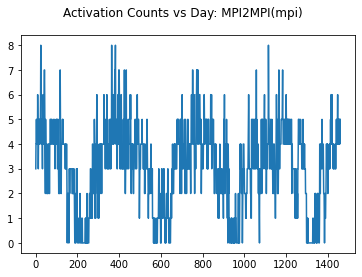

In [28]:
plt.plot(range(len(mpi_counts)), mpi_counts)
plt.suptitle('Activation Counts vs Day: MPI2MPI(mpi)')
plt.show()

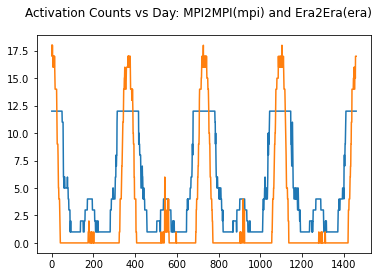

In [441]:
plt.plot(range(len(mpi_counts)), mpi_counts, era_counts)
plt.suptitle('Activation Counts vs Day: MPI2MPI(mpi) and Era2Era(era)')
plt.show()

In [435]:
A5.max()

tensor(0.9985, grad_fn=<MaxBackward1>)

In [437]:
np.where(A5 > .5)

(array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]),
 array([ 318,  318,  318,  318,  318,  318,  318,  318,  318, 1227, 1227,
        1227, 1227, 1227, 1227, 1227, 1467]),
 array([0, 0, 0, 1, 1, 1, 2, 2, 2, 1, 2, 2, 2, 3, 3, 3, 1]),
 array([0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 0, 1, 2, 0, 1, 2, 0]))

In [424]:
A5.shape

torch.Size([1, 2048, 4, 4])

In [427]:
A5[A5 > .005]

tensor([0.0062, 0.0066, 0.0063, 0.0075, 0.0067, 0.0075, 0.0079, 0.0096, 0.0113,
        0.0144, 0.0147, 0.0431], grad_fn=<IndexBackward0>)

#### Look at individual day vs. approximation

In [563]:
input_img.shape

torch.Size([1, 15, 128, 128])

In [206]:
samples.shape

torch.Size([9862, 15, 128, 128])

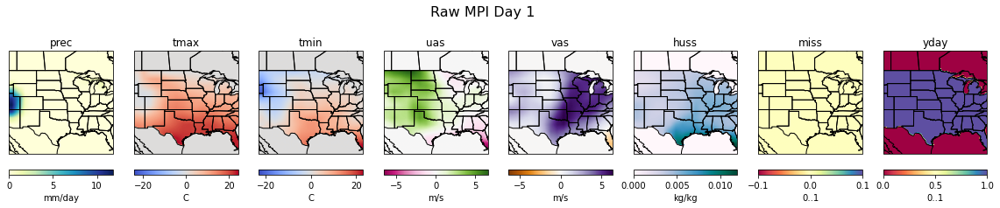

In [256]:
ii=0
input_img = np.array(samples_mpi[ii:ii+1])
input_img = input_img * (minmaxi_mpi[:,1]-minmaxi_mpi[:,0])[np.newaxis,:,np.newaxis,np.newaxis] + minmaxi_mpi[:,0][np.newaxis,:,np.newaxis,np.newaxis]
input_img = input_img * np.array(1-samples_era[0:1,14:15,:,:])
input_img = input_img[0]

vmin = [input_img[ii].min() for ii in range(16)]
vmax = [input_img[ii].max() for ii in range(16)]
#plot_8v_abs(input_img, 'Raw MPI Day '+str(ii+1), vmin[0:0+8], vmax[0:0+8])
plot_8v_abs_surf(input_img, 'Raw MPI Day '+str(ii+1), vmin, vmax, cc=False)


In [69]:
ii=0
input_img = np.array(samples[ii:ii+1])
input_img = input_img * (minmaxi_mpi[:,1]-minmaxi_mpi[:,0])[np.newaxis,:,np.newaxis,np.newaxis] + minmaxi_mpi[:,0][np.newaxis,:,np.newaxis,np.newaxis]
input_img = input_img[0]

vmin = [input_img[ii].min() for ii in range(16)]
vmax = [input_img[ii].max() for ii in range(16)]
plot_8v_abs(input_img, 'Raw MPI Day '+str(ii+1), vmin[0:0+8], vmax[0:0+8])


NameError: name 'minmaxi_mpi' is not defined

In [103]:
A5.shape

torch.Size([1, 2048, 4, 4])

In [ ]:
0 0.0 6 (array([0, 0, 0, 0, 0, 0]), array([ 82, 175, 175, 175, 496, 925]), array([3, 3, 3, 3, 3, 0]), array([0, 0, 1, 2, 2, 2]))
tensor([0.9991, 0.9999, 0.9991, 0.9995, 0.9990, 0.9995],
       grad_fn=<IndexBackward0>)

In [144]:
ii = 0

In [ ]:
1881, 1949, 2030, 2045
69,   81,   92,  138,  295,  382,  384,  482,  830,  831,  857,

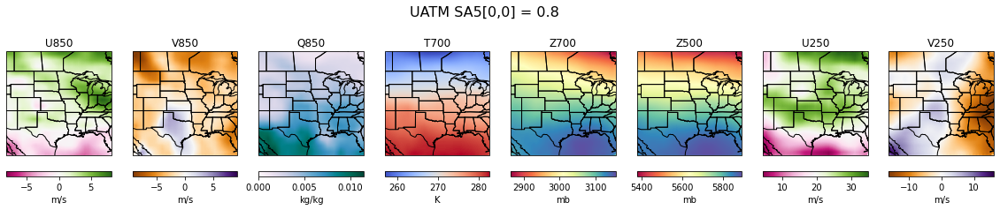

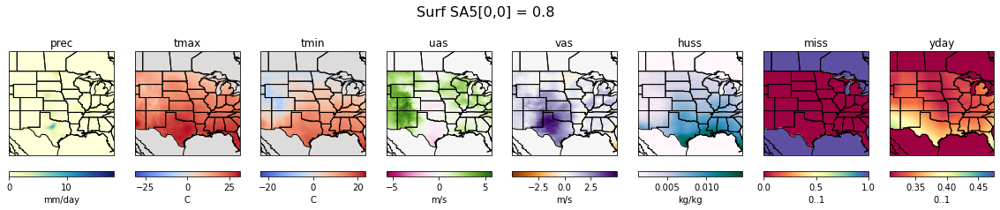

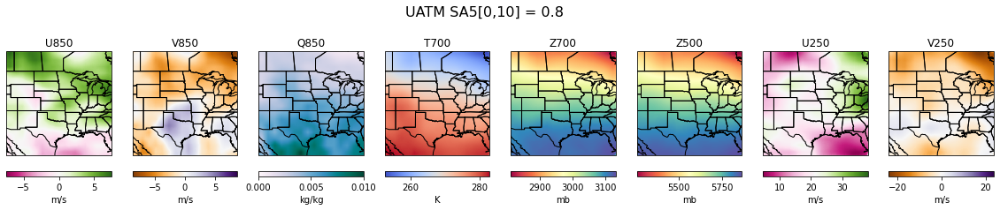

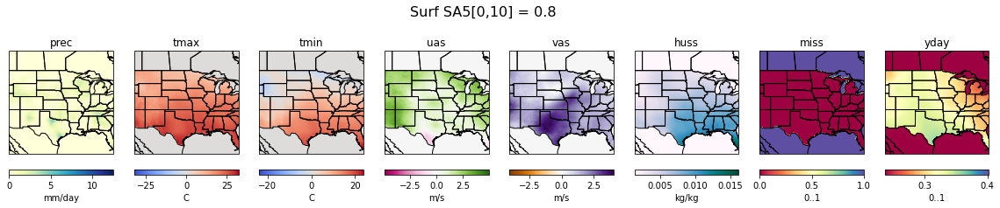

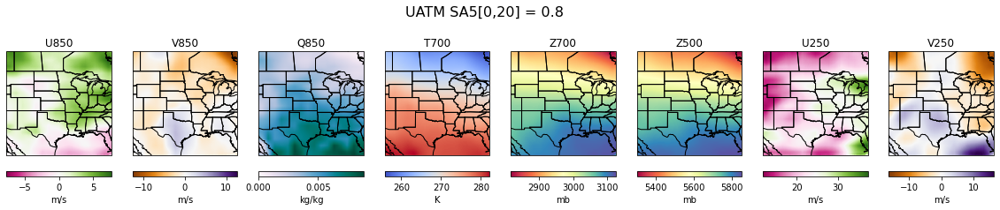

...

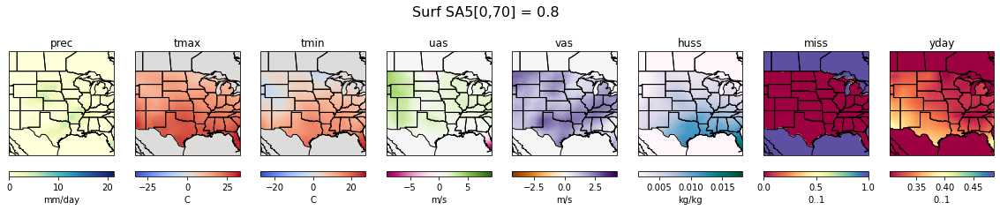

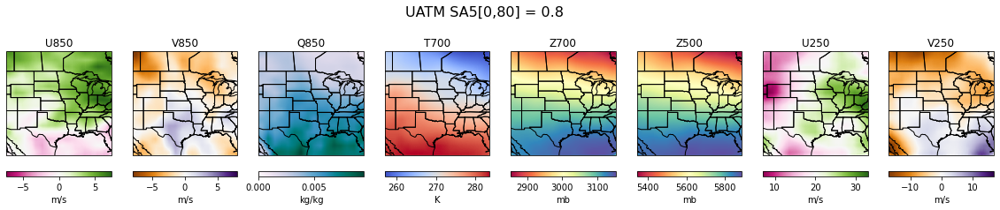

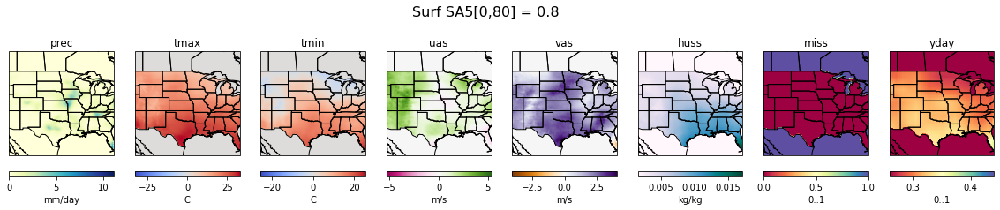

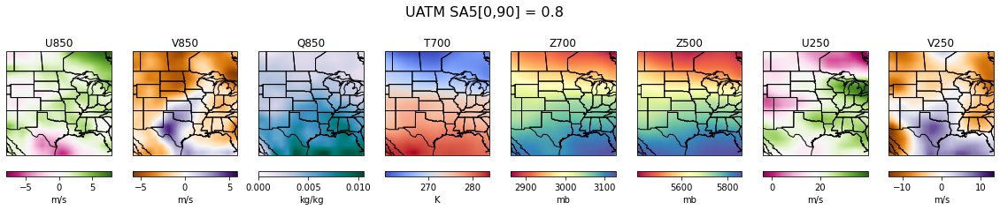

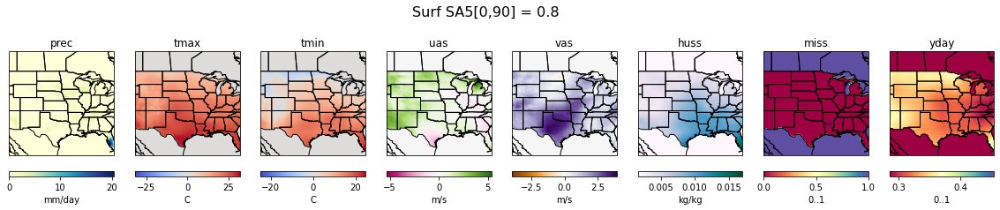

In [142]:
# vgg16 decoder
for ii in range(0,100,10):
    SA5 = torch.zeros((1, 1000))
    SA5[0,ii] = 0.8

    generated_img = np.array(vgg_decoder(SA5).detach())
    generated_img = generated_img * (minmaxi_era[:,1]-minmaxi_era[:,0])[np.newaxis,:,np.newaxis,np.newaxis] + minmaxi_era[:,0][np.newaxis,:,np.newaxis,np.newaxis]


    generated_img = generated_img[0]
    vmin = [generated_img[ii].min() for ii in range(16)]
    vmax = [generated_img[ii].max() for ii in range(16)]
    plot_8v_abs(generated_img, 'UATM SA5[0,%s] = 0.8' % (ii), vmin[0:0+8], vmax[0:0+8], cc=False)
    plot_8v_abs_surf(generated_img, 'Surf SA5[0,%s] = 0.8' % (ii), vmin, vmax, cc=False)
    print()


/glade/u/home/dkorytin/miniconda3/envs/na-cordex-zarr-jnb/lib/python3.7/site-packages/torch/nn/functional.py:1806: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


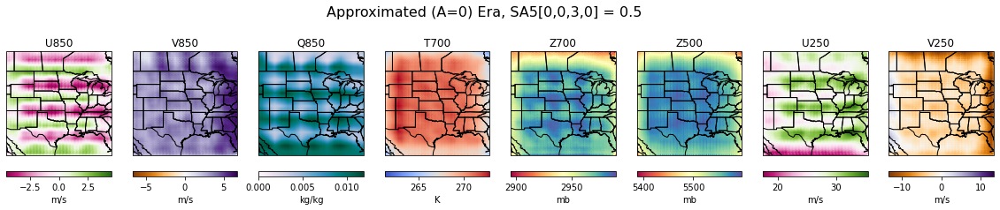

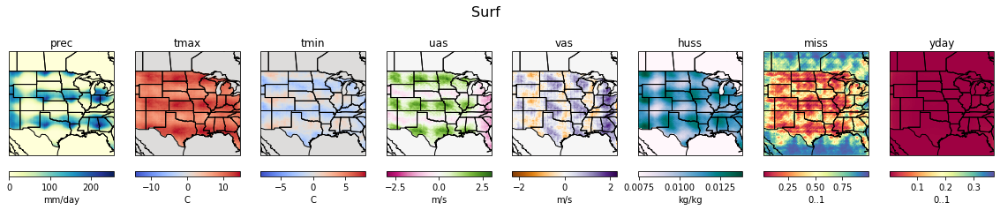

In [143]:
# construct synthetic bottleneck activation
SA5 = torch.zeros((1, 16, 4, 4))

for ii in range(4):
    for jj in range(4):
        SA5[0,15,ii,jj] = 0.8
        # SA5[0,1,3,0] = 0.8
        # SA5[0,2,3,1] = 0.8
        # SA5[0,3,3,2] = 0.8
        # SA5[0,4,3,2] = 0.8
        # SA5[0,5,0,2] = 0.8


# generated_img = np.array(mpi2mpi_decoder(SA5).detach())
# generated_img = generated_img * (minmaxi_mpi[:,1]-minmaxi_mpi[:,0])[np.newaxis,:,np.newaxis,np.newaxis] + minmaxi_mpi[:,0][np.newaxis,:,np.newaxis,np.newaxis]

generated_img = np.array(general_encoder.forward2(SA5).detach())
generated_img = generated_img * (minmaxi_era[:,1]-minmaxi_era[:,0])[np.newaxis,:,np.newaxis,np.newaxis] + minmaxi_era[:,0][np.newaxis,:,np.newaxis,np.newaxis]


generated_img = generated_img[0]
vmin = [generated_img[ii].min() for ii in range(16)]
vmax = [generated_img[ii].max() for ii in range(16)]
plot_8v_abs(generated_img, 'Approximated (A=0) Era, SA5[0,0,3,0] = 0.5', vmin[0:0+8], vmax[0:0+8], cc=False)
plot_8v_abs_surf(generated_img, 'Surf', vmin, vmax, cc=False)


In [173]:
list(mpi2mpi_encoder.conv55.parameters())[2].shape

torch.Size([2048, 1024, 4, 4])

In [185]:
mpi2mpi_encoder.conv55[1].weight.shape

torch.Size([2048, 1024, 4, 4])

In [189]:
#F.conv_transpose2d(h, weight=self.encoder[0].weight.transpose(0, 1), bias=self.bias[0], stride=2, padding=1)
l1 = F.conv_transpose2d(SA5, weight=mpi2mpi_encoder.conv55[1].weight.transpose(2,3), bias=None, stride=2,padding=1)
l1.shape
    

torch.Size([1, 1024, 8, 8])

#### Backprop experiements

In [252]:
mse = nn.MSELoss()

In [119]:
mpi2mpi_encoder._modules['conv11'].zero_grad()
mpi2mpi_encoder._modules['conv22'].zero_grad()

In [120]:
# Freeze layer2
for param in mpi2mpi_encoder.conv22.parameters():
    param.requires_grad = False

In [123]:
ii = 0
input_img = samples[ii:ii+mb]

A0 = torch.tensor(input_img, requires_grad = False)
A1 = mpi2mpi_encoder._modules['conv11'].forward(A0)
A2 = mpi2mpi_encoder._modules['conv22'].forward(A1)
A3 = mpi2mpi_encoder._modules['conv33'].forward(A2)
A4 = mpi2mpi_encoder._modules['conv44'].forward(A3)
A5 = mpi2mpi_encoder._modules['conv55'].forward(A4)

err = mse(A5, torch.tensor(1.0, requires_grad=True))
err.backward()

/glade/scratch/dkorytin/ipykernel_280591/2703554825.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A0 = torch.tensor(input_img, requires_grad = False)


In [128]:
list(mpi2mpi_encoder._modules['conv11'].parameters())[0].grad

tensor([[[[-3.0439e-20, -2.7444e-20, -2.7768e-20, -2.7276e-20],
          [-5.5857e-20, -4.8584e-20, -4.8864e-20, -4.8604e-20],
          [-5.6980e-20, -4.9828e-20, -5.0159e-20, -4.9987e-20],
          [-5.5722e-20, -4.7976e-20, -4.8372e-20, -4.9259e-20]],

         [[-1.6411e-20, -1.3456e-20, -1.3587e-20, -1.3694e-20],
          [-4.0929e-20, -3.4499e-20, -3.4653e-20, -3.5073e-20],
          [-4.0314e-20, -3.3972e-20, -3.4160e-20, -3.4615e-20],
          [-3.8606e-20, -3.1822e-20, -3.2037e-20, -3.3457e-20]],

         [[ 1.7914e-21,  2.2221e-21,  1.3461e-21, -5.5014e-23],
          [-1.0921e-20, -1.0532e-20, -1.1924e-20, -1.3900e-20],
          [-1.0142e-20, -9.8717e-21, -1.1407e-20, -1.3416e-20],
          [-9.1316e-21, -8.8104e-21, -1.0448e-20, -1.2664e-20]],

         ...,

         [[ 2.5475e-21,  2.2087e-21,  2.6412e-21,  2.2292e-21],
          [-1.7629e-20, -1.5692e-20, -1.5776e-20, -1.6861e-20],
          [-1.7191e-20, -1.5428e-20, -1.5661e-20, -1.6826e-20],
          [-1.6331e

In [79]:
A0.grad

In [247]:
A5.shape

torch.Size([1, 2048, 4, 4])

In [79]:
np.array([0,0,0,0,0,0,0]).std(), np.array([1,1,1,1,1,1]).std()

(0.0, 0.0)

In [254]:
AdaIN(A5, A5).shape

torch.Size([1, 2048, 4, 4])

In [255]:
mse(AdaIN(A5, A5), A5)

tensor(3.4636e-17, grad_fn=<MseLossBackward0>)

In [45]:
generated_img = era2mpi_decoder.forward2(general_encoder(AdaIN(input_img, input_img2)))#.data.cpu()
 

/glade/u/home/dkorytin/miniconda3/envs/na-cordex-zarr-jnb/lib/python3.9/site-packages/torch/nn/functional.py:1806: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


In [81]:
input_img - AdaIN(input_img, input_img2)

tensor([[[[-0.0393, -0.0393, -0.0393,  ..., -0.0388, -0.0388, -0.0388],
          [-0.0393, -0.0393, -0.0393,  ..., -0.0388, -0.0388, -0.0388],
          [-0.0393, -0.0393, -0.0393,  ..., -0.0388, -0.0388, -0.0388],
          ...,
          [-0.0342, -0.0342, -0.0342,  ..., -0.0233, -0.0233, -0.0233],
          [-0.0342, -0.0342, -0.0342,  ..., -0.0233, -0.0233, -0.0233],
          [-0.0342, -0.0342, -0.0342,  ..., -0.0233, -0.0233, -0.0233]],

         [[-0.0068, -0.0068, -0.0068,  ..., -0.0520, -0.0520, -0.0520],
          [-0.0068, -0.0068, -0.0068,  ..., -0.0520, -0.0520, -0.0520],
          [-0.0068, -0.0068, -0.0068,  ..., -0.0520, -0.0520, -0.0520],
          ...,
          [-0.1409, -0.1409, -0.1409,  ...,  0.1522,  0.1522,  0.1522],
          [-0.1409, -0.1409, -0.1409,  ...,  0.1522,  0.1522,  0.1522],
          [-0.1409, -0.1409, -0.1409,  ...,  0.1522,  0.1522,  0.1522]],

         [[ 0.0628,  0.0628,  0.0628,  ...,  0.0242,  0.0242,  0.0242],
          [ 0.0628,  0.0628,  

0


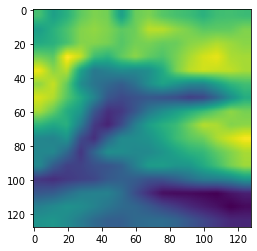

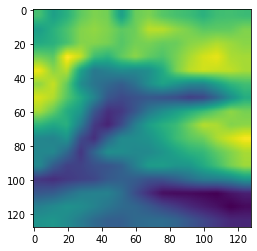

1


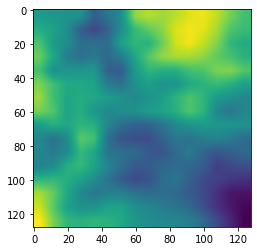

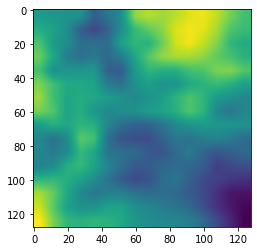

2


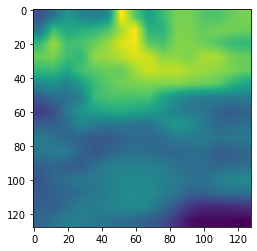

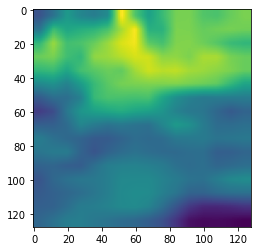

3


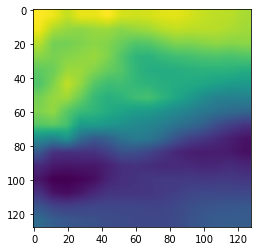

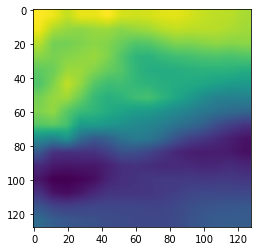

4


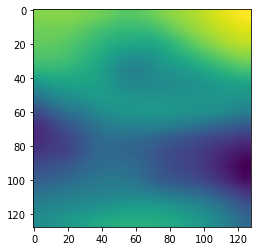

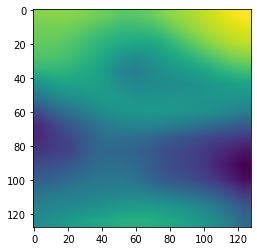

5


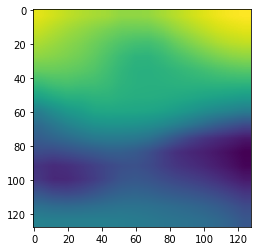

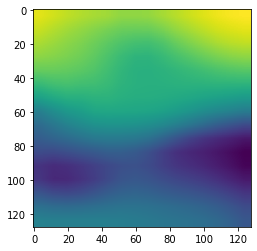

6


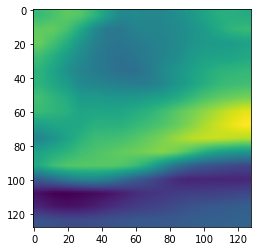

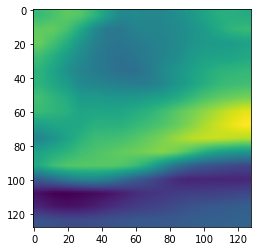

7


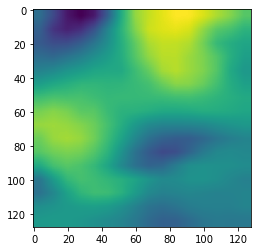

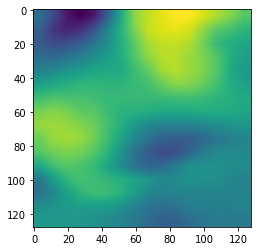

8


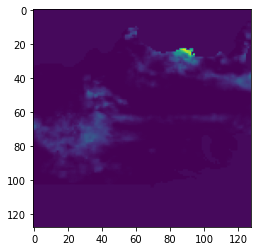

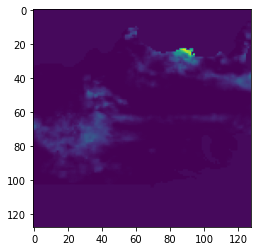

9


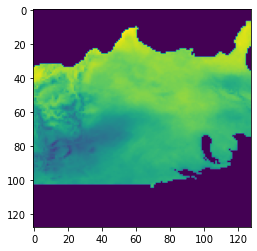

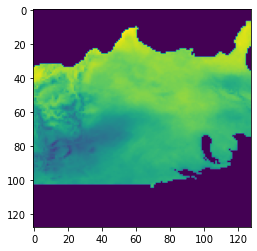

10


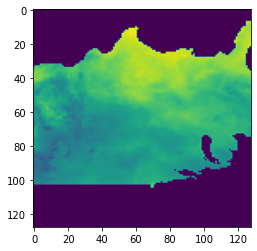

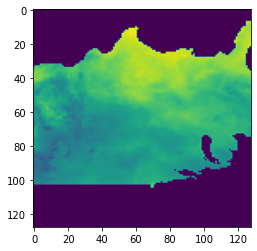

11


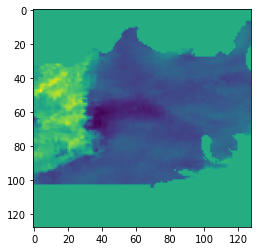

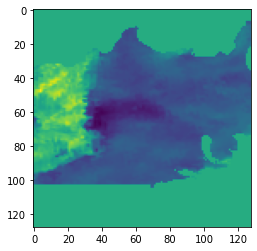

12


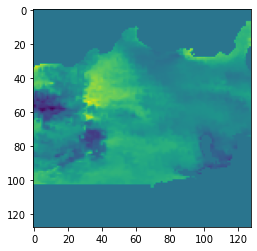

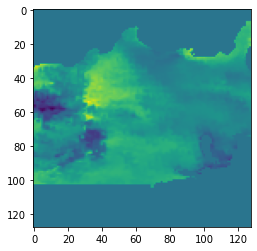

13


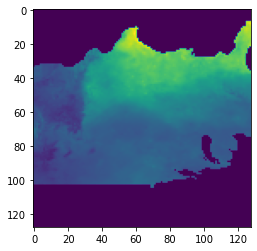

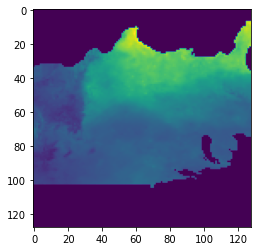

14


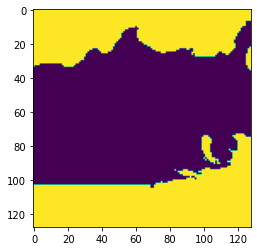

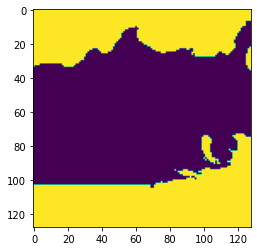

15


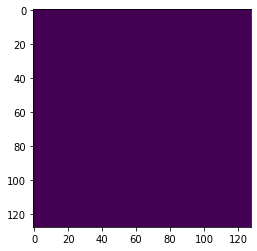

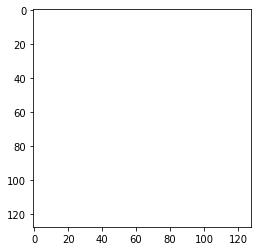

In [75]:
for ii in range(16):
    print(ii)
    plt.imshow(input_img[0][ii])
    plt.show()    
    plt.imshow(AdaIN(input_img, input_img2)[0][ii])
    plt.show()

In [298]:
x = np.zeros((10,5,2))

In [328]:
np.array([[2,100],[1,200],[3,300],[4,400],[5,500]]).tolist()

[[2, 100], [1, 200], [3, 300], [4, 400], [5, 500]]

In [325]:
sorted([[2,100],[1,200],[3,300],[4,400],[5,500]], reverse=True)

[[5, 500], [4, 400], [3, 300], [2, 100], [1, 200]]

In [308]:
x[9,:,:] = sorted([[1,100],[2,200],[3,300],[4,400],[5,500]], reverse=True)

In [304]:
[1,2,3][1:-1]

[2]

In [234]:
x[9,1:None,:] = x[9,0:-1,:]

In [235]:
y = list(x[9,:])
y

[array([  1., 100.]),
 array([  1., 100.]),
 array([  2., 200.]),
 array([  3., 300.]),
 array([  4., 400.])]

In [228]:
x[9,:,0].min()

1.0

In [202]:
y[:] = [[1,100],[2,200]]

In [203]:
y


[[1, 100], [2, 200]]

### SSIM: match MPI to closest Era

In [39]:
ss = np.load('/glade/scratch/dkorytin/ssim_closest_mpi2era.npy')

In [ ]:
ss2 = np.load('/glade/scratch/dkorytin/ssim_closest_mpi2era.npy')

In [38]:
#np.save('/glade/scratch/dkorytin/ssim_closest_mpi2era_bak.npy', ss)

In [40]:
ss.shape

(20454, 5, 2)

In [41]:
np.where(ss==0)

(array([], dtype=int64), array([], dtype=int64), array([], dtype=int64))

In [35]:
ss[0,:,:] = np.zeros((5,2))
                     

In [341]:
ss[0,:,:].shape

(5, 2)

In [353]:
sorted(ss[0,:,0].tolist()) 

[0.0, 0.0, 0.0, 0.0, 0.0]

In [38]:
sss = np.array([sorted(ss[ii,:,:].tolist(),reverse=True) for ii in range(len(ss))])

In [39]:
sss.shape

(20454, 5, 2)

In [345]:
sss[2]

array([[8.80994618e-01, 5.84500000e+03],
       [8.79074156e-01, 5.51000000e+03],
       [8.77080858e-01, 6.26800000e+03],
       [8.73486340e-01, 8.80300000e+03],
       [8.71814609e-01, 6.25100000e+03]])

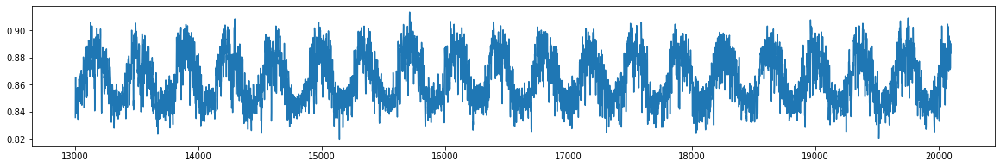

In [44]:
plt.rcParams["figure.figsize"] = (20,3)
plt.plot(range(13000,20100), sss[13000:20100,4,0])

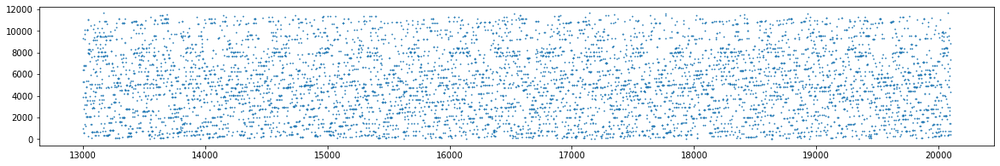

In [68]:
plt.scatter(range(13000,20100), sss[13000:20100,0,1], s=.6)


In [246]:
[1,2,3][-1]


3

In [ ]:
# example day
ii = 0


In [46]:
sss[10592][0]

array([8.90662611e-01, 9.49300000e+03])

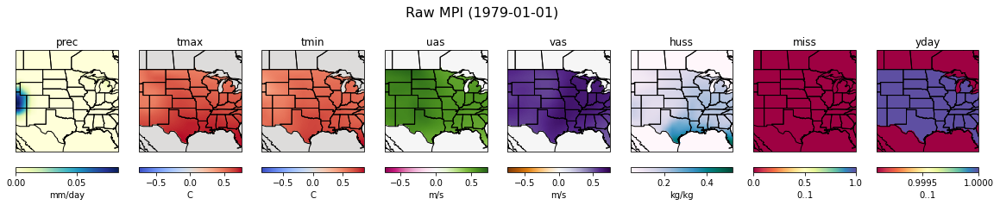

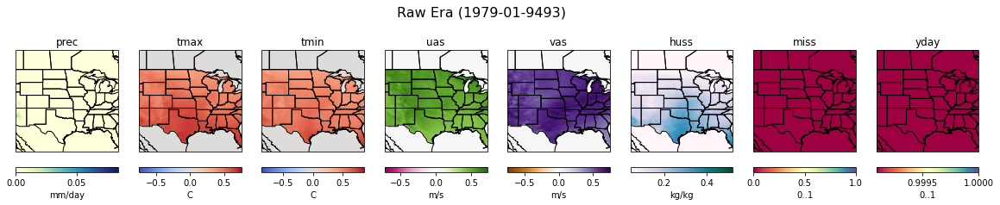

In [53]:
input_mpi = samples_mpi[0]
input_era = samples_era[9493]
vmin = [min(input_mpi[ii].min(),input_era[ii].min()) for ii in range(16)]
vmax = [max(input_mpi[ii].max(),input_era[ii].max()) for ii in range(16)]

plot_8v_abs_surf(np.array(input_mpi), 'Raw MPI (1979-01-01)', vmin, vmax, cc=False)
plot_8v_abs_surf(np.array(input_era), 'Raw Era (1979-01-9493)', vmin, vmax, cc=False)


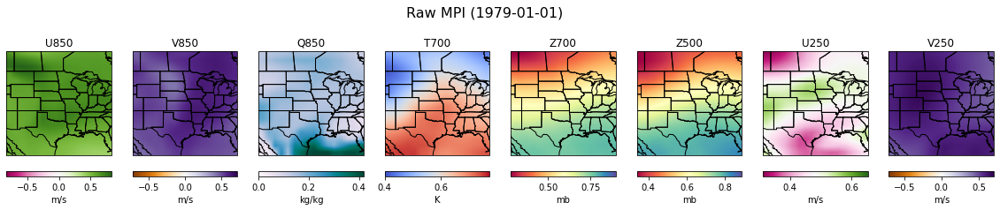

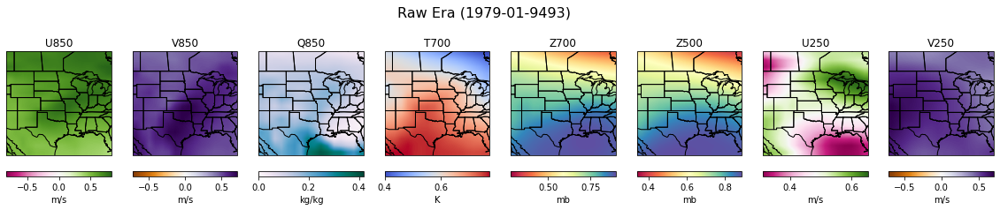

In [54]:
plot_8v_abs(np.array(input_mpi), 'Raw MPI (1979-01-01)', vmin, vmax, cc=False)
plot_8v_abs(np.array(input_era), 'Raw Era (1979-01-9493)', vmin, vmax, cc=False)


### VGG16

In [354]:
import torchvision.models as models

ModuleNotFoundError: No module named 'torchvision'

In [70]:
x = torch.randn(1, 16, 128, 128)

In [357]:
128*2 - 228


28

In [74]:
(x**2).shape

torch.Size([1, 16, 128, 128])

In [ ]:
F.conv_transpose2d(x, weight=mpi2mpi_encoder.conv55[1].weight.transpose(2,3), bias=None, stride=2,padding=1).shape

### Moran I

In [63]:
import pysal as ps


In [64]:
input_mpi.shape

torch.Size([16, 128, 128])

In [65]:
w=ps.weights.Rook.from_dataframe(input_mpi[0])

AttributeError: module 'pysal' has no attribute 'weights'

In [57]:
import geopandas as gps
import pysal as ps
# urban_data=gpd.read_file(gdf_file_path)
# w=ps.weights.Rook.from_dataframe(urban_data)
# mi=ps.Moran(urban_data.Attribute_1, w)
print(mi.I)
print(mi.EI)
print(mi.p_sim)

NameError: name 'mi' is not defined

In [69]:
x

NameError: name 'x' is not defined

In [75]:
import pysal

/glade/u/home/dkorytin/miniconda3/envs/na-cordex-zarr-jnb/lib/python3.7/site-packages/pysal/model/spvcm/abstracts.py:10: UserWarning: The `dill` module is required to use the sqlite backend fully.
  from .sqlite import head_to_sql, start_sql


In [78]:
w=pysal.lib.weights.lat2W(4,4)

In [90]:
list(w)


[(0, {4: 1.0, 1: 1.0}),
 (1, {0: 1.0, 5: 1.0, 2: 1.0}),
 (2, {1: 1.0, 6: 1.0, 3: 1.0}),
 (3, {2: 1.0, 7: 1.0}),
 (4, {0: 1.0, 8: 1.0, 5: 1.0}),
 (5, {1: 1.0, 4: 1.0, 9: 1.0, 6: 1.0}),
 (6, {2: 1.0, 5: 1.0, 10: 1.0, 7: 1.0}),
 (7, {3: 1.0, 6: 1.0, 11: 1.0}),
 (8, {4: 1.0, 12: 1.0, 9: 1.0}),
 (9, {5: 1.0, 8: 1.0, 13: 1.0, 10: 1.0}),
 (10, {6: 1.0, 9: 1.0, 14: 1.0, 11: 1.0}),
 (11, {7: 1.0, 10: 1.0, 15: 1.0}),
 (12, {8: 1.0, 13: 1.0}),
 (13, {9: 1.0, 12: 1.0, 14: 1.0}),
 (14, {10: 1.0, 13: 1.0, 15: 1.0}),
 (15, {11: 1.0, 14: 1.0})]

In [81]:
mi = pysal.Moran(w, w, two_tailed=False)

AttributeError: module 'pysal' has no attribute 'Moran'

In [93]:
dir(pysal.lib)

['__builtins__',
 '__cached__',
 '__doc__',
 '__file__',
 '__loader__',
 '__name__',
 '__package__',
 '__path__',
 '__spec__',
 '__version__',
 'cg',
 'common',
 'examples',
 'io',
 'weights']